In [1]:
import numpy as np
import pandas
from matplotlib import pyplot as plt
import matplotlib.ticker as mticker
import os
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.util as cutil
import xarray
import cmocean
import cartopy.util as cutil
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import matplotlib.dates as mdates
from collections import OrderedDict
import scipy.signal as scipy_signal
import re as regex
from scipy import signal as scipy_signal
import colorcet
import matplotlib.gridspec as gridspec

import marineHeatWaves as mhw
import proplot


/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/_collections_abc.py:841: MatplotlibDeprecationWarning: 
The examples.directory rcparam was deprecated in Matplotlib 3.0 and will be removed in 3.2. In the future, examples will be found relative to the 'datapath' directory.
  self[key] = other[key]


In [2]:
def correlation_lags(in1_len, in2_len, mode='full'):
    r"""
    Calculates the lag / displacement indices array for 1D cross-correlation.


    Parameters
    ----------
    in1_len : int
        First input size.
    in2_len : int
        Second input size.
    mode : str {'full', 'valid', 'same'}, optional
        A string indicating the size of the output.
        See the documentation `correlate` for more information.


    Returns
    -------
    lags : array
        Returns an array containing cross-correlation lag/displacement indices.
        Indices can be indexed with the np.argmax of the correlation to return
        the lag/displacement.


    See Also
    --------
    correlate : Compute the N-dimensional cross-correlation.


    Notes
    -----
    Cross-correlation for continuous functions :math:`f` and :math:`g` is
    defined as:


    .. math::


        \left ( f\star g \right )\left ( \tau \right )
        \triangleq \int_{t_0}^{t_0 +T}
        \overline{f\left ( t \right )}g\left ( t+\tau \right )dt


    Where :math:`\tau` is defined as the displacement, also known as the lag.


    Cross correlation for discrete functions :math:`f` and :math:`g` is
    defined as:


    .. math::
        \left ( f\star g \right )\left [ n \right ]
        \triangleq \sum_{-\infty}^{\infty}
        \overline{f\left [ m \right ]}g\left [ m+n \right ]


    Where :math:`n` is the lag.


    Examples
    --------
    Cross-correlation of a signal with its time-delayed self.


    >>> import numpy as np
    >>> from scipy import signal
    >>> rng = np.random.default_rng()
    >>> x = rng.standard_normal(1000)
    >>> y = np.concatenate([rng.standard_normal(100), x])
    >>> correlation = signal.correlate(x, y, mode="full")
    >>> lags = signal.correlation_lags(x.size, y.size, mode="full")
    >>> lag = lags[np.argmax(correlation)]
    """


    # calculate lag ranges in different modes of operation
    if mode == "full":
        # the output is the full discrete linear convolution
        # of the inputs. (Default)
        lags = np.arange(-in2_len + 1, in1_len)
    elif mode == "same":
        # the output is the same size as `in1`, centered
        # with respect to the 'full' output.
        # calculate the full output
        lags = np.arange(-in2_len + 1, in1_len)
        # determine the midpoint in the full output
        mid = lags.size // 2
        # determine lag_bound to be used with respect
        # to the midpoint
        lag_bound = in1_len // 2
        # calculate lag ranges for even and odd scenarios
        if in1_len % 2 == 0:
            lags = lags[(mid-lag_bound):(mid+lag_bound)]
        else:
            lags = lags[(mid-lag_bound):(mid+lag_bound)+1]
    elif mode == "valid":
        # the output consists only of those elements that do not
        # rely on the zero-padding. In 'valid' mode, either `in1` or `in2`
        # must be at least as large as the other in every dimension.


        # the lag_bound will be either negative or positive
        # this let's us infer how to present the lag range
        lag_bound = in1_len - in2_len
        if lag_bound >= 0:
            lags = np.arange(lag_bound + 1)
        else:
            lags = np.arange(lag_bound, 1)
    return lags

In [3]:
#Load the cartopy land and geopolotical boundary data for plotting

WEST_LON_BDY = 140
EAST_LON_BDY = 180
NORTH_LAT_BDY = -20
SOUTH_LAT_BDY = -45

mooring_longitudes = [153.8996,  153.999, 154.1301,154.2972,154.6487, 155.2968]
mooring_latitudes  = [-27.3261, -27.3129, -27.2841,-27.2397,-27.2064, -27.1009]
METERS_TO_CENTIMETERS = 100
KELVIN_TO_CELSIUS = -273.15


brisbane_lat = -27.470125
brisbane_lon = 153.021072
sydney_lat   = -33.865143
sydney_lon   = 151.209900
coffs_lat   = -30.296276
coffs_lon   = 153.114136

figure_output_path = 'Figures_Update'


In [4]:
SST_data_source = 'OISST'

start_date =  '1993-01-01'
end_date   =  '2022-12-31'
SST_base_file_path       = '/oa-decadal-climate/work/observations/sst/oisst/AVHRR-only'
    
SST_dataset = xarray.open_dataset(os.path.join(SST_base_file_path, 'reynolds.oi_v02r01.sst.sfc.19820101-20240630.nc'),decode_times=True,use_cftime=False,
                                     mask_and_scale=True).sel(lon=slice(WEST_LON_BDY,EAST_LON_BDY),lat=slice(SOUTH_LAT_BDY,NORTH_LAT_BDY),time=slice(start_date,end_date))
SST_dataset  = SST_dataset.rename({'sst':'sea_surface_temperature'})
SST_dataset['time'] = SST_dataset['time'].dt.floor('D')
SST = SST_dataset['sea_surface_temperature']
    
    
SST_anom_dataset = xarray.open_dataset(os.path.join(SST_base_file_path, 'reynolds.oi_v02r01.sst.sfc.19820101-20240630.anom.detrend.nc'),decode_times=True,use_cftime=False,
                                     mask_and_scale=True).sel(lon=slice(WEST_LON_BDY,EAST_LON_BDY),lat=slice(SOUTH_LAT_BDY,NORTH_LAT_BDY),time=slice(start_date,end_date))
SST_anom_dataset  = SST_anom_dataset.rename({'sst':'sea_surface_temperature'})
    
SST_anom_dataset['time'] = SST_anom_dataset['time'].dt.floor('D')
    
#SST_anom = SST_anom_dataset['anom']

In [5]:
altimetry_base_file_path = '/home/observations/rs/altimetry/gridded/GSLA/DM01/yearfiles'


altimetry_file_list = []
altimetry_dir_contents = os.listdir(altimetry_base_file_path)
altimetry_dir_contents.sort()

for i_file in altimetry_dir_contents:
    altimetry_file_list.append(os.path.join(altimetry_base_file_path,i_file))


altimetry_dataset = xarray.open_mfdataset(altimetry_file_list,decode_times=True,use_cftime=False,mask_and_scale=True,data_vars=['GSLA','UCUR','VCUR'],
                                          parallel=True).sel(LONGITUDE=slice(WEST_LON_BDY,EAST_LON_BDY),LATITUDE=slice(SOUTH_LAT_BDY,NORTH_LAT_BDY)) #,TIME=slice(start_date,end_date))

land_mask = altimetry_dataset['GSLA'][0,:,:].where(altimetry_dataset['GSLA'][0,:,:]==0.0)

GSLA      = altimetry_dataset['GSLA'].where(land_mask)
GSL       = altimetry_dataset['GSL'].where(land_mask)

u_current = altimetry_dataset['UCUR'].where(land_mask)
v_current = altimetry_dataset['VCUR'].where(land_mask)

In [6]:
GSLA_clim = GSLA.groupby('TIME.dayofyear').mean('TIME').compute()
GSLA_anom = GSLA.groupby('TIME.dayofyear') -GSLA_clim

u_current_clim = u_current.groupby('TIME.dayofyear').mean('TIME').compute()
u_current_anom = u_current.groupby('TIME.dayofyear') -u_current_clim

v_current_clim = v_current.groupby('TIME.dayofyear').mean('TIME').compute()
v_current_anom = v_current.groupby('TIME.dayofyear') -v_current_clim

/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)
/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)
/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/dask/array/numpy_compat.py:40: RuntimeWarning: invalid value encountered in true_divide
  x = np.divide(x1, x2, out)


In [19]:
SST

<xarray.DataArray 'sea_surface_temperature' (time: 10957, zlev: 1, lat: 100, lon: 160)>
[175312000 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 1993-01-01 1993-01-02 ... 2022-12-31
  * lon      (lon) float32 140.1 140.4 140.6 140.9 ... 179.1 179.4 179.6 179.9
  * lat      (lat) float32 -44.88 -44.62 -44.38 -44.12 ... -20.62 -20.38 -20.12
  * zlev     (zlev) float32 0.0
Attributes:
    long_name:  Daily sea surface temperature
    units:      Celsius

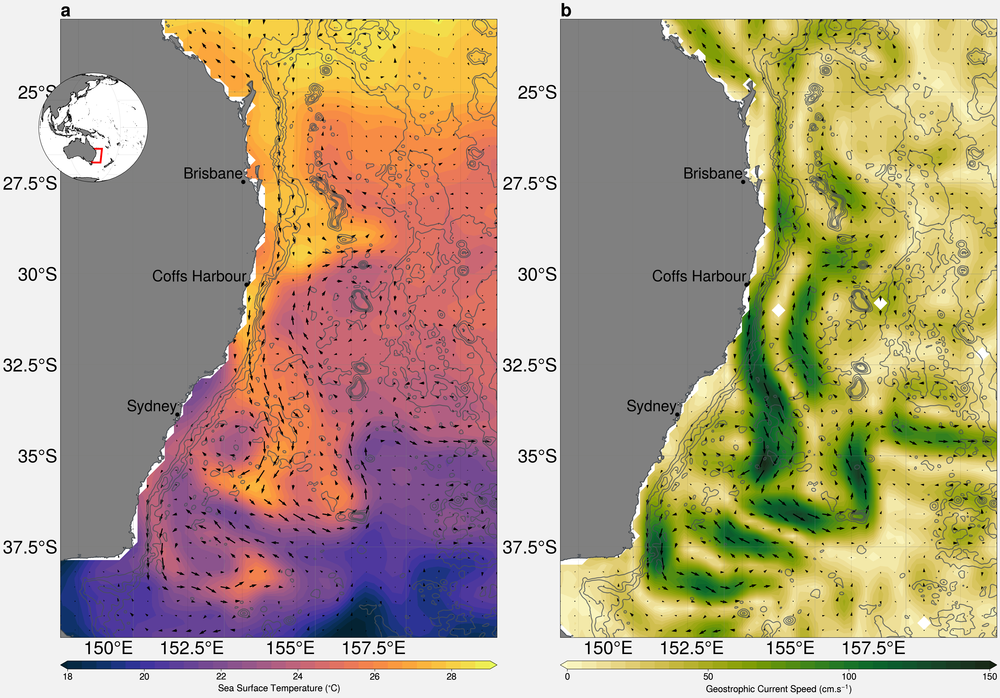

In [45]:
import string
import proplot
from mpl_toolkits.axes_grid1.inset_locator import inset_axes,mark_inset
import cartopy
import matplotlib.patches as mpatches


proplot.rc['land.color'] = 'grey'
proplot.rc['text.labelsize'] = 15
proplot.rc['text.titlesize'] = 25
proplot.rc['abc.size'] = 30
proplot.rc['abc.style'] = 'a'
proplot.rc['reso'] = 'hi'
proj = proplot.Proj('cyl', basemap=False)


min_temperature = 16
max_temperature = 23
delta_temperature = 2.0


min_salinity = 35.3
max_salinity = 35.9
delta_salinity = 0.2

max_speed = 1.
min_speed = -1.
delta_speed = 0.5
label_counter = 0




brisbane_lat = -27.470125
brisbane_lon = 153.021072
sydney_lat   = -33.865143
sydney_lon   = 151.209900
coffs_lat   = -30.296276
coffs_lon   = 153.114136
city_font_size =25

lon_min = 148
lon_max = 160
lat_min=-40
lat_max=-23


date_to_plot = np.datetime64('2020-03-12')

u_current_to_plot = u_current.sel(TIME=date_to_plot)
v_current_to_plot = v_current.sel(TIME=date_to_plot)

SST_to_plot = SST.sel(time=date_to_plot).squeeze()

speed = np.sqrt(u_current_to_plot*u_current_to_plot + v_current_to_plot*v_current_to_plot)

image_layout = [[1,1],[1,1]]

fig, axs = proplot.subplots(nrows=1, ncols=2,  axwidth=10,proj='cyl' )

#axs[0].streamplot(v_current_clim['LONGITUDE'].values, u_current['LATITUDE'].values, 
#                  u_current_to_plot.values, v_current_to_plot.values,color='k',density=30.0)


cs_SST = axs[0,0].contourf(SST_to_plot['lon'],SST_to_plot['lat'],SST_to_plot.squeeze().values,levels=np.linspace(18,29,30),cmap='Thermal',extend='both')
axs[0,0].contour(bathymetry_dataset['x'],bathymetry_dataset['y'],-bathymetry_dataset['z'],levels=np.arange(0,5001,1000),colors='gray7',alpha=0.8)

skip_step = 2
skip = dict(LONGITUDE=slice(None,None,skip_step),LATITUDE=slice(None,None,skip_step))
quiver_out = axs[0,0].quiver(u_current_to_plot['LONGITUDE'][::skip_step].values,u_current_to_plot['LATITUDE'][::skip_step].values,u_current_to_plot[skip].values,v_current_to_plot[skip].values,scale=40)
qk = axs[0,0].quiverkey(quiver_out, 0.8, 1.04, 1, r'1m.s$^{-1}$', labelpos='E',
                   coordinates='axes',fontproperties={'size':20})


axs[0,0].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=False)
axs[0,0].format(land=True,coast=True,facecolor='white',abc=True) #lonlines=np.arange(145,181,5),latlines=np.arange(-45,-10,5)) #, color='grey')






skip_step = 2
skip = dict(LONGITUDE=slice(None,None,skip_step),LATITUDE=slice(None,None,skip_step))

cs_speed = axs[0,1].contourf(u_current_to_plot['LONGITUDE'],u_current_to_plot['LATITUDE'],100.0*speed,levels=100.0*np.linspace(0,1.5,30),cmap='Speed',extend='both')
axs[0,1].contour(bathymetry_dataset['x'],bathymetry_dataset['y'],-bathymetry_dataset['z'],levels=np.arange(0,5001,1000),colors='gray7',alpha=0.8)

quiver_out = axs[0,1].quiver(u_current_to_plot['LONGITUDE'][::skip_step],u_current_to_plot['LATITUDE'][::skip_step],u_current_to_plot[skip],v_current_to_plot[skip],scale=40)
#if i_event ==0:





axs[0,1].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=False)
axs[0,1].format(land=True,coast=True,facecolor='white',abc=True) #lonlines=np.arange(145,181,5),latlines=np.arange(-45,-10,5)) #, color='grey')

transform = ccrs.PlateCarree()._as_mpl_transform(axs[0])
axs[0].plot(brisbane_lon,brisbane_lat,'o',color='k')
axs[0].plot(sydney_lon,sydney_lat,'o',color='k')
axs[0].plot(coffs_lon,coffs_lat,'o',color='k')
    
axs[0].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
axs[0].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
axs[0].annotate('Coffs Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)



gl = axs[0].gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                  linewidth=0.5, color='gray', alpha=0.5, linestyle='-')
gl.xlabels_top = False
gl.ylabels_left = True
gl.ylabels_right = False

gl.xlocator = mticker.FixedLocator(np.arange(140, 170,2.5))
gl.ylocator = mticker.FixedLocator(np.arange(-40,0,2.5))
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 30, 'color': 'k', 'ha':'right'}
gl.ylabel_style = {'size':30, 'color': 'k', 'weight': 'normal'}

ix = axs[0].inset([-0.05, 0.70, 0.25, 0.25], transform='axes', zoom=False,proj=proplot.Proj('ortho',lon_0=150))



transform = ccrs.PlateCarree()._as_mpl_transform(axs[1])
axs[1].plot(brisbane_lon,brisbane_lat,'o',color='k')
axs[1].plot(sydney_lon,sydney_lat,'o',color='k')
axs[1].plot(coffs_lon,coffs_lat,'o',color='k')
    
axs[1].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
axs[1].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
axs[1].annotate('Coffs Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)



gl = axs[1].gridlines(crs=ccrs.PlateCarree(), draw_labels=True,
                  linewidth=0.5, color='gray', alpha=0.5, linestyle='-')
gl.xlabels_top = False
gl.ylabels_left = True
gl.ylabels_right = False

gl.xlocator = mticker.FixedLocator(np.arange(140, 170,2.5))
gl.ylocator = mticker.FixedLocator(np.arange(-40,0,2.5))
gl.xformatter = LONGITUDE_FORMATTER
gl.yformatter = LATITUDE_FORMATTER
gl.xlabel_style = {'size': 30, 'color': 'k', 'ha':'right'}
gl.ylabel_style = {'size':30, 'color': 'k', 'weight': 'normal'}

ix.format(land=True,coast=True,facecolor='white',gridlabels=False)
ix.add_patch(mpatches.Rectangle(xy=[lon_min, lat_min], width=lon_max-lon_min, height=lat_max-lat_min,
                                facecolor='none', edgecolor='red',linewidth=3.0,
                                transform=ccrs.PlateCarree()))

axs[0].colorbar(cs_SST, label=r'Sea Surface Temperature ($^{\circ}$C)',loc='b',ticks=np.arange(18,29,2))
axs[1].colorbar(cs_speed, label=r'Geostrophic Current Speed (cm.s$^{-1}$)',loc='b',ticks=np.arange(0,151,50))




figure_file_name= 'EAC_SST_and_speed'
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=400,bbox='tight')
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight')


In [30]:
bathymetry_file_path = '/tube1/cha674/ETOPO'
bathymetry_file_name = 'ETOPO1_Ice_g_gmt4.grd'

bathymetry_dataset = xarray.open_dataset(os.path.join(bathymetry_file_path,bathymetry_file_name)).sel(x=slice(WEST_LON_BDY,160),y=slice(SOUTH_LAT_BDY,NORTH_LAT_BDY))

In [46]:
JRA_reanalysis_file_path      = '/oa-decadal-climate/work/observations/jra55/sfc/daily'
JRA_srf_temperature_file_name = 'jra.55.tmp.sfc.1958010100_2021123118.anom.nc' 

JRA_srf_temperature_dataset = xarray.open_dataset(os.path.join(JRA_reanalysis_file_path,JRA_srf_temperature_file_name),decode_times=True).sel(
                              g0_lon_2=slice(WEST_LON_BDY,EAST_LON_BDY),g0_lat_1=slice(NORTH_LAT_BDY,SOUTH_LAT_BDY))



JRA_u_wind_temperature_file_name = 'jra.55.ugrd.sfc.1958010100_2021123118.anom.nc' 
JRA_srf_temperature_dataset['UGRD_GDS0_HTGL'] = xarray.open_dataset(os.path.join(JRA_reanalysis_file_path,JRA_u_wind_temperature_file_name),decode_times=True).sel(
                              g0_lon_2=slice(WEST_LON_BDY,EAST_LON_BDY),g0_lat_1=slice(NORTH_LAT_BDY,SOUTH_LAT_BDY))['UGRD_GDS0_HTGL']

JRA_v_wind_temperature_file_name = 'jra.55.vgrd.sfc.1958010100_2021123118.anom.nc' 
JRA_srf_temperature_dataset['VGRD_GDS0_HTGL'] = xarray.open_dataset(os.path.join(JRA_reanalysis_file_path,JRA_v_wind_temperature_file_name),decode_times=True).sel(
                              g0_lon_2=slice(WEST_LON_BDY,EAST_LON_BDY),g0_lat_1=slice(NORTH_LAT_BDY,SOUTH_LAT_BDY))['VGRD_GDS0_HTGL']

JRA_srf_pressure_file_name = 'jra.55.prmsl.sfc.1958010100_2021123118.nc'
JRA_srf_temperature_dataset['PRMSL_GDS0_MSL'] = xarray.open_dataset(os.path.join(JRA_reanalysis_file_path,JRA_srf_pressure_file_name),decode_times=True).sel(
                              g0_lon_2=slice(WEST_LON_BDY,EAST_LON_BDY),g0_lat_1=slice(NORTH_LAT_BDY,SOUTH_LAT_BDY))['PRMSL_GDS0_MSL']


JRA_srf_temperature_dataset         = JRA_srf_temperature_dataset.rename({'initial_time0_hours':'time'})
JRA_srf_temperature_dataset['time'] = JRA_srf_temperature_dataset['time'].dt.round('D')
JRA_srf_temperature_dataset         = JRA_srf_temperature_dataset.sel(time=slice(SST_anom_dataset['time'][0],SST_anom_dataset['time'][-1]))

In [ ]:
JRA_srf_temperature_dataset

Interpolating along the  -2000 m isobath


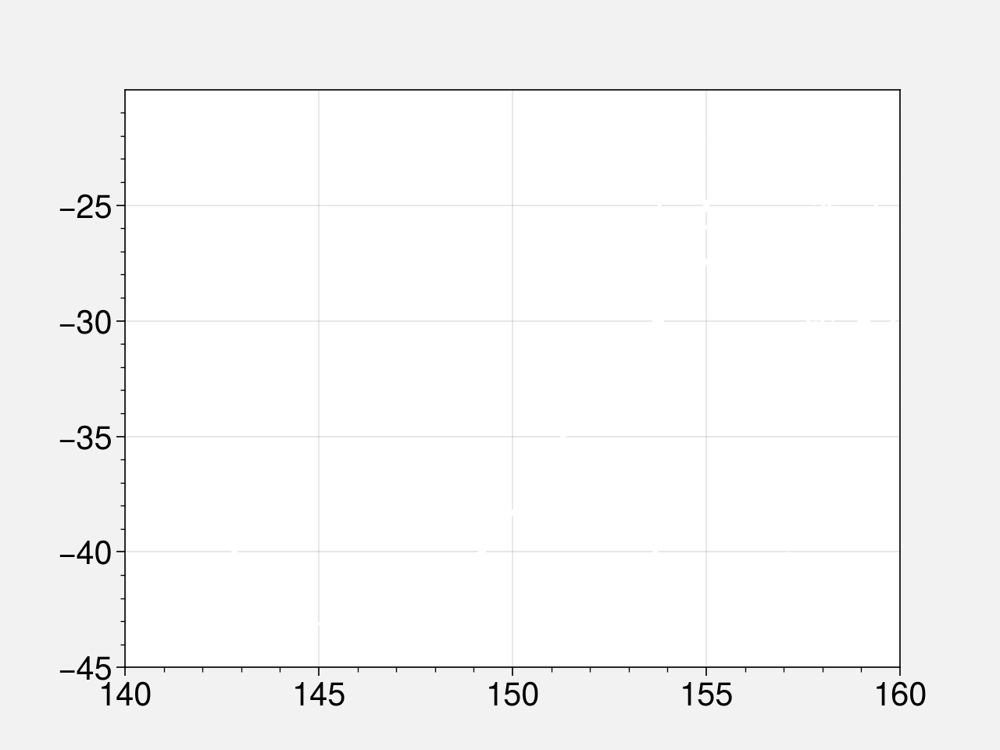

In [47]:
bathymetric_contours_to_get = [-2000]
SST_anom_on_bathy_contours  = []
SST_on_bathy_contours  = []

v_current_bathy_contours  = []
v_current_anom_bathy_contours  = []

u_current_bathy_contours  = []
u_current_anom_bathy_contours  = []


GSLA_bathy_contours  = []
GSLA_anom_bathy_contours  = []


JRA_srf_temperature_bathy_contours  = []

lat_lim_south = -35.0
lat_lim_north = -25.0
delta_lat = 0.25

for i_bathy_contour in range(0,len(bathymetric_contours_to_get)):

    print('Interpolating along the ', bathymetric_contours_to_get[i_bathy_contour], 'm isobath')
    cs = plt.contour(bathymetry_dataset['x'], bathymetry_dataset['y'], bathymetry_dataset['z'],[bathymetric_contours_to_get[i_bathy_contour]])
    max_length = 0
    for line in cs.collections[0].get_paths():
        n_points,_ = line.vertices.shape
        if n_points>max_length:
            bathymetric_contour_lat_lon = line.vertices
            max_length = n_points
        
    #lines.append(line.vertices)
    #plt.plot(bathymetric_contour_lat_lon[:,0],bathymetric_contour_lat_lon[:,1],'r*')
    

    idx_lat_lim_south = np.nonzero(bathymetric_contour_lat_lon[:,1]>lat_lim_south)[0][0]
    idx_lat_lim_north = np.nonzero(bathymetric_contour_lat_lon[:,1]>lat_lim_north)[0][0]

    regular_lat_points_on_bathy_contour = np.arange(lat_lim_south-delta_lat,lat_lim_north+delta_lat,delta_lat)
    regular_lon_points_on_bathy_contour = np.interp(regular_lat_points_on_bathy_contour, bathymetric_contour_lat_lon[idx_lat_lim_south:idx_lat_lim_north,1], bathymetric_contour_lat_lon[idx_lat_lim_south:idx_lat_lim_north,0])

    bathy_contour_lon = xarray.DataArray(regular_lon_points_on_bathy_contour, dims="z")
    bathy_contour_lat = xarray.DataArray(regular_lat_points_on_bathy_contour, dims="z")


    SST_on_bathy_contours.append(       SST.interp(lon=bathy_contour_lon,lat=bathy_contour_lat).persist().squeeze())
    SST_anom_on_bathy_contours.append(  SST_anom_dataset['sea_surface_temperature'].interp(lon=bathy_contour_lon,lat=bathy_contour_lat).persist().squeeze())

    
    u_current_bathy_contours.append(       u_current.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
    u_current_anom_bathy_contours.append(  u_current_anom.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())

    v_current_bathy_contours.append(       v_current.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
    v_current_anom_bathy_contours.append(  v_current_anom.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())

    
    GSLA_bathy_contours.append(       GSLA.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
    GSLA_anom_bathy_contours.append(       GSLA_anom.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
    
    
    JRA_srf_temperature_bathy_contours.append(       JRA_srf_temperature_dataset['TMP_GDS0_HTGL'].interp(g0_lon_2=bathy_contour_lon,g0_lat_1=bathy_contour_lat).persist().squeeze())
    

In [48]:
SST_dates = pandas.to_datetime(SST_dataset['time'].values)
SST_dates = SST_dates.to_pydatetime()

SST_ordinal_time = np.zeros([len(SST_dates)],dtype=np.int)
for iT in range(0,len(SST_dates)):
    SST_ordinal_time[iT] = SST_dates[iT].toordinal()
n_years = pandas.to_datetime(SST_dataset['time'].values).year.unique().size


/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:4: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  after removing the cwd from sys.path.


In [49]:
import statsmodels.api as stats_model_api

MHW_stats_container = []
MCS_stats_container = []

time_before_after = 20

e_folding = 0.1 #1.0/np.exp(1)


MHW_SST_efolding_time  = []
MHW_GSLA_efolding_time = []
MHW_v_efolding_time    = []

MHW_SST_autocorr       = []
MHW_SLA_autocorr       = []
MHW_v_autocorr       = []



MCS_SST_efolding_time  = []
MCS_GSLA_efolding_time = []
MCS_v_efolding_time    = []
MCS_SST_autocorr       = []
MCS_SLA_autocorr       = []

n_lags = 30
for i_lat in range(SST_on_bathy_contours[0]['lat'].size):
    print('Lat: ', SST_on_bathy_contours[0]['lat'][i_lat].values)
    
    SST_time_series_heat_wave = SST_on_bathy_contours[0].isel(z=i_lat).squeeze()
    SST_anom_time_series      = SST_anom_on_bathy_contours[0].isel(z=i_lat).squeeze()
    GSLA_anom_time_series     = GSLA_anom_bathy_contours[0].isel(z=i_lat).squeeze()
    v_anom_time_series        = v_current_anom_bathy_contours[0].isel(z=i_lat).squeeze()

    
    
    marine_heat_waves, clim_marine_heat_waves   = mhw.detect(SST_ordinal_time,SST_time_series_heat_wave.squeeze().values,coldSpells=False,minDuration=10,maxGap=3)
    marine_cold_spells, clim_marine_cold_spells = mhw.detect(SST_ordinal_time,SST_time_series_heat_wave.squeeze().values,coldSpells=True,minDuration=10,maxGap=3)
    
    
    n_events_heat_wave_events = marine_heat_waves['n_events']
    
    SST_average_efolding  = 0
    GSLA_average_efolding = 0
    v_average_efolding    = 0
    
    
    SST_average_autocorr = np.zeros(n_lags+1,dtype='float32')
    SLA_average_autocorr = np.zeros(n_lags+1,dtype='float32')
    v_average_autocorr   = np.zeros(n_lags+1,dtype='float32')

    for i_event in range(0,n_events_heat_wave_events):
        start_date = pandas.to_datetime(marine_heat_waves['date_start'][i_event])-pandas.Timedelta(time_before_after,'D')
        end_date = pandas.to_datetime(marine_heat_waves['date_end'][i_event]) + pandas.Timedelta(time_before_after,'D')

        SST_anom_for_event = SST_anom_time_series.sel(time=slice(start_date,end_date))
        GSLA_anom_for_event = GSLA_anom_time_series.sel(TIME=slice(start_date,end_date))
        v_anom_for_event    = v_anom_time_series.sel(TIME=slice(start_date,end_date))

        if GSLA_anom_for_event.size>0:
            SST_auto_correlation = stats_model_api.tsa.acf(SST_anom_for_event.squeeze().values, nlags=n_lags,missing='drop')
            GSLA_auto_correlation = stats_model_api.tsa.acf(GSLA_anom_for_event.squeeze().values, nlags=n_lags,missing='drop')
            v_auto_correlation = stats_model_api.tsa.acf(v_anom_for_event.squeeze().values, nlags=n_lags,missing='drop')
            
            
            SST_average_autocorr[0:SST_auto_correlation.size] = SST_average_autocorr[0:SST_auto_correlation.size] + SST_auto_correlation
            SLA_average_autocorr[0:GSLA_auto_correlation.size] = SLA_average_autocorr[0:GSLA_auto_correlation.size] + GSLA_auto_correlation
            v_average_autocorr[0:v_auto_correlation.size]   = v_average_autocorr[0:v_auto_correlation.size] + v_auto_correlation
            
            
            SST_e_folding_idx = np.nonzero(SST_auto_correlation<=e_folding)[0][0]
            GSLA_e_folding_idx = np.nonzero(GSLA_auto_correlation<=e_folding)[0][0]
            v_e_folding_idx = np.nonzero(v_auto_correlation<=e_folding)[0][0]

            SST_average_efolding  = SST_average_efolding  + SST_e_folding_idx
            GSLA_average_efolding = GSLA_average_efolding + GSLA_e_folding_idx
            v_average_efolding    = v_average_efolding + v_e_folding_idx

    n_events_cold_spell_events = marine_cold_spells['n_events']
     
    MHW_SST_autocorr.append(SST_average_autocorr/n_events_heat_wave_events)
    MHW_SLA_autocorr.append(SLA_average_autocorr/n_events_heat_wave_events)
    MHW_v_autocorr.append(v_average_autocorr/n_events_heat_wave_events)
    
    MHW_SST_efolding_time.append(SST_average_efolding/n_events_heat_wave_events)
    MHW_GSLA_efolding_time.append(GSLA_average_efolding/n_events_heat_wave_events)
    MHW_v_efolding_time.append(v_average_efolding/n_events_heat_wave_events)
    
    
    SST_average_efolding  = 0
    GSLA_average_efolding = 0
    v_average_efolding    = 0

    for i_event in range(0,n_events_cold_spell_events):
        start_date = pandas.to_datetime(marine_cold_spells['date_start'][i_event])-pandas.Timedelta(time_before_after,'D')
        end_date = pandas.to_datetime(marine_cold_spells['date_end'][i_event]) + pandas.Timedelta(time_before_after,'D')

        SST_anom_for_event  = SST_anom_time_series.sel(time=slice(start_date,end_date))
        GSLA_anom_for_event = GSLA_anom_time_series.sel(TIME=slice(start_date,end_date))
        v_anom_for_event    = v_anom_time_series.sel(TIME=slice(start_date,end_date))

        if GSLA_anom_for_event.size>0:
            SST_auto_correlation = stats_model_api.tsa.acf(SST_anom_for_event.squeeze().values, nlags=n_lags,missing='drop')
            GSLA_auto_correlation = stats_model_api.tsa.acf(GSLA_anom_for_event.squeeze().values, nlags=n_lags,missing='drop')
            v_auto_correlation = stats_model_api.tsa.acf(v_anom_for_event.squeeze().values, nlags=n_lags,missing='drop')

            
            SST_e_folding_idx = np.nonzero(SST_auto_correlation<=e_folding)[0][0]
            GSLA_e_folding_idx = np.nonzero(GSLA_auto_correlation<=e_folding)[0][0]
            v_e_folding_idx = np.nonzero(v_auto_correlation<=e_folding)[0][0]

            SST_average_efolding  = SST_average_efolding  + SST_e_folding_idx
            GSLA_average_efolding = GSLA_average_efolding + GSLA_e_folding_idx
            v_average_efolding    = v_average_efolding + v_e_folding_idx

            
    MCS_SST_efolding_time.append(SST_average_efolding/n_events_heat_wave_events)
    MCS_GSLA_efolding_time.append(GSLA_average_efolding/n_events_heat_wave_events)
    MCS_v_efolding_time.append(v_average_efolding/n_events_heat_wave_events)
    
    MHW_stats_container.append(marine_heat_waves)
    MCS_stats_container.append(marine_cold_spells)

Lat:  -35.25
Lat:  -35.0
Lat:  -34.75
Lat:  -34.5
Lat:  -34.25
Lat:  -34.0
Lat:  -33.75
Lat:  -33.5
Lat:  -33.25
Lat:  -33.0
Lat:  -32.75
Lat:  -32.5
Lat:  -32.25
Lat:  -32.0
Lat:  -31.75
Lat:  -31.5
Lat:  -31.25
Lat:  -31.0
Lat:  -30.75
Lat:  -30.5
Lat:  -30.25
Lat:  -30.0
Lat:  -29.75
Lat:  -29.5
Lat:  -29.25
Lat:  -29.0
Lat:  -28.75
Lat:  -28.5
Lat:  -28.25
Lat:  -28.0
Lat:  -27.75
Lat:  -27.5
Lat:  -27.25
Lat:  -27.0
Lat:  -26.75
Lat:  -26.5
Lat:  -26.25
Lat:  -26.0
Lat:  -25.75
Lat:  -25.5
Lat:  -25.25
Lat:  -25.0


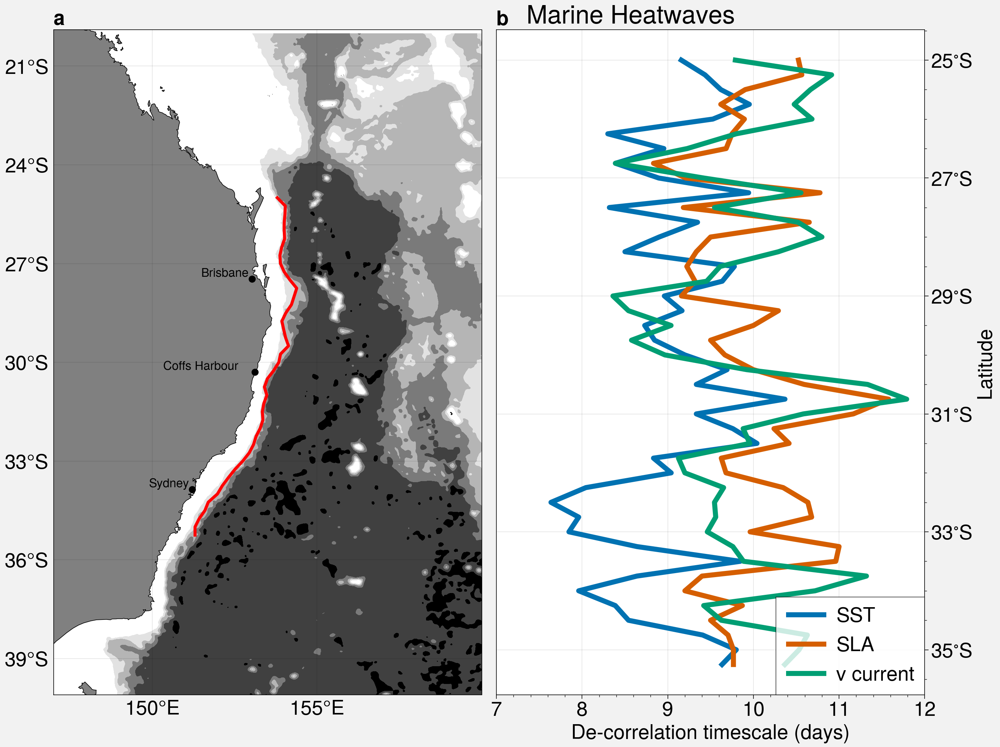

In [88]:
from scipy import signal as scipy_signal
from scipy import stats  as scipy_stats
import proplot
from matplotlib.patches import ConnectionPatch
import matplotlib.colors as mcolors
import pandas


city_font_size = 12
start_date = pandas.Timestamp(2010, 1, 1)
end_date   = pandas.Timestamp(2020, 1, 1)
north_lim = -27.0
south_lim = -34
TARGET_LATITUDE = -27.5




proplot.rc['land.color'] = 'grey'
proplot.rc['text.labelsize'] = 20
proplot.rc['text.titlesize'] = 25
proplot.rc['abc.size'] = 20
proplot.rc['abc.style'] = 'a'

proplot.rc.reso = 'hi'  # use higher res for zoomed in geographic features
proj = proplot.Proj('cyl', basemap=False)

lon_min = 147
lon_max = 160
lat_max = -20
lat_min = -40.0


image_array = [
    [1, 2] ]

fig, axs = proplot.subplots(np.asarray(image_array), proj={1:proj},axwidth='15cm',share=False) #,sharey=0)
axs.format(facecolor='white',abc=True) #, color='grey')


image_counter = 0


cs_bathy = axs[image_counter].contourf(bathymetry_dataset['x'], bathymetry_dataset['y'], -1*bathymetry_dataset['z'],
                        levels=np.arange(0,6001,1000),cmap=plt.cm.Greys)
#cbar = axs[image_counter].colorbar(cs_bathy,label='Depth (m)',loc='l',ticks=np.arange(0,6001,1000))


axs[image_counter].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='red',linewidth=3.0)

axs[image_counter].format(
    lonlim=(lon_min, lon_max), latlim=(lat_min-0.1, lat_max+0.1),
    labels=True,land=True,coast=True,lonlines=np.arange(140,161,5))

axs[image_counter].plot(brisbane_lon-0.5,brisbane_lat,'o',color='k')
axs[image_counter].plot(sydney_lon-0.5,sydney_lat,'o',color='k')
axs[image_counter].plot(coffs_lon-0.1,coffs_lat,'o',color='k')

transform = ccrs.PlateCarree()._as_mpl_transform(axs[image_counter])

axs[image_counter].annotate('Brisbane', xy=(brisbane_lon-0.6,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
axs[image_counter].annotate('Sydney', xy=(sydney_lon-0.6,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
axs[image_counter].annotate('Coffs Harbour', xy=(coffs_lon-0.6,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)



image_counter =  image_counter+1

cs_cross_corr = axs[image_counter].plot(MHW_SST_efolding_time,SST_anom_on_bathy_contours[0]['lat'].values,label='SST',linewidth=5)
cs_cross_corr = axs[image_counter].plot(MHW_GSLA_efolding_time,SST_anom_on_bathy_contours[0]['lat'].values,label='SLA',linewidth=5)
cs_cross_corr = axs[image_counter].plot(MHW_v_efolding_time,SST_anom_on_bathy_contours[0]['lat'].values,label='v current',linewidth=5)
#axs[image_counter].legend(loc='ul',ncol=1)
axs[image_counter].set_xlim([7,12])
axs[image_counter].set_yticks(np.arange(-35,-24,2))
#axs[image_counter].set_yticklabels([])
axs[image_counter].set_xlabel('De-correlation timescale (days)')
axs[image_counter].annotate('Marine Heatwaves', xy=(0.07,1.02),xycoords='axes fraction',
            ha='left', va='center',fontsize=25)


#image_counter =  image_counter+1

#cs_cross_corr = axs[image_counter].plot(MCS_SST_efolding_time,SST_anom_on_bathy_contours[0]['lat'].values,label='SST',linewidth=5)
#cs_cross_corr = axs[image_counter].plot(MCS_GSLA_efolding_time,SST_anom_on_bathy_contours[0]['lat'].values,label='SLA',linewidth=5)
#cs_cross_corr = axs[image_counter].plot(MCS_v_efolding_time,SST_anom_on_bathy_contours[0]['lat'].values,label='v current',linewidth=5)
axs[image_counter].legend(loc='lr',ncol=1)

#axs[image_counter].set_xlim([8,20])
#axs[image_counter].set_yticks(np.arange(-35,-24,2))


lat_ticks = []
for i_tick in np.arange(-35,-24,2):
    lat_ticks.append(str(np.abs(i_tick)) + '$^{\circ}$S')
    
axs[image_counter].set_yticklabels(lat_ticks)
axs[image_counter].set_xlabel('De-correlation timescale (days)')
axs[image_counter].yaxis.tick_right()


#axs[image_counter].annotate('Marine Coldspells', xy=(0.07,1.02),xycoords='axes fraction',
#            ha='left', va='center',fontsize=25)

axs[image_counter].set_ylabel('Latitude')
axs[image_counter].yaxis.set_label_position("right")

figure_output_path = 'Figures_Update'
figure_file_name = 'Decorrelation_time_scale_with_latitude_SST_SLA_v_MHW_only' 
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=400,bbox='tight', transparent=True)
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight', transparent=True)



In [51]:
MHW_n_events      = np.zeros(SST_on_bathy_contours[0]['lat'].size,dtype='int')
MHW_duration      = np.zeros(SST_on_bathy_contours[0]['lat'].size,dtype='float')
MHW_duration_std  = np.zeros(SST_on_bathy_contours[0]['lat'].size,dtype='float')
MHW_max_intensity = np.zeros(SST_on_bathy_contours[0]['lat'].size,dtype='float')
MHW_max_intensity_std = np.zeros(SST_on_bathy_contours[0]['lat'].size,dtype='float')



MHW_n_events_mod    =  np.zeros(SST_on_bathy_contours[0]['lat'].size,dtype='int')
MHW_n_events_strong =  np.zeros(SST_on_bathy_contours[0]['lat'].size,dtype='int')


for i_lat in range(SST_on_bathy_contours[0]['lat'].size):
    current_MHW_stats = MHW_stats_container[i_lat]
    
    MHW_n_events[i_lat] = current_MHW_stats['n_events']
    MHW_duration[i_lat] = np.asarray(current_MHW_stats['duration']).mean()
    MHW_duration_std[i_lat] = np.asarray(current_MHW_stats['duration']).std()

    MHW_max_intensity[i_lat] = np.asarray(current_MHW_stats['intensity_max']).mean()
    MHW_max_intensity_std[i_lat] = np.asarray(current_MHW_stats['intensity_max']).std()

    
    mod_category_events = np.asarray(MHW_stats_container[i_lat]['category'])=='Moderate'

    MHW_n_events_mod[i_lat] = mod_category_events.astype('int').sum()
    strong_category_events = np.asarray(MHW_stats_container[i_lat]['category'])=='Strong'
    MHW_n_events_strong[i_lat] = strong_category_events.astype('int').sum()


In [52]:
MCS_n_events      = np.zeros(SST_on_bathy_contours[0]['lat'].size,dtype='int')
MCS_duration      = np.zeros(SST_on_bathy_contours[0]['lat'].size,dtype='float')
MCS_duration_std  = np.zeros(SST_on_bathy_contours[0]['lat'].size,dtype='float')

MCS_max_intensity     = np.zeros(SST_on_bathy_contours[0]['lat'].size,dtype='float')
MCS_max_intensity_std = np.zeros(SST_on_bathy_contours[0]['lat'].size,dtype='float')

MCS_n_events_mod    =  np.zeros(SST_on_bathy_contours[0]['lat'].size,dtype='int')
MCS_n_events_strong =  np.zeros(SST_on_bathy_contours[0]['lat'].size,dtype='int')


for i_lat in range(SST_on_bathy_contours[0]['lat'].size):
    current_MCS_stats = MCS_stats_container[i_lat]
    
    MCS_n_events[i_lat] = current_MCS_stats['n_events']
    MCS_duration[i_lat] = np.asarray(current_MCS_stats['duration']).mean()
    MCS_duration_std[i_lat] = np.asarray(current_MCS_stats['duration']).std()

    MCS_max_intensity[i_lat] = np.asarray(current_MCS_stats['intensity_max']).mean()
    MCS_max_intensity_std[i_lat] = np.asarray(current_MCS_stats['intensity_max']).std()

    
    mod_category_events = np.asarray(MCS_stats_container[i_lat]['category'])=='Moderate'

    MCS_n_events_mod[i_lat] = mod_category_events.sum()
    strong_category_events = np.asarray(MCS_stats_container[i_lat]['category'])=='Strong'
    MCS_n_events_strong[i_lat] = strong_category_events.sum()


In [53]:
MHW_MCS_hovmollers = np.zeros([SST_dates.size,len(MCS_stats_container)],dtype='int')
for i_lat in range(SST_on_bathy_contours[0]['lat'].size):
    
    current_MHW_stats = MHW_stats_container[i_lat]
    current_MCS_stats = MCS_stats_container[i_lat]

    for i_event in range(0,current_MHW_stats['n_events']):
        
        start_index_event = current_MHW_stats['index_start'][i_event]
        end_index_event    = current_MHW_stats['index_end'][i_event]
        event_category    = current_MHW_stats['category'][i_event]
        
        if event_category =='Moderate':
            MHW_MCS_hovmollers[start_index_event:end_index_event,i_lat] = 1
        elif event_category =='Strong':
            MHW_MCS_hovmollers[start_index_event:end_index_event,i_lat] = 2
    for i_event in range(0,current_MCS_stats['n_events']):
   
        start_index_event = current_MCS_stats['index_start'][i_event]
        end_index_event    = current_MCS_stats['index_end'][i_event]
        event_category    = current_MCS_stats['category'][i_event]
        
        if event_category =='Moderate':
            MHW_MCS_hovmollers[start_index_event:end_index_event,i_lat] = -1
        elif event_category =='Strong':
            MHW_MCS_hovmollers[start_index_event:end_index_event,i_lat] = -2


In [54]:
brisbane_lat = -27.470125
brisbane_lon = 153.021072 + 0.5
sydney_lat   = -33.865143
sydney_lon   = 151.209900 + 0.5
coffs_lat   = -30.296276 
coffs_lon   = 153.214136 

LOCATION = 'COFFS_HARBOUR'
#LOCATION = 'SYDNEY'
#LOCATION = 'BRISBANE'


if LOCATION=='COFFS_HARBOUR':
    idx_loc = np.nonzero(SST_on_bathy_contours[0]['lat'].values>=coffs_lat)[0][0]
elif LOCATION == 'BRISBANE':
    idx_loc = np.nonzero(SST_on_bathy_contours[0]['lat'].values>=brisbane_lat)[0][0]    
elif LOCATION == 'SYDNEY':
    idx_loc = np.nonzero(SST_on_bathy_contours[0]['lat'].values>=sydney_lat)[0][0]
    
lon_point = SST_on_bathy_contours[0]['lon'][idx_loc]
lat_point = SST_on_bathy_contours[0]['lat'][idx_loc]



SST_time_series_heat_wave = SST_dataset['sea_surface_temperature'].sel(lon=lon_point.values,lat=lat_point.values,method='nearest') 

marine_heat_waves, clim_marine_heat_waves   = mhw.detect(SST_ordinal_time,SST_time_series_heat_wave.squeeze().values,coldSpells=False,maxGap=3,minDuration=10)
marine_cold_spells, clim_marine_cold_spells = mhw.detect(SST_ordinal_time,SST_time_series_heat_wave.squeeze().values,coldSpells=True,maxGap=3,minDuration=10)

0 Strong 14
1 Moderate 14
2 Strong 47
3 Moderate 15
4 Moderate 44
5 Strong 35
6 Moderate 13
7 Moderate 20
8 Strong 38
9 Moderate 10
10 Strong 39
11 Moderate 13
12 Moderate 12
13 Moderate 14
14 Moderate 10
15 Moderate 11
16 Strong 11
17 Moderate 10
18 Moderate 13
19 Moderate 31
20 Moderate 11
21 Moderate 12
22 Moderate 19


In [55]:
import event_analysis
import warnings
warnings.filterwarnings('ignore')


shift_increments   = 5
n_shifts = 20

marine_cold_spell_peak_time = []
for i_event in range(len(marine_cold_spells['date_peak'])):
    marine_cold_spell_peak_time.append(np.datetime64(marine_cold_spells['date_peak'][i_event]) )
marine_cold_spell_peak_time = np.asarray(marine_cold_spell_peak_time)


marine_cold_spell_shifted_composite_SST = event_analysis.simple_shifted_event_composite_average(marine_cold_spell_peak_time,SST_anom_dataset['sea_surface_temperature'].squeeze(),n_shifts,shift_increments,
                                                                                                sensor_dims=['lat', 'lon'],sample_dim='time')

In [56]:
import event_analysis

import warnings
warnings.filterwarnings('ignore')


shift_increments   = 5
n_shifts = 20

marine_heat_waves_peak_time = []
for i_event in range(len(marine_heat_waves['date_peak'])):
    marine_heat_waves_peak_time.append(np.datetime64(marine_heat_waves['date_peak'][i_event]) )
marine_heat_waves_peak_time = np.asarray(marine_heat_waves_peak_time)


marine_heat_waves_shifted_composite_SST = event_analysis.simple_shifted_event_composite_average(marine_heat_waves_peak_time,SST_anom_dataset['sea_surface_temperature'].squeeze(),n_shifts,shift_increments,
                                                                                                sensor_dims=['lat', 'lon'],sample_dim='time')


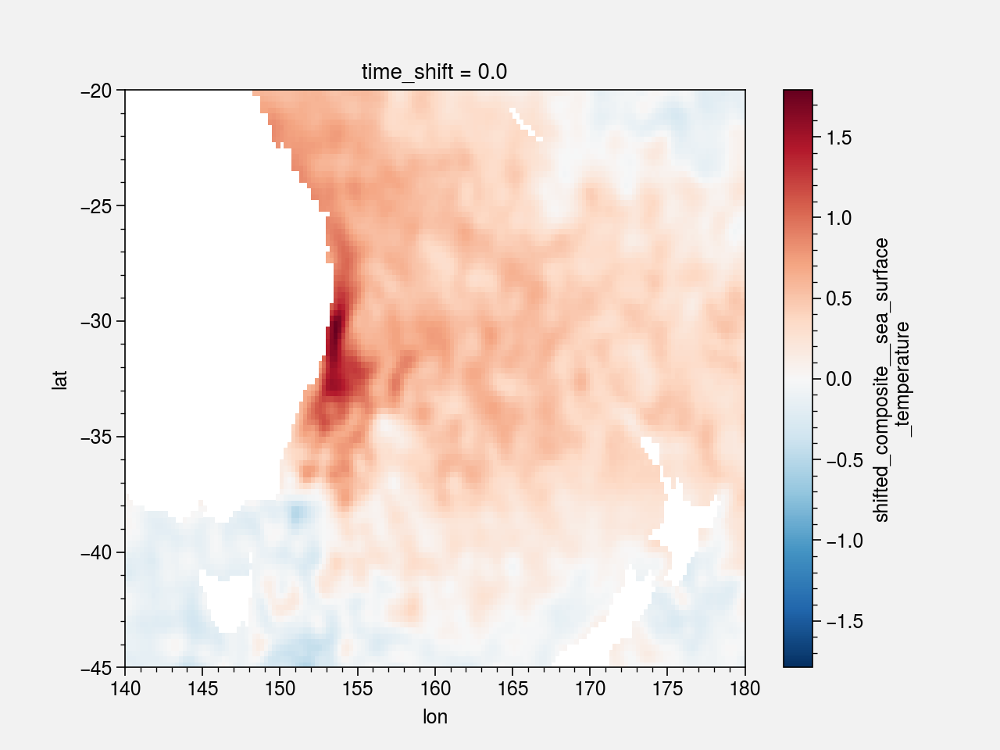

In [13]:
marine_heat_waves_shifted_composite_SST['shifted_composite__sea_surface_temperature'][20,:,:].plot()

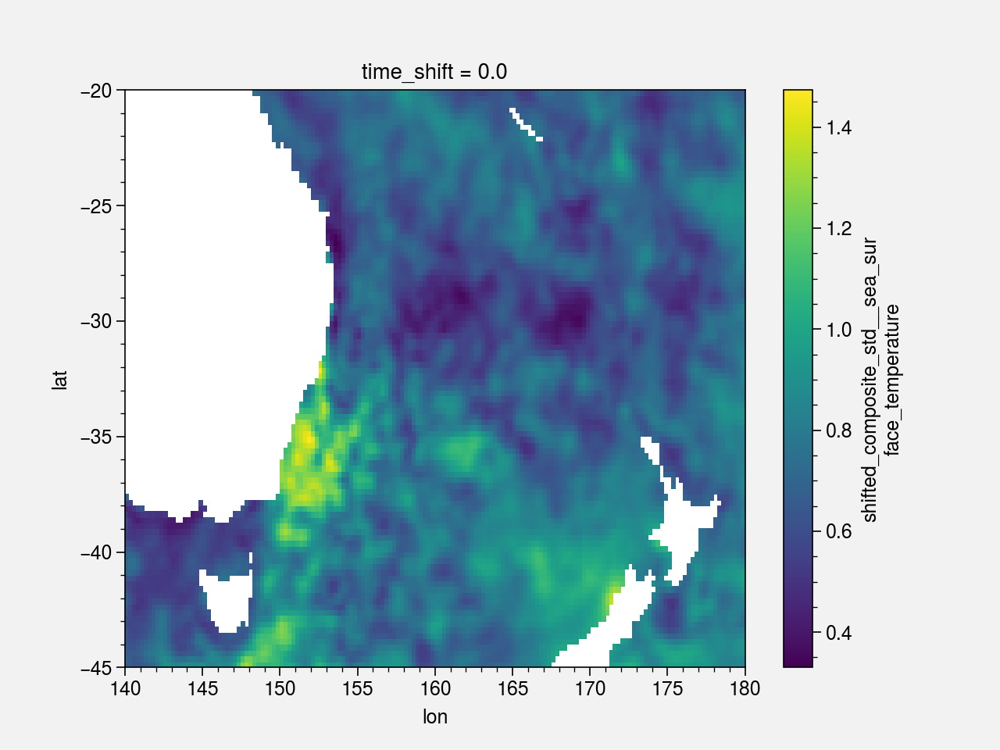

In [15]:
marine_heat_waves_shifted_composite_SST['shifted_composite_std__sea_surface_temperature'][20,:,:].plot()

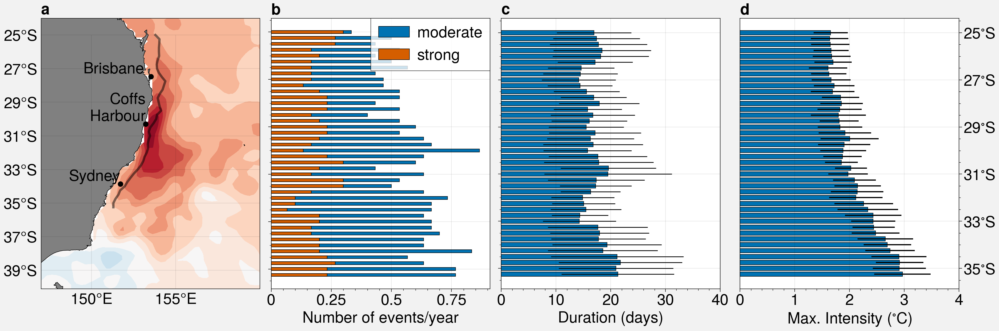

In [62]:
from scipy import signal as scipy_signal
from scipy import stats  as scipy_stats
import proplot
from matplotlib.patches import ConnectionPatch

city_font_size = 20
start_date = pandas.Timestamp(2018, 1, 1)
end_date   = pandas.Timestamp(2020, 1, 1)
north_lim = -25
south_lim = -35

lat_ticks = np.arange(south_lim,north_lim+0.1,2)
lat_tick_labels = []
for i_tick in lat_ticks:
    lat_tick_labels.append(str(int(np.abs(i_tick))) + r'$^{\circ}$S')

idx_south_lim = np.nonzero(SST_on_bathy_contours[0]['lat'].values>=south_lim)[0][0]
idx_north_lim = np.nonzero(SST_on_bathy_contours[0]['lat'].values>=north_lim)[0][0]

proplot.rc['land.color'] = 'white'
proplot.rc['text.labelsize'] = 20
proplot.rc['text.titlesize'] = 25
proplot.rc['abc.size'] = 20
proplot.rc['abc.style'] = 'a'

proplot.rc.reso = 'hi'  # use higher res for zoomed in geographic features
proj = proplot.Proj('cyl', basemap=False)

lon_min = 147
lon_max = 160
lat_max = -25
lat_min = -40.0

#image_array = [
#    [1,  2,3,4],
#    [1,  2,3,4],
#    [5,  6,7,8],
#    [5,  6,7,8],]

image_array = [
    [1,  2,3,4],
    [1,  2,3,4]]


n_quiver_points = 2
fig, axs = proplot.subplots(np.asarray(image_array), proj={1:proj},axwidth='10cm',sharey=1,sharex=0)
axs.format(facecolor='white',abc=True) #, color='grey')

image_counter = 0

cs_sst = axs[image_counter].contourf(marine_heat_waves_shifted_composite_SST['lon'], marine_heat_waves_shifted_composite_SST['lat'], 
                                     marine_heat_waves_shifted_composite_SST['shifted_composite__sea_surface_temperature'].sel(time_shift=0),levels=np.linspace(-2.0,2.0,20),cmap=plt.cm.RdBu_r)
#cs_sst = axs[image_counter].contourf(marine_heat_waves_shifted_composite_GHRSST['lon'], marine_heat_waves_shifted_composite_GHRSST['lat'], 
#                                     marine_heat_waves_shifted_composite_GHRSST['shifted_composite__sst'].sel(time_shift=0),levels=np.linspace(-2.0,2.0,20),cmap=plt.cm.RdBu_r)



#u_heat_wave_peak_composite = marine_heat_waves_shifted_composite_U_anom['shifted_composite__UCUR'].sel(time_shift=0,method='nearest')
#v_heat_wave_peak_composite = marine_heat_waves_shifted_composite_V_anom['shifted_composite__VCUR'].sel(time_shift=0,method='nearest')

#cs_quiver = axs[image_counter].quiver(u_heat_wave_peak_composite['LONGITUDE'][::2],u_heat_wave_peak_composite['LATITUDE'][::2],
#                                         u_heat_wave_peak_composite[::2,::2].values,v_heat_wave_peak_composite[::2,::2].values, 
#                                        transform=ccrs.PlateCarree(), color='k',scale=5)
#qk = axs[image_counter].quiverkey(cs_quiver, 0.70, 0.05, 0.25, r'25 cm.s$^{-1}$', labelpos='E',
#                       coordinates='axes',fontproperties={'size':15})
    


axs[image_counter].format(
    lonlim=(lon_min, lon_max), latlim=(lat_min-0.1, lat_max+1),
    labels=True,land=True,coast=True,lonlines=np.arange(140,161,5),latlines=np.arange(-45,north_lim+0.1,2),landcolor='grey')
#longitude_slice = np.arange(153,155+0.05,0.1)
#xy_start = [bathy_contour_lon.values[-1],bathy_contour_lat.values[-1]]
transform = ccrs.PlateCarree()._as_mpl_transform(axs[image_counter])

axs[image_counter].plot(brisbane_lon,brisbane_lat,'o',color='k')
axs[image_counter].plot(sydney_lon,sydney_lat,'o',color='k')
axs[image_counter].plot(coffs_lon,coffs_lat,'o',color='k')
axs[image_counter].plot(SST_on_bathy_contours[0]['lon'],SST_on_bathy_contours[0]['lat'],color='black',linewidth=3.0,alpha=0.5)

transform = ccrs.PlateCarree()._as_mpl_transform(axs[image_counter])

axs[image_counter].annotate('Brisbane', xy=(brisbane_lon-0.4,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
axs[image_counter].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
axs[image_counter].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)


image_counter = image_counter+1


#image_counter = image_counter+1
axs[image_counter].barh(SST_on_bathy_contours[0]['lat'].values, MHW_n_events_mod/n_years, align='center', height=.5,label='moderate')
axs[image_counter].barh(SST_on_bathy_contours[0]['lat'].values, MHW_n_events_strong/n_years, align='center', height=.5, left=MCS_n_events_mod,label='strong')

axs[image_counter].set_yticks(lat_ticks)
axs[image_counter].set_yticklabels([])

axs[image_counter].legend(loc='upper right',fontsize=20,ncol=1)
axs[image_counter].set_xlabel('Number of events/year')
axs[image_counter].grid(True)

lat_ticks = np.arange(np.around(SST_on_bathy_contours[0]['lat'][0].values,0),np.around(SST_on_bathy_contours[0]['lat'][-1].values,0)+1,2)  
axs[image_counter].set_yticks(lat_ticks)

axs[image_counter].set_yticklabels([])

image_counter = image_counter + 1
#axs[1].plot(MHW_n_events,SST_on_bathy_contours[0]['lat'])[1, 1, 0,0],
axs[image_counter].barh(SST_on_bathy_contours[0]['lat'].values, MHW_duration, align='center', height=0.75,xerr=MHW_duration_std,error_kw={'elinewidth':1})
axs[image_counter].set_xlabel('Duration (days)')
axs[image_counter].set_yticks(lat_ticks)
axs[image_counter].set_yticklabels([])
axs[image_counter].set_xlim([0,40])

image_counter = image_counter + 1

axs[image_counter].barh(SST_on_bathy_contours[0]['lat'].values, MHW_max_intensity, align='center', height=0.75,xerr=MHW_max_intensity_std,error_kw={'elinewidth':1.5})
axs[image_counter].set_xlabel('Max. Intensity ($^{\circ}$C)')
axs[image_counter].set_yticks(lat_ticks)
axs[image_counter].set_yticklabels(lat_tick_labels)
axs[image_counter].yaxis.tick_right()
axs[image_counter].set_xlim([0,4])
#axs[image_counter].set_ylabel("Latitude")


#image_counter = image_counter + 1

#cs_sst = axs[image_counter].contourf(marine_cold_spell_shifted_composite_GHRSST['lon'], marine_cold_spell_shifted_composite_GHRSST['lat'], 
#                                     marine_cold_spell_shifted_composite_GHRSST['shifted_composite__sst'].sel(time_shift=0),levels=np.linspace(-2.0,2.0,20),cmap=plt.cm.RdBu_r)


#cs_sst = axs[image_counter].contourf(marine_cold_spell_shifted_composite_SST['lon'], marine_cold_spell_shifted_composite_SST['lat'], 
#                                     marine_cold_spell_shifted_composite_SST['shifted_composite__sea_surface_temperature'].sel(time_shift=0),levels=np.linspace(-2.0,2.0,20),cmap=plt.cm.RdBu_r,extend='both')
#
#u_cold_spell_peak_composite    = marine_cold_spell_shifted_composite_U_anom['shifted_composite__UCUR'].sel(time_shift=0,method='nearest')
#v_cold_spell_peak_composite    = marine_cold_spell_shifted_composite_V_anom['shifted_composite__VCUR'].sel(time_shift=0,method='nearest')

#cs_quiver = axs[image_counter].quiver(u_cold_spell_peak_composite['LONGITUDE'][::2],u_cold_spell_peak_composite['LATITUDE'][::2],
#                                         u_cold_spell_peak_composite[::2,::2].values,v_cold_spell_peak_composite[::2,::2].values, 
#                                         transform=ccrs.PlateCarree(), color='k',scale=5)
#qk = axs[image_counter].quiverkey(cs_quiver, 0.70, 0.05, 0.25, r'25 cm.s$^{-1}$', labelpos='E',
#                       coordinates='axes',fontproperties={'size':15})


#axs[image_counter].format(
#    lonlim=(lon_min, lon_max), latlim=(lat_min-0.1, lat_max+1),
#    labels=True,land=True,coast=True,lonlines=np.arange(140,161,5),latlines=np.arange(-45,north_lim+0.1,2),landcolor='grey')
#longitude_slice = np.arange(153,155+0.05,0.1)
#xy_start = [bathy_contour_lon.values[-1],bathy_contour_lat.values[-1]]
#transform = ccrs.PlateCarree()._as_mpl_transform(axs[image_counter])

#axs[image_counter].plot(brisbane_lon,brisbane_lat,'o',color='k')
#axs[image_counter].plot(sydney_lon,sydney_lat,'o',color='k')
#axs[image_counter].plot(coffs_lon,coffs_lat,'o',color='k')
#axs[image_counter].plot(SST_on_bathy_contours[0]['lon'],SST_on_bathy_contours[0]['lat'],color='black',linewidth=3.0,alpha=0.5)

#transform = ccrs.PlateCarree()._as_mpl_transform(axs[image_counter])

#axs[image_counter].annotate('Brisbane', xy=(brisbane_lon-0.5,brisbane_lat), xycoords=transform,
#            ha='right', va='bottom',fontsize=city_font_size)
    
#axs[image_counter].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
#            ha='right', va='bottom',fontsize=city_font_size)
#axs[image_counter].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
#            ha='right', va='bottom',fontsize=city_font_size)


#lat_ticks = np.arange(np.around(SST_on_bathy_contours[0]['lat'][0].values,0),np.around(SST_on_bathy_contours[0]['lat'][-1].values,0)+1,2)  
#axs[image_counter].colorbar(cs_sst, label=r'Temperature Anomaly ($^{\circ}$C)',loc='b',ticks=[-2,-1,0,1,2])


#image_counter = image_counter + 1
#
#axs[image_counter].barh(SST_on_bathy_contours[0]['lat'].values, MCS_n_events_mod/n_years, align='center', height=.5,label='moderate')
#axs[image_counter].barh(SST_on_bathy_contours[0]['lat'].values, MCS_n_events_strong/n_years, align='center', height=.5, left=MCS_n_events_mod,label='strong')
#axs[image_counter].legend(loc='upper right',fontsize=20,ncol=1)
#axs[image_counter].set_yticks(lat_ticks)
#axs[image_counter].set_yticklabels([])

#axs[image_counter].set_xlabel('Number of events/year')
#axs[image_counter].grid(True)


#image_counter = image_counter + 1
#axs[1].plot(MHW_n_events,SST_on_bathy_contours[0]['lat'])[1, 1, 0,0],
#axs[image_counter].barh(SST_on_bathy_contours[0]['lat'].values, MCS_duration, align='center', height=0.75,xerr=MCS_duration_std,error_kw={'elinewidth':1})
#axs[image_counter].set_xlabel('Duration (days)')
#axs[image_counter].set_yticks(lat_ticks)
#axs[image_counter].set_yticklabels([])
#axs[image_counter].set_xlim([0,40])

#image_counter = image_counter + 1

#axs[image_counter].barh(SST_on_bathy_contours[0]['lat'].values, MCS_max_intensity, align='center', height=0.75,xerr=MCS_max_intensity_std,error_kw={'elinewidth':1.5})
#axs[image_counter].set_xlabel('Max. Intensity ($^{\circ}$C)')
#axs[image_counter].set_yticks(lat_ticks)
#
#axs[image_counter].set_yticklabels(lat_tick_labels)
#axs[image_counter].set_ylabel("Latitude")
#
#axs[image_counter].yaxis.tick_right()
#axs[image_counter].set_xlim([-4,0])


figure_output_path = 'Figures_Update'
figure_file_name = 'EAC_marine_heatwave_only_statistics_updated_OISST_detrended' 
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=400,bbox='tight', transparent=False)
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight', transparent=False)

In [69]:
from statsmodels.regression.linear_model import yule_walker
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.arima_process import ArmaProcess
from  statsmodels import tsa as statsmodels_tsa
from statsmodels.tsa.ar_model import AutoReg as statsmodels_AutoReg


import scipy.signal as scipy_signal

np.random.seed(500)
upstream_lat = -27.4


start_date = pandas.Timestamp(1993, 1, 1)
end_date   = pandas.Timestamp(2022, 1, 1)

latitudes = v_current_anom_bathy_contours[0]['LATITUDE'].values
idx_upstream = np.nonzero(latitudes>=upstream_lat)[0][0]
v_upstream = v_current_anom_bathy_contours[0].sel(TIME=slice(start_date,end_date))[:,idx_upstream]
v_upstream_norm = (v_upstream - v_upstream.mean(dim='TIME')) / v_upstream.std(dim='TIME')

downstream_lats = SST_anom_on_bathy_contours[0]['lat'].values


nT = v_upstream.size

autocorr_v_upstream = np.correlate(v_upstream.squeeze(), v_upstream.squeeze(), mode='full')
autocorr_v_upstream = autocorr_v_upstream/autocorr_v_upstream[nT-1]

n_monte_carlo = 100
percentiles = np.asarray([5,10,50,90,95])
lags = correlation_lags(nT,nT,mode="same")
dsad
cross_corr_AR_percentile = np.zeros([percentiles.size,downstream_lats.size,lags.size],dtype=np.float32)

for i_lat in range(0,downstream_lats.size):
    print(i_lat, ' of ', downstream_lats.size)

    SST_downstream = SST_anom_on_bathy_contours[0].sel(time=slice(v_upstream['TIME'].min(),v_upstream['TIME'].max()))[:,i_lat] #.values
    SST_downstream_norm = (SST_downstream- SST_downstream.mean(dim='time')) / SST_downstream.std(dim='time')
    
    cross_correlation = scipy_signal.correlate(SST_downstream_norm, v_upstream_norm, mode='same') / nT
    
    
    if i_lat ==0:
        crosscorr_SST_v_upstream = np.zeros([downstream_lats.size,lags.size],dtype=np.float32)
   
    crosscorr_SST_v_upstream[i_lat,:] = cross_correlation
    
    AR2_model_fit = statsmodels_AutoReg(SST_downstream_norm.values, lags=2).fit()
    arparams = AR2_model_fit.params[1::]
    maparams = np.array([0.0, 0.0]) 
    ar = np.r_[1, -arparams] # add zero-lag and negate
    ma = np.r_[1, maparams] # add zero-lag
    
    AR2_synthetic = statsmodels_tsa.arima_process.arma_generate_sample(ar, ma, [SST_downstream_norm.size,n_monte_carlo])
    cross_correlation_synthetic = np.zeros([SST_downstream_norm.size,n_monte_carlo],dtype="float32")
    
    for i_realisation in range(AR2_synthetic.shape[1]):
        
        cross_correlation_synthetic[:,i_realisation] = scipy_signal.correlate(AR2_synthetic[:,i_realisation], v_upstream_norm, mode='same') / nT
    
    cross_correlation_synthetic_percentile = np.percentile(cross_correlation_synthetic,[5,10,50,90,95],axis=1)
    cross_corr_AR_percentile[:,i_lat,:]    = cross_correlation_synthetic_percentile

NameError: name 'dsad' is not defined

In [63]:
crosscorr_SST_v_upstream = np.load('cross_correlation_and_stat_sig_SST_v_upstream_newcal.npz')['crosscorr_SST_v_upstream']
cross_corr_AR_percentile = np.load('cross_correlation_and_stat_sig_SST_v_upstream_newcal.npz')['cross_corr_AR_percentile']

In [20]:
def welch_periodogram(x,L,data_interval=1,window='hamming'):
    

    nT,nY,nX = x.shape

    x = x.reshape(nT,nX*nY)
    nan_mask = np.logical_not(np.isnan(x[0,:]))
    
    print(x.shape)
    x       = x[:,nan_mask]
    x[np.isnan(x)] = 0
    print(x.shape)

    f,Pxx = scipy_signal.welch(x, fs=data_interval, window='hamming', 
                               nperseg=L, noverlap=int(L/2), nfft=L, detrend='linear', 
                               return_onesided=True, scaling='spectrum', axis=0)
    
    periodogram_map = np.nan*np.zeros([f.size,nX*nY],dtype=np.float32)
    periodogram_map[:,nan_mask] = Pxx
    
    periodogram_map = periodogram_map.reshape(f.size,nY,nX)
    
    return f,periodogram_map

In [21]:
def inband_variance(Pxx,f,period_bands,axis=0):
    
    n_frequency,nY,nX = Pxx.shape
    
    in_band_var = np.nan * np.zeros([len(period_bands),nY,nX])
    
    Pxx = Pxx.reshape(n_frequency,nX*nY)
    nan_mask = np.logical_not(np.isnan(Pxx[0,:]))
    Pxx       = Pxx[:,nan_mask]
    Pxx[np.isnan(Pxx)] = 0
    
    
    for i_band in range(0,daily_bands.shape[0]):

        lower_band = period_bands[i_band][0]
        upper_band = period_bands[i_band][1]

        lower_freq = 1.0/upper_band
        upper_freq = 1.0/lower_band

        print ("Getting frequency bands: ", lower_band, " and ", upper_band)
        power_in_band = np.nan*np.zeros(nX*nY,dtype=np.dtype)


        power_in_band[nan_mask]     = bandpower(Pxx, f, lower_freq, upper_freq,axis=0)
        in_band_var[i_band,:,:]     = power_in_band.reshape(1,nY , nX)

    return in_band_var

In [22]:
def bandpower(Pxx, f, fmin, fmax,axis=0):

    ind_min = np.nonzero(f>=fmin)[0][0]
    ind_max = np.nonzero(f>=fmax)[0][0]

    return np.sum(Pxx[ind_min: ind_max],axis=axis) #/(ind_max-ind_min)

In [31]:
GSLA_anom

,Array,Chunk
Bytes,1.04 GB,101.30 kB
Shape,"(10290, 126, 201)","(1, 126, 201)"
Count,41674 Tasks,10290 Chunks
Type,float32,numpy.ndarray


In [61]:
L=1024
daily_bands = np.asarray([[2.0,20.0],[20.0,60.0],[60.0,90.0],
                          [90.0,150.0]])


f_SST,SST_periodogram = welch_periodogram(SST_anom_dataset['sea_surface_temperature'].squeeze().values,L)

SST_periodogram = xarray.DataArray(SST_periodogram,dims=('freq','lat','lon'),
                                   coords={'freq':f_SST,'lat':SST_anom_dataset['lat'].values,'lon':SST_anom_dataset['lon'].values}) #.to_dataset(name='power_explained')
SST_periodogram = SST_periodogram.to_dataset(name='SST_periodogram')
SST_periodogram.to_netcdf('SST_periodogram.nc')


SST_in_band_var =inband_variance(SST_periodogram['SST_periodogram'].values,SST_periodogram['freq'].values,daily_bands,axis=0)
SST_in_band_var = xarray.DataArray(SST_in_band_var,dims=('bands','lat','lon'),coords={'bands':daily_bands.mean(axis=1),'lat':SST_periodogram['lat'].values,'lon':SST_periodogram['lon'].values}) #.to_dataset(name='power_explained')


(10957, 16000)
(10957, 12173)
Getting frequency bands:  2.0  and  20.0
Getting frequency bands:  20.0  and  60.0
Getting frequency bands:  60.0  and  90.0
Getting frequency bands:  90.0  and  150.0


In [62]:
L=1024

f_GSLA,GSLA_periodogram = welch_periodogram(GSLA_anom.squeeze().values,L)

GSLA_periodogram = xarray.DataArray(GSLA_periodogram,dims=('freq','LATITUDE','LONGITUDE'),
                                   coords={'freq':f_GSLA,'LATITUDE':GSLA_anom['LATITUDE'].values,'LONGITUDE':GSLA_anom['LONGITUDE'].values}) #.to_dataset(name='power_explained')
GSLA_periodogram = GSLA_periodogram.to_dataset(name='GSLA_periodogram')
GSLA_periodogram.to_netcdf('GSLA_periodogram.nc')


GSLA_in_band_var =inband_variance(GSLA_periodogram['GSLA_periodogram'].values,GSLA_periodogram['freq'].values,daily_bands,axis=0)
GSLA_in_band_var = xarray.DataArray(GSLA_in_band_var,dims=('bands','LATITUDE','LONGITUDE'),
                                    coords={'bands':daily_bands.mean(axis=1),'LATITUDE':GSLA_periodogram['LATITUDE'].values,'LONGITUDE':GSLA_periodogram['LONGITUDE'].values}) #.to_dataset(name='power_explained')


(10290, 25326)
(10290, 19120)
Getting frequency bands:  2.0  and  20.0
Getting frequency bands:  20.0  and  60.0
Getting frequency bands:  60.0  and  90.0
Getting frequency bands:  90.0  and  150.0


In [50]:
GSLA_anom_std = GSLA_anom.std(dim='TIME').values
SST_anom_std  = SST_anom_dataset['sea_surface_temperature'].std(dim='time').values

In [49]:
GSLA_anom_std

<xarray.DataArray 'GSLA' (LATITUDE: 126, LONGITUDE: 201)>
dask.array<_sqrt, shape=(126, 201), dtype=float32, chunksize=(126, 201), chunktype=numpy.ndarray>
Coordinates:
  * LONGITUDE  (LONGITUDE) float64 140.0 140.2 140.4 140.6 ... 179.6 179.8 180.0
  * LATITUDE   (LATITUDE) float64 -45.0 -44.8 -44.6 -44.4 ... -20.4 -20.2 -20.0

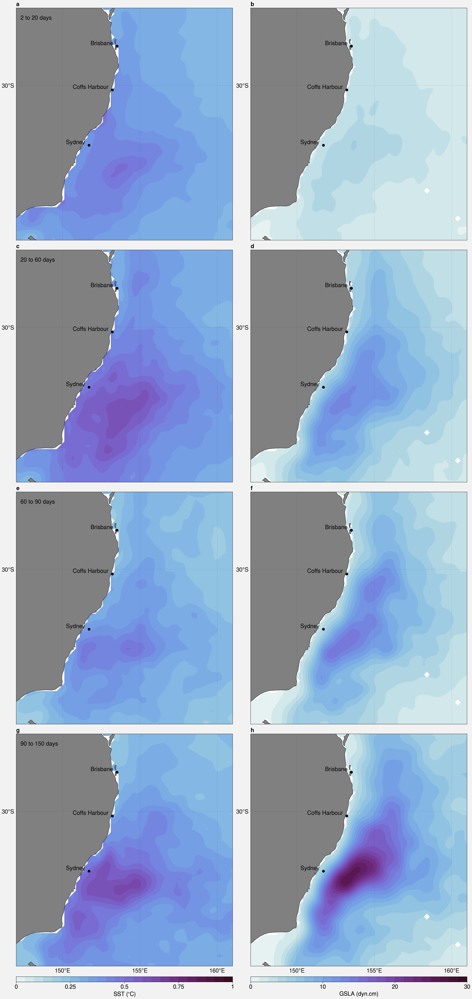

In [78]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import proplot
from cartopy.util import add_cyclic_point
n_bands_to_plot = 5


proplot.rc['land.color'] = 'grey'
proplot.rc['text.labelsize'] = 15
proplot.rc['text.titlesize'] = 25
proplot.rc['abc.size'] = 15
proplot.rc['abc.style'] = 'a'

proplot.rc.reso = 'med'  # use higher res for zoomed in geographic features
proj = proplot.Proj('cyl', basemap=False)
fig, axs = proplot.subplots(ncols=2, nrows=GSLA_in_band_var['bands'].size,proj=proj,axwidth='20cm') #,sharey=3,sharex=3)
axs.format(land=True,coast=True,facecolor='white',abc=True) #, color='grey')


lon_min = 147
lon_max = 161
lat_max = -25
lat_min = -40.0
daily_bands = np.asarray([[2.0,20.0],[20.0,60.0],[60.0,90.0],
                          [90.0,150.0]])

row_index =0
for i_band in range(0,GSLA_in_band_var['bands'].size):
    
    
    
    #cyclic_data, cyclic_lons = add_cyclic_point(OLR_in_band_var[i_band,:,:], coord=OLR_in_band_var['lon'])

    cs_SST = axs[row_index,0].contourf(SST_in_band_var['lon'],SST_in_band_var['lat'],np.sqrt(SST_in_band_var.isel(bands=i_band)),
                                levels=np.linspace(0,1,25),cmap='Dense')

    cs_GSLA = axs[row_index,1].contourf(GSLA_in_band_var['LONGITUDE'],GSLA_in_band_var['LATITUDE'],100.0*(np.sqrt(GSLA_in_band_var.isel(bands=i_band))),
                                levels=np.linspace(0,30,25),cmap='Dense')

    
    if i_band != GSLA_in_band_var['bands'].size-1:
        
        axs[row_index,:].format(latlim=(lat_min, lat_max), lonlim=(lon_min,lon_max),lonlabels=False, latlabels=True,
        land=True,coast=True,lonlines=np.arange(0,360,5),latlines=np.arange(-40,-19,10))
    else:
        axs[row_index,:].format(latlim=(lat_min, lat_max), lonlim=(lon_min,lon_max), lonlabels=True, latlabels=True,
        land=True,coast=True,lonlines=np.arange(0,360,5),latlines=np.arange(-40,-19,10))
    
    axs[row_index,0].annotate(str(int(daily_bands[i_band][0])) + ' to ' +str(int(daily_bands[i_band][1])) + ' days', xy=(0.02, 0.95), xycoords="axes fraction",fontsize=15)

    
    
    axs[row_index,:].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[row_index,:].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[row_index,:].plot(coffs_lon,coffs_lat,'o',color='k')

    transform = ccrs.PlateCarree()._as_mpl_transform(axs[row_index,0])

    axs[row_index,0].annotate('Brisbane', xy=(brisbane_lon-0.25,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[row_index,0].annotate('Sydney', xy=(sydney_lon-0.25,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_index,0].annotate('Coffs Harbour', xy=(coffs_lon-0.25,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    transform = ccrs.PlateCarree()._as_mpl_transform(axs[row_index,1])

    axs[row_index,1].annotate('Brisbane', xy=(brisbane_lon-0.25,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_index,1].annotate('Sydney', xy=(sydney_lon-0.25,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_index,1].annotate('Coffs Harbour', xy=(coffs_lon-0.25,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)

    
    
    
    row_index = row_index+1

    
    

    
cbar = fig.colorbar(cs_SST,  label=r'SST ($^{\circ}$C)',ticks=np.arange(0,1.1,0.25),loc='b',col=1)
cbar = fig.colorbar(cs_GSLA,  label=r'GSLA (dyn.cm)', ticks=np.arange(0,31,10),loc='b',col=2)

figure_output_path = 'Figures_Update'
figure_file_name = 'SST_SLA_in_band_variance_EAC'
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=400,bbox='tight')
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight')


In [30]:
drifter_velocity_dataset = xarray.open_dataset('Mean_drifter_velocities.nc',)
mean_u_current_drifter = drifter_velocity_dataset['mean_binned_u']
mean_v_current_drifter = drifter_velocity_dataset['mean_binned_v']

mean_speed_current_drifter = np.sqrt(mean_u_current_drifter*mean_u_current_drifter + mean_v_current_drifter*mean_v_current_drifter)

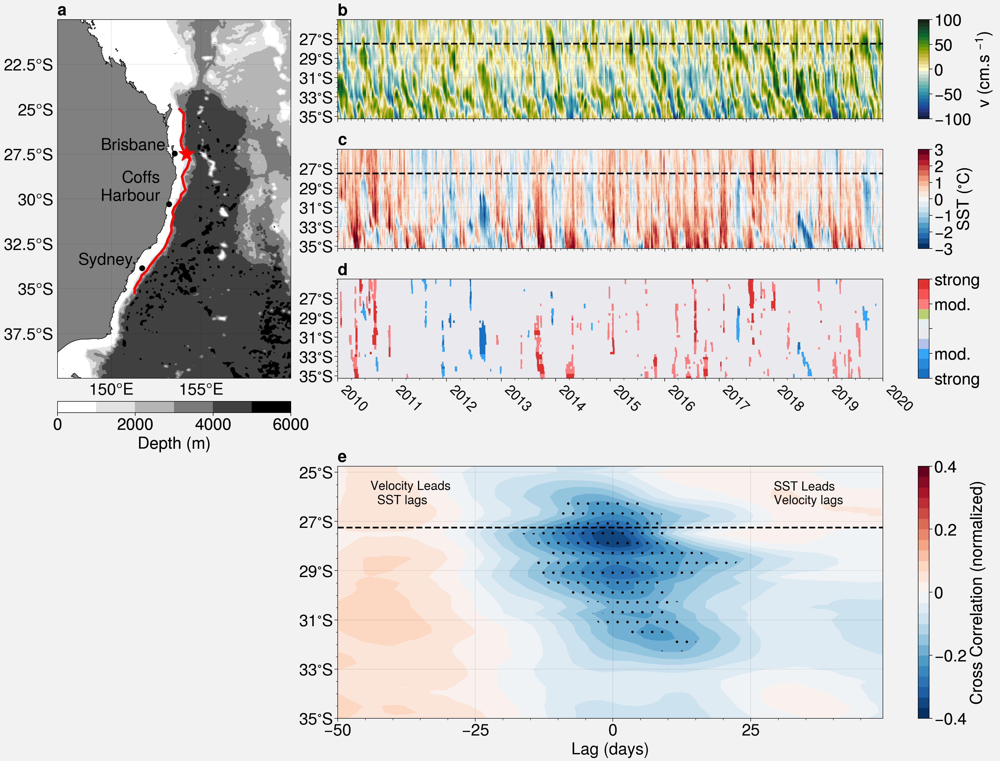

In [90]:
from scipy import signal as scipy_signal
from scipy import stats  as scipy_stats
import proplot
from matplotlib.patches import ConnectionPatch
import matplotlib.colors as mcolors
import pandas

norm = mcolors.DivergingNorm(vmin=-2, vmax = 2, vcenter=0)
#lags = correlation_lags(nT,nT,mode="same")
#downstream_lats = SST_anom_on_bathy_contours[0]['lat'].values



upstream_lat = -27.4
MAX_LAG = 100

latitudes = v_current_anom_bathy_contours[0]['LATITUDE'].values
idx_upstream = np.nonzero(latitudes>=upstream_lat)[0][0]
v_upstream = scipy_signal.detrend(v_current_anom_bathy_contours[0].sel(TIME=slice(start_date,end_date))[:,idx_upstream].values)
nT_slice = v_upstream.size
#lags = np.arange(-nT+1, nT)

city_font_size = 20
start_date = pandas.Timestamp(2010, 1, 1)
end_date   = pandas.Timestamp(2020, 1, 1)
north_lim = -27.0
south_lim = -34
TARGET_LATITUDE = -27.5




proplot.rc['land.color'] = 'grey'

proplot.rc['text.labelsize'] = 20
proplot.rc['text.titlesize'] = 25
proplot.rc['abc.size'] = 20
proplot.rc['abc.style'] = 'a'

proplot.rc.reso = 'hi'  # use higher res for zoomed in geographic features
proj = proplot.Proj('cyl', basemap=False)

lon_min = 147
lon_max = 160
lat_max = -20
lat_min = -40.0


image_array = [
    [1, 2, 2],
    [1, 3, 3],
    [1, 4, 4],
    [0, 5, 5],
    [0, 5, 5,]]

n_quiver_points = 2
fig, axs = proplot.subplots(np.asarray(image_array), proj={1:proj},axwidth='10cm',share=False) #,sharey=0)
axs.format(facecolor='grey',abc=True) #, color='grey')


image_counter = 0


cs_bathy = axs[image_counter].contourf(bathymetry_dataset['x'], bathymetry_dataset['y'], -1*bathymetry_dataset['z'],
                        levels=np.arange(0,6001,1000),cmap=plt.cm.Greys)
cbar = axs[image_counter].colorbar(cs_bathy,label='Depth (m)',loc='b',ticks=np.arange(0,6001,2000))

idx_target_lat = np.nonzero(SST_anom_on_bathy_contours[0]['lat'].values>=TARGET_LATITUDE)[0][0]

axs[image_counter].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='red',linewidth=3.0)
axs[image_counter].plot(SST_anom_on_bathy_contours[0]['lon'][idx_target_lat],SST_anom_on_bathy_contours[0]['lat'][idx_target_lat],'*',markersize=20,color='red')

axs[image_counter].format(
    lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max),
    labels=True,land=True,coast=True,lonlines=np.arange(140,161,5))

axs[image_counter].plot(brisbane_lon,brisbane_lat,'o',color='k')
axs[image_counter].plot(sydney_lon,sydney_lat,'o',color='k')
axs[image_counter].plot(coffs_lon,coffs_lat,'o',color='k')

transform = ccrs.PlateCarree()._as_mpl_transform(axs[image_counter])

axs[image_counter].annotate('Brisbane', xy=(brisbane_lon-0.5,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
axs[image_counter].annotate('Sydney', xy=(sydney_lon-0.5,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
axs[image_counter].annotate('Coffs\n Harbour', xy=(coffs_lon-0.5,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)


axs[image_counter].format(
    lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max),
    labels=True,land=True,coast=True,lonlines=np.arange(140,161,5))

axs[image_counter].plot(brisbane_lon,brisbane_lat,'o',color='k')
axs[image_counter].plot(sydney_lon,sydney_lat,'o',color='k')
axs[image_counter].plot(coffs_lon,coffs_lat,'o',color='k')


image_counter = image_counter+1

cs_current = axs[image_counter].contourf(pandas.to_datetime(v_current_anom_bathy_contours[0]['TIME'].sel(TIME=slice(start_date,end_date)).values),
                                         v_current_anom_bathy_contours[0]['LATITUDE'].values,
                                         100*v_current_anom_bathy_contours[0].sel(TIME=slice(start_date,end_date)).values.T,
                                        levels=100*np.linspace(-1.,1.,30),cmap=cmocean.cm.delta)

axs[image_counter].plot(pandas.to_datetime(v_current_anom_bathy_contours[0]['TIME'].sel(TIME=slice(start_date,end_date)).values),
            TARGET_LATITUDE*np.ones(len(pandas.to_datetime(v_current_anom_bathy_contours[0]['TIME'].sel(TIME=slice(start_date,end_date)).values))),'k--',linewidth=2.0)
axs[image_counter].colorbar(cs_current, label=r'v (cm.s $^{-1}$)',loc='r',ticks=[-100,-50,0,50,100])
axs[image_counter].grid(True)
lat_ticks = []
for i_tick in np.arange(int(v_current_anom_bathy_contours[0]['LATITUDE'].min()),int(v_current_anom_bathy_contours[0]['LATITUDE'].max()),2):
    
    lat_ticks.append(str(int(-i_tick)) + '$^{\circ}S$')

axs[image_counter].set_yticks(np.arange(int(v_current_anom_bathy_contours[0]['LATITUDE'].min()),int(v_current_anom_bathy_contours[0]['LATITUDE'].max()),2))
axs[image_counter].set_yticklabels(lat_ticks)
axs[image_counter].set_xticks(pandas.date_range(start_date,end_date+np.timedelta64(1,'M'),freq='6MS'))
axs[image_counter].set_xticklabels([])


idx_time_start = np.nonzero(pandas.to_datetime(SST_anom_on_bathy_contours[0]['time'].values)>=start_date)[0][0]
idx_time_end   = np.nonzero(pandas.to_datetime(SST_anom_on_bathy_contours[0]['time'].values)>=end_date)[0][0]+1

image_counter = image_counter+1

SST_anom_on_bathy_contours_detrend = scipy_signal.detrend(SST_anom_on_bathy_contours[0].sel(time=slice(start_date,end_date)).values, axis=0) 

cs_SST = axs[image_counter].contourf(pandas.to_datetime(SST_anom_on_bathy_contours[0]['time'].sel(time=slice(start_date,end_date)).values),
                                     SST_anom_on_bathy_contours[0]['lat'].values,
                                     SST_anom_on_bathy_contours_detrend.T,
                                     levels=np.linspace(-3,3,20),cmap=plt.cm.RdBu_r)
axs[image_counter].grid(True)
axs[image_counter].colorbar(cs_SST, label='SST ($^{\circ}$C)',loc='r',ticks=[-3,-2,-1,0,1,2,3])
axs[image_counter].plot(pandas.to_datetime(v_current_anom_bathy_contours[0]['TIME'].sel(TIME=slice(start_date,end_date)).values),
                        TARGET_LATITUDE*np.ones(len(pandas.to_datetime(v_current_anom_bathy_contours[0]['TIME'].sel(TIME=slice(start_date,end_date)).values))),'k--',linewidth=2.0)

axs[image_counter].set_yticks(np.arange(south_lim,north_lim,2))

axs[image_counter].set_yticks(np.arange(int(v_current_anom_bathy_contours[0]['LATITUDE'].min()),int(v_current_anom_bathy_contours[0]['LATITUDE'].max()),2))
axs[image_counter].set_yticklabels(lat_ticks)
axs[image_counter].set_xticks(pandas.date_range(start_date,end_date+np.timedelta64(1,'M'),freq='6MS'))
axs[image_counter].set_xticklabels([])



image_counter = image_counter+1


cmap_MHW = proplot.Colormap(('blue8', 'blue4','white','red4','red8'), name='Heatwave')


cs_MWH = axs[image_counter].pcolormesh(pandas.to_datetime(SST_anom_on_bathy_contours[0]['time'].sel(time=slice(start_date,end_date)).values),SST_on_bathy_contours[0]['lat'].values, 
                                                          MHW_MCS_hovmollers[idx_time_start:idx_time_end,:].T,cmap=cmap_MHW)
cbar_MHW = axs[image_counter].colorbar(cs_MWH,loc='r',ticks=[-2,-1,0,1,2])
cbar_MHW.ax.set_yticklabels(['strong','mod.','','mod.','strong'])

axs[image_counter].set_xticks(pandas.date_range(start_date,end_date+np.timedelta64(1,'M'),freq='12MS'))
axs[image_counter].format(xrotation=-45) 
axs[image_counter].set_xticklabels(pandas.date_range(start_date,end_date+np.timedelta64(1,'M'),freq='12MS').strftime("%Y"),fontsize=17)

axs[image_counter].set_yticks(np.arange(int(v_current_anom_bathy_contours[0]['LATITUDE'].min()),int(v_current_anom_bathy_contours[0]['LATITUDE'].max()),2))
axs[image_counter].set_yticklabels(lat_ticks)


        
#axs[image_counter].set_ylim([south_lim,north_lim])
#axs[2].set_ylim([south_lim,north_lim])





image_counter =  image_counter+1

cs_cross_corr = axs[image_counter].contourf(lags[int(lags.size/2)-50:int(lags.size/2)+50],downstream_lats,
                                            crosscorr_SST_v_upstream[:,int(lags.size/2)-50:int(lags.size/2)+50],levels=np.linspace(-0.4,0.4,25),cmap='RdBu_r')

axs[image_counter].contourf(lags[int(lags.size/2)-50:int(lags.size/2)+50],downstream_lats,crosscorr_SST_v_upstream[:,int(lags.size/2)-50:int(lags.size/2)+50]<cross_corr_AR_percentile[0,:,int(lags.size/2)-50:int(lags.size/2)+50],
                             levels=[0.9,1.1],hatches=['.','//'],colors='none')

axs[image_counter].colorbar(cs_cross_corr, label=r'Cross Correlation (normalized)',loc='r',ticks=[-0.4,-0.2,0,0.2,0.4])

lat_ticks = []
for i_tick in np.arange(downstream_lats[0],downstream_lats[-1],2):
    
    lat_ticks.append(str(int(-i_tick)) + '$^{\circ}S$')
axs[image_counter].set_yticks( np.arange(downstream_lats[0],downstream_lats[-1],2))
axs[image_counter].set_yticklabels(lat_ticks)
axs[image_counter].set_xticks(np.arange(-50,51,25))
axs[image_counter].set_xlabel('Lag (days)') 


axs[image_counter].plot(lags[int(lags.size/2)-50:int(lags.size/2)+50],
                       TARGET_LATITUDE*np.ones(len(lags[int(lags.size/2)-50:int(lags.size/2)+50])),'k--',linewidth=2.0)
axs[image_counter].annotate('SST Leads\nVelocity lags', xy=(0.8, 0.85), xycoords="axes fraction",fontsize=15)
axs[image_counter].annotate('Velocity Leads\n  SST lags', xy=(0.06,  0.85), xycoords="axes fraction",fontsize=15)


figure_output_path = 'Figures_Update'
#figure_file_name = 'V_SST_Hovmoller_with_MHW_and_correlation__streamplot_detrend' 
figure_file_name = 'V_SST_Hovmoller_with_MHW_and_correlation' 

fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=400,bbox='tight', transparent=True)
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight', transparent=True)



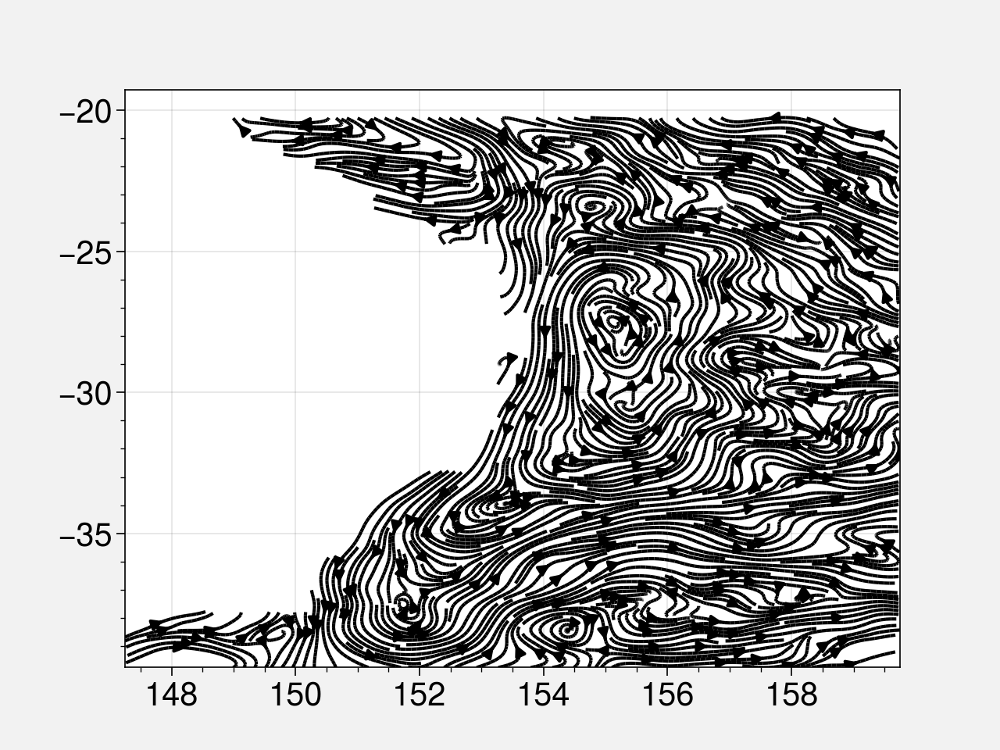

In [35]:
plt.streamplot(mean_u_current_drifter_region['lon'].values,mean_u_current_drifter_region['lat'].values, 
                              mean_u_current_drifter_region.values, mean_v_current_drifter_region.values, density=5,color='black')

In [91]:
brisbane_lat = -27.470125
brisbane_lon = 153.021072
sydney_lat   = -33.865143
sydney_lon   = 151.209900
coffs_lat   = -30.296276 
coffs_lon   = 153.214136 

#LOCATION = 'COFFS_HARBOUR'
#LOCATION = 'BRISBANE'
LOCATION = 'SYDNEY'


if LOCATION=='COFFS_HARBOUR':
    idx_loc = np.nonzero(SST_on_bathy_contours[0]['lat'].values>=coffs_lat)[0][0]
elif LOCATION == 'BRISBANE':
    idx_loc = np.nonzero(SST_on_bathy_contours[0]['lat'].values>=brisbane_lat)[0][0]    
elif LOCATION == 'SYDNEY':
    idx_loc = np.nonzero(SST_on_bathy_contours[0]['lat'].values>=sydney_lat)[0][0]
    
lon_point = SST_on_bathy_contours[0]['lon'][idx_loc]
lat_point = SST_on_bathy_contours[0]['lat'][idx_loc]



SST_time_series_heat_wave = SST_dataset['sea_surface_temperature'].sel(lon=lon_point.values,lat=lat_point.values,method='nearest') 

marine_heat_waves, clim_marine_heat_waves   = mhw.detect(SST_ordinal_time,SST_time_series_heat_wave.squeeze().values,coldSpells=False,maxGap=3,minDuration=10)
marine_cold_spells, clim_marine_cold_spells = mhw.detect(SST_ordinal_time,SST_time_series_heat_wave.squeeze().values,coldSpells=True,maxGap=3,minDuration=10)

In [119]:
import event_analysis
import warnings
warnings.filterwarnings('ignore')


shift_increments   = 5
n_shifts = 20

marine_heat_waves_peak_time = []
for i_event in range(len(marine_heat_waves['date_peak'])):
    marine_heat_waves_peak_time.append(np.datetime64(marine_heat_waves['date_peak'][i_event]) )
marine_heat_waves_peak_time = np.asarray(marine_heat_waves_peak_time)


marine_heat_waves_shifted_composite_SST = event_analysis.simple_shifted_event_composite_average(marine_heat_waves_peak_time,SST_anom_dataset['sea_surface_temperature'].squeeze(),n_shifts,shift_increments,
                                                                                                sensor_dims=['lat', 'lon'],sample_dim='time')

marine_heat_waves_shifted_composite_GSLA = event_analysis.simple_shifted_event_composite_average(marine_heat_waves_peak_time,GSLA_anom,n_shifts,shift_increments,
                                                                                                sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME')
marine_heat_waves_shifted_composite_U = event_analysis.simple_shifted_event_composite_average(marine_heat_waves_peak_time,u_current,n_shifts,shift_increments,
                                                                                                sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME')
marine_heat_waves_shifted_composite_V = event_analysis.simple_shifted_event_composite_average(marine_heat_waves_peak_time,v_current,n_shifts,shift_increments,
                                                                                                sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME')

marine_heat_waves_shifted_composite_U_anom = event_analysis.simple_shifted_event_composite_average(marine_heat_waves_peak_time,u_current_anom,n_shifts,shift_increments,
                                                                                                sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME')
marine_heat_waves_shifted_composite_V_anom = event_analysis.simple_shifted_event_composite_average(marine_heat_waves_peak_time,v_current_anom,n_shifts,shift_increments,
                                                                                                sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME')



marine_heat_waves_shifted_composite_JRA_sfc_temp = event_analysis.simple_shifted_event_composite_average(
                                                               marine_heat_waves_peak_time,JRA_srf_temperature_dataset['TMP_GDS0_HTGL'].squeeze(),n_shifts,shift_increments,
                                                               sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time')
    
marine_heat_waves_shifted_composite_JRA_slp = event_analysis.simple_shifted_event_composite_average(
                                                               marine_heat_waves_peak_time,JRA_srf_temperature_dataset['PRMSL_GDS0_MSL'].squeeze(),n_shifts,shift_increments,
                                                               sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time')
    


In [ ]:
JRA_srf_temperature_dataset

In [120]:
N_monte_carlo=1000
marine_heat_waves_composite_GSLA_null_hypothesis = event_analysis.random_sampling_for_quantiles(
                                       marine_heat_waves_shifted_composite_GSLA['n_events_in_composite'].values,GSLA_anom,sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME',
                                       N_monte_carlo=N_monte_carlo)

marine_heat_waves_composite_v_current_null_hypothesis = event_analysis.random_sampling_for_quantiles(
                                       marine_heat_waves_shifted_composite_V_anom['n_events_in_composite'].values,v_current_anom,sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME',
                                       N_monte_carlo=N_monte_carlo)



marine_heat_waves_composite_SST_null_hypothesis =  event_analysis.random_sampling_for_quantiles(
                                       marine_heat_waves_shifted_composite_SST['n_events_in_composite'].values,SST_anom_dataset['sea_surface_temperature'].squeeze(),sensor_dims=['lat', 'lon'],sample_dim='time',
                                       N_monte_carlo=N_monte_carlo)

marine_heat_waves_composite_sfc_temp_null_hypothesis =  event_analysis.random_sampling_for_quantiles(
                                       marine_heat_waves_shifted_composite_JRA_sfc_temp['n_events_in_composite'].values,JRA_srf_temperature_dataset['TMP_GDS0_HTGL'].squeeze(),
                                       sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time',N_monte_carlo=N_monte_carlo)


#marine_heat_waves_composite_GSLA_null_hypothesis.to_netcdf(os.path.join('./',marine_heat_waves_composite_GSLA_null_hypothesis_' + LOCATION + '_data_source_' + SST_data_source + '.detrended.nc'))
#marine_heat_waves_composite_SST_null_hypothesis.to_netcdf(os.path.join('./','marine_heat_waves_composite_SST_null_hypothesis_'+ LOCATION +'_data_source_' + SST_data_source +'.detrended.nc'))


In [39]:
import event_analysis
import warnings
warnings.filterwarnings('ignore')


shift_increments   = 5
n_shifts = 20

marine_cold_spell_peak_time = []
for i_event in range(len(marine_cold_spells['date_peak'])):
    marine_cold_spell_peak_time.append(np.datetime64(marine_cold_spells['date_peak'][i_event]) )
marine_cold_spell_peak_time = np.asarray(marine_cold_spell_peak_time)


marine_cold_spell_shifted_composite_SST = event_analysis.simple_shifted_event_composite_average(marine_cold_spell_peak_time,SST_anom_dataset['sea_surface_temperature'].squeeze(),n_shifts,shift_increments,
                                                                                                sensor_dims=['lat', 'lon'],sample_dim='time')

marine_cold_spell_shifted_composite_GSLA = event_analysis.simple_shifted_event_composite_average(marine_cold_spell_peak_time,GSLA_anom,n_shifts,shift_increments,
                                                                                                sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME')
marine_cold_spell_shifted_composite_U = event_analysis.simple_shifted_event_composite_average(marine_cold_spell_peak_time,u_current_anom,n_shifts,shift_increments,
                                                                                                sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME')
marine_cold_spell_shifted_composite_V = event_analysis.simple_shifted_event_composite_average(marine_cold_spell_peak_time,v_current_anom,n_shifts,shift_increments,
                                                                                                sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME')

marine_cold_spell_shifted_composite_U_anom = event_analysis.simple_shifted_event_composite_average(marine_cold_spell_peak_time,u_current_anom,n_shifts,shift_increments,
                                                                                                sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME')
marine_cold_spell_shifted_composite_V_anom = event_analysis.simple_shifted_event_composite_average(marine_cold_spell_peak_time,v_current_anom,n_shifts,shift_increments,
                                                                                                sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME')



In [100]:
n_events_MHW = marine_heat_waves['n_events']
for i_event in range(0,n_events_MHW):

    print(i_event,marine_heat_waves['category'][i_event], marine_heat_waves['duration'][i_event])
    
    

0 Moderate 14
1 Strong 24
2 Strong 12
3 Moderate 14
4 Moderate 12
5 Moderate 25
6 Moderate 11
7 Strong 14
8 Moderate 20
9 Moderate 25
10 Moderate 10
11 Strong 26
12 Moderate 16
13 Moderate 34
14 Moderate 11
15 Moderate 36
16 Strong 12
17 Moderate 10
18 Moderate 13
19 Moderate 11
20 Moderate 29
21 Strong 15
22 Moderate 18
23 Moderate 42
24 Moderate 12


In [ ]:
JRA_srf_temperature_dataset

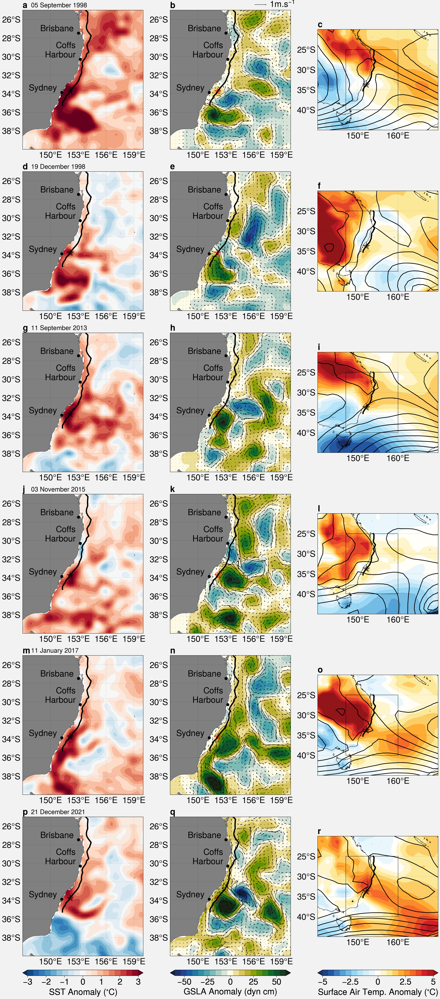

In [103]:
import proplot
import matplotlib.patches as mpatches

from matplotlib.patches import ConnectionPatch

proplot.rc['land.color'] = 'grey'
proplot.rc['text.labelsize'] = 20
proplot.rc['text.titlesize'] = 25
proplot.rc['abc.size'] = 20
proplot.rc['abc.style'] = 'a'
city_font_size = 20

lon_min = 147
lon_max = 160
lat_max = -25
lat_min = -40.0



atmos_lon_min = 140
atmos_lon_max = 170
atmos_lat_max = -20
atmos_lat_min = -45.0


events_to_plot = [1,2,7,11,16,21] #strong events SYDNEY

#events_to_plot = [0,2,5,8,10,16] #strong events COFFS

#events_to_plot = [0,4,8,12,16,20] #Random events


proplot.rc.reso = 'hi'  # use higher res for zoomed in geographic features
proj = proplot.Proj('cyl', basemap=False)

n_quiver_points = 2
fig, axs = proplot.subplots(nrows=len(events_to_plot), ncols=3,proj=proj,axwidth='10cm',share=True)
axs.format(facecolor='white',abc=True,coast=True) #, color='grey')

METERS_TO_CENTIMETERS = 100.0

for i_event in range(0,len(events_to_plot)):
    
    event_index = events_to_plot[i_event]
    
    SST_to_plot       = SST_anom_dataset['sea_surface_temperature'].sel( time=marine_heat_waves_peak_time[event_index],method='nearest').squeeze()
    GSLA_to_plot      = GSLA_anom.sel(                                   TIME=marine_heat_waves_peak_time[event_index],method='nearest').squeeze()
    surf_temp_to_plot = JRA_srf_temperature_dataset['TMP_GDS0_HTGL'].sel(time=marine_heat_waves_peak_time[event_index],method='nearest').squeeze()
    slp_to_plot       = JRA_srf_temperature_dataset['PRMSL_GDS0_MSL'].sel(time=marine_heat_waves_peak_time[event_index],method='nearest').squeeze()

    
    
    u_to_plot = u_current_anom.sel(TIME=marine_heat_waves_peak_time[event_index],method='nearest').squeeze()
    v_to_plot = v_current_anom.sel(TIME=marine_heat_waves_peak_time[event_index],method='nearest').squeeze()
    
    
    cs_SST = axs[i_event,0].contourf(SST_to_plot['lon'],SST_to_plot['lat'],SST_to_plot.values,levels=np.linspace(-3,3,20),cmap='RdBu_r',extend='both')
    axs[i_event,0].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=True,land=True,lonlines=3)
    axs[i_event,0].plot(lon_point,lat_point,'k*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)
    axs[i_event,0].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    transform = ccrs.PlateCarree()._as_mpl_transform(axs[i_event,0])

    axs[i_event,0].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[i_event,0].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[i_event,0].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[i_event,0].annotate('Brisbane', xy=(brisbane_lon-0.5,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[i_event,0].annotate('Sydney', xy=(sydney_lon-0.5,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[i_event,0].annotate('Coffs\n Harbour', xy=(coffs_lon-0.5,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    
    peak_time = marine_heat_waves_peak_time[event_index]
    peak_time_string = peak_time.item().strftime('%d %B %Y')
    axs[i_event,0].annotate(peak_time_string, xy=(0.07, 1.02), xycoords="axes fraction",fontsize=15)
    
    
    cs_GSLA = axs[i_event,1].contourf(GSLA_to_plot['LONGITUDE'],GSLA_to_plot['LATITUDE'],METERS_TO_CENTIMETERS * GSLA_to_plot.values,levels=np.linspace(-60,60,20),cmap='Delta',extend='both')
    
    skip_step = 2
    skip = dict(LONGITUDE=slice(None,None,skip_step),LATITUDE=slice(None,None,skip_step))

    
    quiver_out = axs[i_event,1].quiver(GSLA_to_plot['LONGITUDE'][::skip_step],GSLA_to_plot['LATITUDE'][::skip_step],u_to_plot[skip],v_to_plot[skip],scale=10)
    if i_event ==0:
        qk = axs[i_event,1].quiverkey(quiver_out, 0.8, 1.04, 1, r'1m.s$^{-1}$', labelpos='E',
                   coordinates='axes',fontproperties={'size':20})

    
    axs[i_event,1].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=True,land=True,lonlines=3)
    axs[i_event,1].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)
    axs[i_event,1].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    transform = ccrs.PlateCarree()._as_mpl_transform(axs[i_event,1])

    
    axs[i_event,1].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[i_event,1].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[i_event,1].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[i_event,1].annotate('Brisbane', xy=(brisbane_lon-0.5,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[i_event,1].annotate('Sydney', xy=(sydney_lon-0.5,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[i_event,1].annotate('Coffs\n Harbour', xy=(coffs_lon-0.5,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    atmos_lon_min = 140
    atmos_lon_max = 170
    atmos_lat_max = -20
    atmos_lat_min = -45.0
    
    cs_surf_temp = axs[i_event,2].contourf(surf_temp_to_plot['g0_lon_2'],surf_temp_to_plot['g0_lat_1'],surf_temp_to_plot.values,levels=np.linspace(-5,5,20),cmap='HotCold_r',extend='both')

    clines = axs[i_event,2].contour(slp_to_plot['g0_lon_2'],slp_to_plot['g0_lat_1'],0.01*slp_to_plot.values,levels=np.arange(900,1100.01,2.5),colors='black',extend='both')
    axs[i_event,2].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    
    axs[i_event,2].format(lonlim=(atmos_lon_min, atmos_lon_max), latlim=(atmos_lat_max, atmos_lat_min), labels=True,land=False,lonlines=np.arange(100,180,10))
    axs[i_event,2].yaxis.tick_right()
    axs[i_event,2].plot(lon_point,lat_point,'k*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)
    axs[i_event,2].add_patch(mpatches.Rectangle(xy=[lon_min, lat_min], width=lon_max-lon_min, height=lat_max-lat_min,
                                facecolor='none', edgecolor='k',
                                transform=ccrs.PlateCarree()))

    
fig.colorbar(cs_SST, label=r'SST Anomaly ($^{\circ}$C)',loc='b',ticks=np.arange(-3,3.01,1),col=[1])
fig.colorbar(cs_GSLA, label=r'GSLA Anomaly (dyn cm)',loc='b',ticks=np.arange(-50,50.01,25),col=[2])
fig.colorbar(cs_surf_temp, label=r'Surface Air Temp. Anomaly ($^{\circ}$C)',loc='b',ticks=np.arange(-5,5.01,2.5),col=[3])


figure_output_path = 'Figures_Update'
#figure_file_name = 'MHW_case_studies_random_selection' + LOCATION
figure_file_name = 'MHW_case_studies_strong_events_' + LOCATION

fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=400,bbox='tight', transparent=True)
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight', transparent=True)


In [63]:
JRA_srf_temperature_bathy_contours[0]

<xarray.DataArray 'TMP_GDS0_HTGL' (time: 10592, z: 42)>
array([[-0.27422189, -0.28898299, -0.35668519, ..., -0.46878223,
        -0.4912644 , -0.42096622],
       [ 0.42006903,  0.28375748,  0.22653507, ..., -1.46042676,
        -1.49707747, -1.49080595],
       [-0.96755455, -0.78418837, -0.58911375, ..., -1.66096313,
        -1.74743108, -1.92778701],
       ...,
       [-1.08711122, -1.15247394, -1.38428614, ..., -0.75616919,
        -0.59921053, -0.52903586],
       [-0.1287699 , -0.23053734, -0.41288474, ..., -1.35810083,
        -1.29480481, -1.22826639],
       [ 2.5931985 ,  2.49652464,  2.20749538, ..., -0.07692065,
         0.02063082,  0.0555682 ]])
Coordinates:
  * time      (time) datetime64[ns] 1993-01-01 1993-01-02 ... 2021-12-31
    g0_lon_2  (z) float64 151.3 151.3 151.4 151.6 ... 154.0 154.0 154.0 153.8
    g0_lat_1  (z) float64 -35.25 -35.0 -34.75 -34.5 ... -25.5 -25.25 -25.0
Dimensions without coordinates: z
Attributes:
    long_name:                Temperature
    units:                    K
    forecast_time_units:      hours
    forecast_time:            0
    level:                    2
    parameter_number:         11
    parameter_table_version:  200
    gds_grid_type:            0
    level_indicator:          105
    center:                   Japanese Meteorological Agency - Tokyo (RSMC)
    sub_center:               241

In [68]:
marine_heat_waves.keys()

dict_keys(['time_start', 'time_end', 'time_peak', 'date_start', 'date_end', 'date_peak', 'index_start', 'index_end', 'index_peak', 'duration', 'duration_moderate', 'duration_strong', 'duration_severe', 'duration_extreme', 'intensity_max', 'intensity_mean', 'intensity_var', 'intensity_cumulative', 'intensity_max_relThresh', 'intensity_mean_relThresh', 'intensity_var_relThresh', 'intensity_cumulative_relThresh', 'intensity_max_abs', 'intensity_mean_abs', 'intensity_var_abs', 'intensity_cumulative_abs', 'category', 'rate_onset', 'rate_decline', 'n_events'])

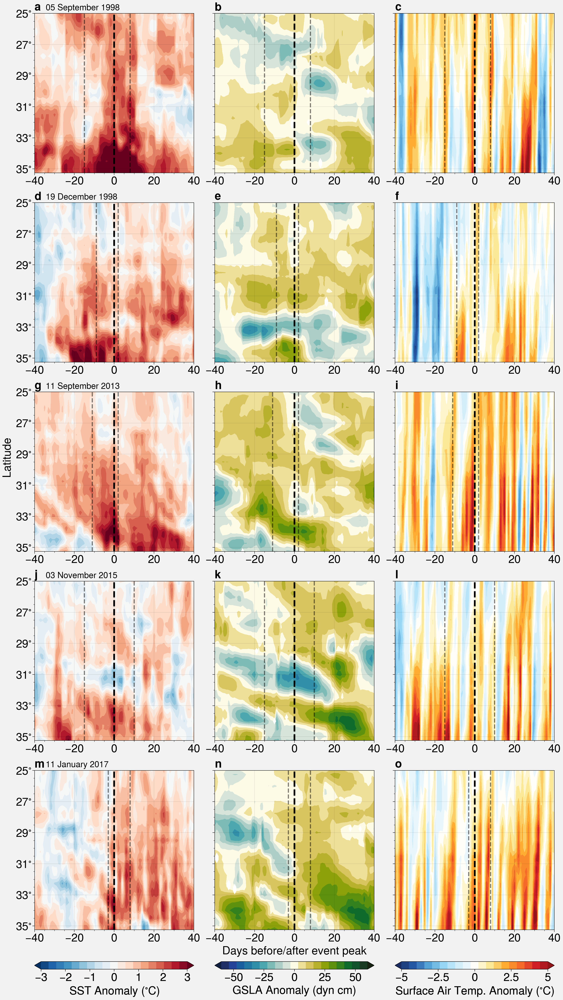

In [105]:
import proplot
import matplotlib.patches as mpatches

from matplotlib.patches import ConnectionPatch
from matplotlib.ticker import EngFormatter, StrMethodFormatter

proplot.rc['land.color'] = 'grey'
proplot.rc['text.labelsize'] = 20
proplot.rc['text.titlesize'] = 25
proplot.rc['abc.size'] = 20
proplot.rc['abc.style'] = 'a'
city_font_size = 20

lon_min = 147
lon_max = 160
lat_max = -25
lat_min = -40.0



atmos_lon_min = 140
atmos_lon_max = 170
atmos_lat_max = -20
atmos_lat_min = -45.0


#events_to_plot = [0,2,5,8,10,16] #Strong events COFFS
events_to_plot = [1,2,7,11,16] #,21] #strong events SYDNEY

#events_to_plot = [0,4,8,12,16,20]


proplot.rc.reso = 'hi'  # use higher res for zoomed in geographic features
proj = proplot.Proj('cyl', basemap=False)

n_quiver_points = 2
fig, axs = proplot.subplots(nrows=len(events_to_plot), ncols=3,proj=None,axwidth='10cm',share=False)
axs.format(facecolor='white',abc=True,coast=True)

METERS_TO_CENTIMETERS = 100.0

days_before_event_to_plot = 40

y_ticklabels = []
for i_tick in np.arange(-35,-24.9,2):
    y_ticklabels.append(str(np.abs(int(i_tick))) + r'$^{\circ}$' )
    
for i_event in range(0,len(events_to_plot)):
    
    event_index = events_to_plot[i_event]
    
    peak_time  = pandas.to_datetime(marine_heat_waves['date_peak'][event_index])
    start_date = pandas.to_datetime(marine_heat_waves['date_start'][event_index])
    end_date   = pandas.to_datetime(marine_heat_waves['date_end'][event_index])

    start_time = (start_date- peak_time) / np.timedelta64(1,'D')
    end_time   = (end_date- peak_time) / np.timedelta64(1,'D')

    
    SST_to_plot = SST_anom_on_bathy_contours[0].sel(time=slice(marine_heat_waves_peak_time[event_index]-np.timedelta64(days_before_event_to_plot,'D'),
                                                               marine_heat_waves_peak_time[event_index]+np.timedelta64(days_before_event_to_plot,'D') ) )

    GSLA_to_plot = GSLA_anom_bathy_contours[0].sel(TIME=slice(marine_heat_waves_peak_time[event_index]-np.timedelta64(days_before_event_to_plot,'D'),
                                                               marine_heat_waves_peak_time[event_index]+np.timedelta64(days_before_event_to_plot,'D') ))
    
    v_to_plot = v_current_anom_bathy_contours[0].sel(TIME=slice(marine_heat_waves_peak_time[event_index]-np.timedelta64(days_before_event_to_plot,'D'),
                                                               marine_heat_waves_peak_time[event_index]+np.timedelta64(days_before_event_to_plot,'D') ) )

    surf_temp_to_plot = JRA_srf_temperature_bathy_contours[0].sel(time=slice(marine_heat_waves_peak_time[event_index]-np.timedelta64(days_before_event_to_plot,'D'),
                                                                       marine_heat_waves_peak_time[event_index]+np.timedelta64(days_before_event_to_plot,'D') ) )
    
    time_to_plot = np.arange(-days_before_event_to_plot,days_before_event_to_plot+1,1)
    
    cs_SST = axs[i_event,0].contourf(time_to_plot,SST_to_plot['lat'].values,SST_to_plot.T.values,
                                     levels=np.linspace(-3,3,20),cmap='RdBu_r',extend='both')
    
    axs[i_event,0].set_yticks(np.arange(-35,-24.9,2))
    axs[i_event,0].set_yticklabels(y_ticklabels)
    axs[i_event,0].axvline(x=0,linewidth=3.0,linestyle='--',color='black')
    axs[i_event,0].axvline(x=start_time,linewidth=2.0,linestyle='--',color='black',alpha=0.5)
    axs[i_event,0].axvline(x=end_time,linewidth=2.0,linestyle='--',color='black',alpha=0.5)
   
    
    peak_time = marine_heat_waves_peak_time[event_index]
    peak_time_string = peak_time.item().strftime('%d %B %Y')
    axs[i_event,0].annotate(peak_time_string, xy=(0.07, 1.02), xycoords="axes fraction",fontsize=15)
    
    
    cs_GSLA = axs[i_event,1].contourf(time_to_plot,GSLA_to_plot['LATITUDE'].values,METERS_TO_CENTIMETERS * GSLA_to_plot.T.values,
                                      levels=np.linspace(-60,60,20),cmap='Delta',extend='both')
    axs[i_event,1].set_yticks(np.arange(-35,-24.9,2))
    axs[i_event,1].set_yticklabels([])
    
    axs[i_event,1].axvline(x=0,linewidth=3.0,linestyle='--',color='black')
    axs[i_event,1].axvline(x=start_time,linewidth=2.0,linestyle='--',color='black',alpha=0.5)
    axs[i_event,1].axvline(x=end_time,linewidth=2.0,linestyle='--',color='black',alpha=0.5)
    if i_event == 2:
        axs[i_event,0].set_ylabel('         Latitude')
    
    
    
    cs_surf_temp = axs[i_event,2].contourf(time_to_plot,surf_temp_to_plot['g0_lat_1'].values,
                                           surf_temp_to_plot.T.values,levels=np.linspace(-5,5,20),cmap='HotCold_r',extend='both')
    
    axs[i_event,2].set_yticks(np.arange(-35,-24.9,2))
    axs[i_event,2].set_yticklabels([])
    
    
    axs[i_event,2].axvline(x=0,linewidth=3.0,linestyle='--',color='black')
    axs[i_event,2].axvline(x=start_time,linewidth=2.0,linestyle='--',color='black',alpha=0.5)
    axs[i_event,2].axvline(x=end_time,linewidth=2.0,linestyle='--',color='black',alpha=0.5)

    if i_event == len(events_to_plot)-1:
        axs[i_event,1].set_xlabel('Days before/after event peak')

    #
    #clines = axs[i_event,2].contour(slp_to_plot['g0_lon_2'],slp_to_plot['g0_lat_1'],0.01*slp_to_plot.values,levels=np.arange(900,1100.01,2.5),colors='black',extend='both')
    #axs[i_event,2].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    
    #axs[i_event,2].format(lonlim=(atmos_lon_min, atmos_lon_max), latlim=(atmos_lat_max, atmos_lat_min), labels=True,land=False,lonlines=np.arange(100,180,10))
    #axs[i_event,2].yaxis.tick_right()
    #axs[i_event,2].plot(lon_point,lat_point,'k*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)
    #axs[i_event,2].add_patch(mpatches.Rectangle(xy=[lon_min, lat_min], width=lon_max-lon_min, height=lat_max-lat_min,
    #                            facecolor='none', edgecolor='k',
    #                            transform=ccrs.PlateCarree()))

    
fig.colorbar(cs_SST, label=r'SST Anomaly ($^{\circ}$C)',loc='b',ticks=np.arange(-3,3.01,1),col=[1])
fig.colorbar(cs_GSLA, label=r'GSLA Anomaly (dyn cm)',loc='b',ticks=np.arange(-50,50.01,25),col=[2])
fig.colorbar(cs_surf_temp, label=r'Surface Air Temp. Anomaly ($^{\circ}$C)',loc='b',ticks=np.arange(-5,5.01,2.5),col=[3])


figure_output_path = 'Figures_Update'
#figure_file_name = 'MHW_hovmoller_case_studies_random_selection_' + LOCATION
figure_file_name = 'MHW_hovmoller_case_studies_strong_events_' + LOCATION

fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=400,bbox='tight', transparent=True)
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight', transparent=True)


In [108]:
months_for_season  = [[12,1,2], [3,4,5], [6,7,8], [9,10,11] ]
mhw_months = marine_heat_waves_peak_time.astype('datetime64[M]').astype(int) % 12 + 1



seasonal_composite_SST       = []
seasonal_composite_GSLA      = []
seasonal_composite_U_anom    = []
seasonal_composite_V_anom    = []
seasonal_composite_surf_temp = []
seasonal_composite_slp       = []


seasonal_null_hypothesis_sst = []


for i_season in months_for_season:
    
    print(i_season)
    mhw_dates_for_season = []

    for i_event in range(0,len(mhw_months)):
        if mhw_months[i_event] in i_season:
            mhw_dates_for_season.append(marine_heat_waves_peak_time[i_event])
    
    mhw_dates_for_season = np.asarray(mhw_dates_for_season)
    
    marine_heat_waves_shifted_composite_SST_season = event_analysis.simple_shifted_event_composite_average(mhw_dates_for_season,SST_anom_dataset['sea_surface_temperature'].squeeze(),n_shifts,shift_increments,
                                                                                                sensor_dims=['lat', 'lon'],sample_dim='time')

    marine_heat_waves_shifted_composite_GSLA_season = event_analysis.simple_shifted_event_composite_average(mhw_dates_for_season,GSLA_anom,n_shifts,shift_increments,
                                                                                                sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME')
    
    marine_heat_waves_shifted_composite_U_anom_season = event_analysis.simple_shifted_event_composite_average(mhw_dates_for_season,u_current_anom,n_shifts,shift_increments,
                                                                                                sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME')
    marine_heat_waves_shifted_composite_V_anom_season = event_analysis.simple_shifted_event_composite_average(mhw_dates_for_season,v_current_anom,n_shifts,shift_increments,
                                                                                                              sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME')
    
    marine_heat_waves_shifted_composite_JRA_sfc_temp_season = event_analysis.simple_shifted_event_composite_average(
                                                               mhw_dates_for_season,JRA_srf_temperature_dataset['TMP_GDS0_HTGL'].squeeze(),n_shifts,shift_increments,
                                                               sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time')
    
    marine_heat_waves_shifted_composite_JRA_slp_season = event_analysis.simple_shifted_event_composite_average(
                                                               mhw_dates_for_season,JRA_srf_temperature_dataset['PRMSL_GDS0_MSL'].squeeze(),n_shifts,shift_increments,
                                                               sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time')
    
    
    
    marine_heat_waves_composite_SST_null_hypothesis =  event_analysis.random_sampling_for_quantiles(
                                                       marine_heat_waves_shifted_composite_SST_season['n_events_in_composite'].values,
                                                       SST_anom_dataset['sea_surface_temperature'].squeeze(),sensor_dims=['lat', 'lon'],sample_dim='time',
                                                       N_monte_carlo=1000)
    
    
    seasonal_composite_SST.append(marine_heat_waves_shifted_composite_SST_season)
    seasonal_composite_GSLA.append(marine_heat_waves_shifted_composite_GSLA_season)
    seasonal_composite_U_anom.append(marine_heat_waves_shifted_composite_U_anom_season)
    seasonal_composite_V_anom.append(marine_heat_waves_shifted_composite_V_anom_season)
    seasonal_composite_surf_temp.append(marine_heat_waves_shifted_composite_JRA_sfc_temp_season)
    seasonal_composite_slp.append(marine_heat_waves_shifted_composite_JRA_slp_season)
    
    seasonal_null_hypothesis_sst.append(marine_heat_waves_composite_SST_null_hypothesis)
                                                           

[12, 1, 2]
[3, 4, 5]
[6, 7, 8]
[9, 10, 11]


In [ ]:
JRA_srf_temperature_dataset

In [163]:
seasonal_composite_SST[i_season]['n_events_in_composite']

<xarray.DataArray 'n_events_in_composite' ()>
array(9)

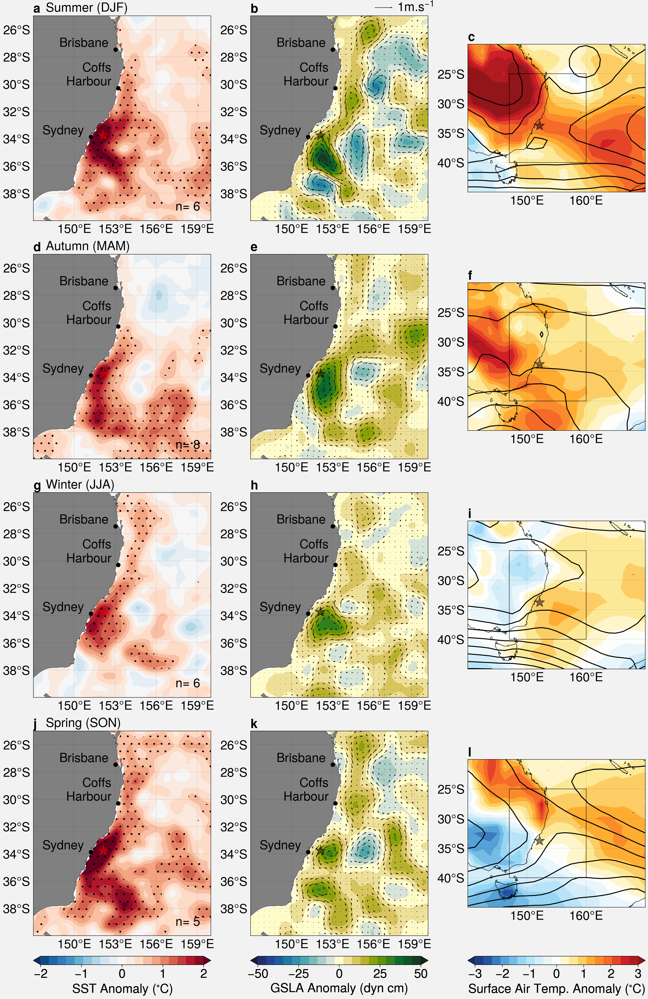

In [112]:
season_label = ['Summer (DJF)', 'Autumn (MAM)', 'Winter (JJA)', 'Spring (SON)']
#months_for_season  = [[6,7,8] ]
import matplotlib.patches as mpatches



fig, axs = proplot.subplots(nrows=len(months_for_season), ncols=3,proj=proj,axwidth='10cm',share=True)
axs.format(facecolor='white',abc=True,coast=True) #, color='grey')

axis_counter = 0
for i_season in range(0,len(months_for_season)):
    
    #print(i_season)
    #mhw_dates_for_season = []

    #for i_event in range(0,len(mhw_months)):
    #    if mhw_months[i_event] in i_season:
    #        mhw_dates_for_season.append(marine_heat_waves_peak_time[i_event])
    #
    #mhw_dates_for_season = np.asarray(mhw_dates_for_season)
    
    
    n_events          = seasonal_composite_SST[i_season]['n_events_in_composite'].values

    
    SST_to_plot       = seasonal_composite_SST[i_season]['shifted_composite__sea_surface_temperature'].sel(time_shift=0)
    GSLA_to_plot      = seasonal_composite_GSLA[i_season]['shifted_composite__GSLA'].sel(time_shift=0)
    u_to_plot         = seasonal_composite_U_anom[i_season]['shifted_composite__UCUR'].sel(time_shift=0)
    v_to_plot         = seasonal_composite_V_anom[i_season]['shifted_composite__VCUR'].sel(time_shift=0)
    surf_temp_to_plot =  seasonal_composite_surf_temp[i_season]['shifted_composite__TMP_GDS0_HTGL'].sel(time_shift=0)
    slp_to_plot       =  seasonal_composite_slp[i_season]['shifted_composite__PRMSL_GDS0_MSL'].sel(time_shift=0)

    sst_null_hypothesis_to_plot = seasonal_null_hypothesis_sst[i_season]['random_composite__sea_surface_temperature']
    null_hypothesis_sst_5 = sst_null_hypothesis_to_plot.sel(quantile=0.05,method='nearest')
    null_hypothesis_sst_95 = sst_null_hypothesis_to_plot.sel(quantile=0.95,method='nearest')
    
    
    cs_SST = axs[axis_counter,0].contourf(SST_to_plot['lon'],SST_to_plot['lat'],SST_to_plot.values,levels=np.linspace(-2,2,20),cmap='RdBu_r',extend='both')
    axs[axis_counter,0].contourf(null_hypothesis_sst_95['lon'],null_hypothesis_sst_95['lat'],
                            np.abs(SST_to_plot>null_hypothesis_sst_95).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
    
    
    axs[axis_counter,0].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=True,land=True,lonlines=3)
    
    
    
    transform = ccrs.PlateCarree()._as_mpl_transform(axs[axis_counter,0])

    axs[axis_counter,0].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[axis_counter,0].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[axis_counter,0].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[axis_counter,0].annotate('Brisbane', xy=(brisbane_lon-0.5,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[axis_counter,0].annotate('Sydney', xy=(sydney_lon-0.5,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[axis_counter,0].annotate('Coffs\n Harbour', xy=(coffs_lon-0.5,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[axis_counter,0].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)
    axs[axis_counter,0].annotate('n= ' +  str(int(n_events)), xy=(0.80, 0.05), xycoords="axes fraction",fontsize=20)

    axs[axis_counter,0].annotate(season_label[i_season], xy=(0.07, 1.02), xycoords="axes fraction",fontsize=20)

    
    cs_GSLA = axs[axis_counter,1].contourf(GSLA_to_plot['LONGITUDE'],GSLA_to_plot['LATITUDE'],METERS_TO_CENTIMETERS * GSLA_to_plot.values,levels=np.linspace(-50,50,20),cmap='Delta',extend='both')
    
    skip_step = 2
    skip = dict(LONGITUDE=slice(None,None,skip_step),LATITUDE=slice(None,None,skip_step))

    
    quiver_out = axs[axis_counter,1].quiver(GSLA_to_plot['LONGITUDE'][::skip_step],GSLA_to_plot['LATITUDE'][::skip_step],u_to_plot[skip],v_to_plot[skip],scale=10)
    if axis_counter ==0:
        qk = axs[axis_counter,1].quiverkey(quiver_out, 0.8, 1.04, 1, r'1m.s$^{-1}$', labelpos='E',
                   coordinates='axes',fontproperties={'size':20})

    
    axs[axis_counter,1].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=True,land=True,lonlines=3)
    axs[axis_counter,1].plot(lon_point,lat_point,'k*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)

    transform = ccrs.PlateCarree()._as_mpl_transform(axs[axis_counter,1])

    
    axs[axis_counter,1].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[axis_counter,1].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[axis_counter,1].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[axis_counter,1].annotate('Brisbane', xy=(brisbane_lon-0.5,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[axis_counter,1].annotate('Sydney', xy=(sydney_lon-0.5,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[axis_counter,1].annotate('Coffs\n Harbour', xy=(coffs_lon-0.5,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    
    atmos_lon_min = 140
    atmos_lon_max = 170
    atmos_lat_max = -20
    atmos_lat_min = -45.0
    
    cs_surf_temp = axs[axis_counter,2].contourf(surf_temp_to_plot['g0_lon_2'],surf_temp_to_plot['g0_lat_1'],surf_temp_to_plot.values,levels=np.linspace(-3,3,20),cmap='HotCold_r',extend='both')

    clines = axs[axis_counter,2].contour(slp_to_plot['g0_lon_2'],slp_to_plot['g0_lat_1'],0.01*slp_to_plot.values,levels=np.arange(900,1100.01,2),colors='black',extend='both')
    axs[axis_counter,2].plot(lon_point,lat_point,'k*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)

    
    axs[axis_counter,2].format(lonlim=(atmos_lon_min, atmos_lon_max), latlim=(atmos_lat_max, atmos_lat_min), labels=True,land=False,lonlines=np.arange(100,180,10))
    axs[axis_counter,2].yaxis.tick_right()
    axs[axis_counter,2].add_patch(mpatches.Rectangle(xy=[lon_min, lat_min], width=lon_max-lon_min, height=lat_max-lat_min,
                                facecolor='none', edgecolor='k',
                                transform=ccrs.PlateCarree()))

    
    axis_counter = axis_counter + 1

fig.colorbar(cs_SST, label=r'SST Anomaly ($^{\circ}$C)',loc='b',ticks=np.arange(-3,3.01,1),col=[1])
fig.colorbar(cs_GSLA, label=r'GSLA Anomaly (dyn cm)',loc='b',ticks=np.arange(-50,50.01,25),col=[2])
fig.colorbar(cs_surf_temp, label=r'Surface Air Temp. Anomaly ($^{\circ}$C)',loc='b',ticks=np.arange(-3,3.01,1),col=[3])



figure_output_path = 'Figures_Update'
figure_file_name = 'MHW_composites_by_season_' + LOCATION
#figure_file_name = 'MHW_case_studies_strong_events'

fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=400,bbox='tight', transparent=True)
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight', transparent=True)


In [184]:
seasonal_composite_SST[i_season]

<xarray.Dataset>
Dimensions:                                         (time_shift: 41, lat: 100, lon: 160)
Coordinates:
  * time_shift                                      (time_shift) float64 -100...
  * lat                                             (lat) float32 -44.88 ... ...
  * lon                                             (lon) float32 140.1 ... 1...
Data variables:
    shifted_composite__sea_surface_temperature      (time_shift, lat, lon) float64 ...
    shifted_composite_std__sea_surface_temperature  (time_shift, lat, lon) float64 ...
    n_events_in_composite                           int64 4

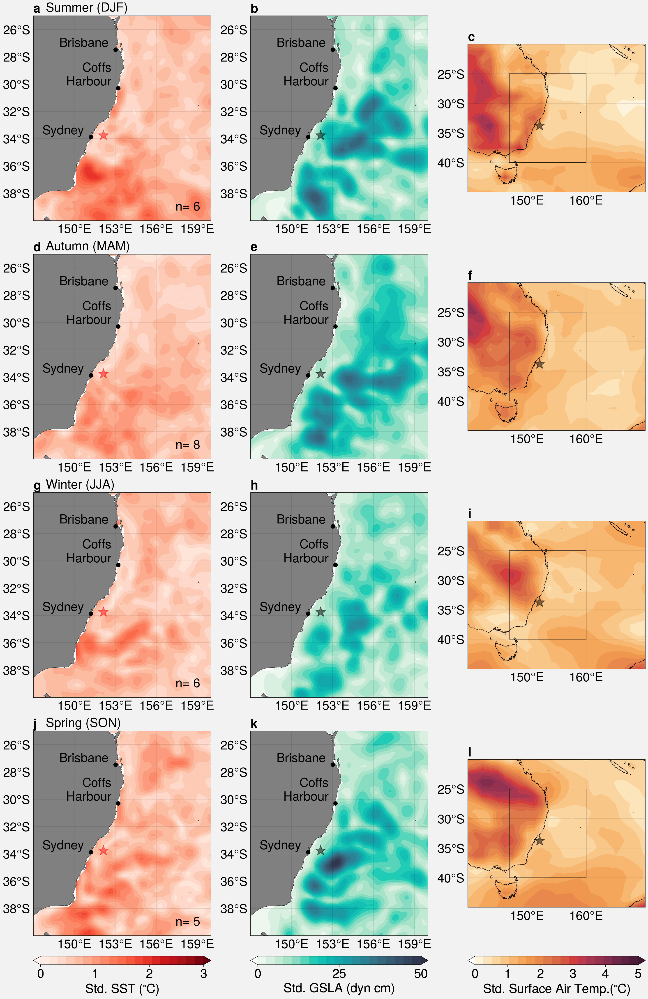

In [114]:
months_for_season  = [[12,1,2], [3,4,5], [6,7,8], [9,10,11] ]
season_label = ['Summer (DJF)', 'Autumn (MAM)', 'Winter (JJA)', 'Spring (SON)']
#months_for_season  = [[6,7,8] ]
import matplotlib.patches as mpatches


mhw_months = marine_heat_waves_peak_time.astype('datetime64[M]').astype(int) % 12 + 1

fig, axs = proplot.subplots(nrows=len(months_for_season), ncols=3,proj=proj,axwidth='10cm',share=True)
axs.format(facecolor='white',abc=True,coast=True) #, color='grey')

axis_counter = 0
for i_season in range(0,len(months_for_season)):
    
    #print(i_season)
    #mhw_dates_for_season = []

    #for i_event in range(0,len(mhw_months)):
    #    if mhw_months[i_event] in i_season:
    #        mhw_dates_for_season.append(marine_heat_waves_peak_time[i_event])
    #
    #mhw_dates_for_season = np.asarray(mhw_dates_for_season)
    
    
    n_events          = seasonal_composite_SST[i_season]['n_events_in_composite'].values

    
    SST_to_plot       = seasonal_composite_SST[i_season]['shifted_composite_std__sea_surface_temperature'].sel(time_shift=0)
    GSLA_to_plot      = seasonal_composite_GSLA[i_season]['shifted_composite_std__GSLA'].sel(time_shift=0)
    #u_to_plot         = seasonal_composite_U_anom[i_season]['shifted_composite_std__UCUR'].sel(time_shift=0)
    #v_to_plot         = seasonal_composite_V_anom[i_season]['shifted_composite_std__VCUR'].sel(time_shift=0)
    surf_temp_to_plot =  seasonal_composite_surf_temp[i_season]['shifted_composite_std__TMP_GDS0_HTGL'].sel(time_shift=0)
    slp_to_plot       =  seasonal_composite_slp[i_season]['shifted_composite_std__PRMSL_GDS0_MSL'].sel(time_shift=0)

    #sst_null_hypothesis_to_plot = seasonal_null_hypothesis_sst[i_season]['random_composite__sea_surface_temperature']
    #null_hypothesis_sst_5 = sst_null_hypothesis_to_plot.sel(quantile=0.05,method='nearest')
    #null_hypothesis_sst_95 = sst_null_hypothesis_to_plot.sel(quantile=0.95,method='nearest')
    
    
    cs_SST = axs[axis_counter,0].contourf(SST_to_plot['lon'],SST_to_plot['lat'],SST_to_plot.values,levels=np.linspace(0,3,20),cmap='Reds',extend='both')
    
    
    axs[axis_counter,0].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=True,land=True,lonlines=3)
    
    
    
    transform = ccrs.PlateCarree()._as_mpl_transform(axs[axis_counter,0])

    axs[axis_counter,0].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[axis_counter,0].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[axis_counter,0].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[axis_counter,0].annotate('Brisbane', xy=(brisbane_lon-0.5,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[axis_counter,0].annotate('Sydney', xy=(sydney_lon-0.5,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[axis_counter,0].annotate('Coffs\n Harbour', xy=(coffs_lon-0.5,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[axis_counter,0].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)
    axs[axis_counter,0].annotate('n= ' +  str(int(n_events)), xy=(0.80, 0.05), xycoords="axes fraction",fontsize=20)

    axs[axis_counter,0].annotate(season_label[i_season], xy=(0.07, 1.02), xycoords="axes fraction",fontsize=20)

    
    cs_GSLA = axs[axis_counter,1].contourf(GSLA_to_plot['LONGITUDE'],GSLA_to_plot['LATITUDE'],METERS_TO_CENTIMETERS * GSLA_to_plot.values,levels=np.linspace(0,50,20),cmap='Marine',extend='both')
    
    #skip_step = 2
    #skip = dict(LONGITUDE=slice(None,None,skip_step),LATITUDE=slice(None,None,skip_step))

    
    #quiver_out = axs[axis_counter,1].quiver(GSLA_to_plot['LONGITUDE'][::skip_step],GSLA_to_plot['LATITUDE'][::skip_step],u_to_plot[skip],v_to_plot[skip],scale=10)
    #if axis_counter ==0:
    #    qk = axs[axis_counter,1].quiverkey(quiver_out, 0.8, 1.04, 1, r'1m.s$^{-1}$', labelpos='E',
    #               coordinates='axes',fontproperties={'size':20})

    
    axs[axis_counter,1].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=True,land=True,lonlines=3)
    axs[axis_counter,1].plot(lon_point,lat_point,'k*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)

    transform = ccrs.PlateCarree()._as_mpl_transform(axs[axis_counter,1])

    
    axs[axis_counter,1].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[axis_counter,1].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[axis_counter,1].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[axis_counter,1].annotate('Brisbane', xy=(brisbane_lon-0.5,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[axis_counter,1].annotate('Sydney', xy=(sydney_lon-0.5,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[axis_counter,1].annotate('Coffs\n Harbour', xy=(coffs_lon-0.5,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    
    atmos_lon_min = 140
    atmos_lon_max = 170
    atmos_lat_max = -20
    atmos_lat_min = -45.0
    
    cs_surf_temp = axs[axis_counter,2].contourf(surf_temp_to_plot['g0_lon_2'],surf_temp_to_plot['g0_lat_1'],surf_temp_to_plot.values,levels=np.linspace(0,5,20),cmap='Fire',extend='both')

    #clines = axs[axis_counter,2].contour(slp_to_plot['g0_lon_2'],slp_to_plot['g0_lat_1'],slp_to_plot.values,levels=np.arange(-1000,1000.01,100),colors='black',extend='both')
    axs[axis_counter,2].plot(lon_point,lat_point,'k*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)

    
    axs[axis_counter,2].format(lonlim=(atmos_lon_min, atmos_lon_max), latlim=(atmos_lat_max, atmos_lat_min), labels=True,land=False,lonlines=np.arange(100,180,10))
    axs[axis_counter,2].yaxis.tick_right()
    axs[axis_counter,2].add_patch(mpatches.Rectangle(xy=[lon_min, lat_min], width=lon_max-lon_min, height=lat_max-lat_min,
                                facecolor='none', edgecolor='k',
                                transform=ccrs.PlateCarree()))

    
    axis_counter = axis_counter + 1

fig.colorbar(cs_SST, label=r'Std. SST ($^{\circ}$C)',loc='b',ticks=np.arange(0,3.01,1),col=[1])
fig.colorbar(cs_GSLA, label=r'Std. GSLA (dyn cm)',loc='b',ticks=np.arange(0,50.01,25),col=[2])
fig.colorbar(cs_surf_temp, label=r'Std. Surface Air Temp.($^{\circ}$C)',loc='b',ticks=np.arange(0,5.01,1),col=[3])



figure_output_path = 'Figures_Update'
figure_file_name = 'MHW_standard_deviation_of_composites_by_season_' + LOCATION
#figure_file_name = 'MHW_case_studies_strong_events'

fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=400,bbox='tight', transparent=True)
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight', transparent=True)


Interpolating along the  -2000 m isobath


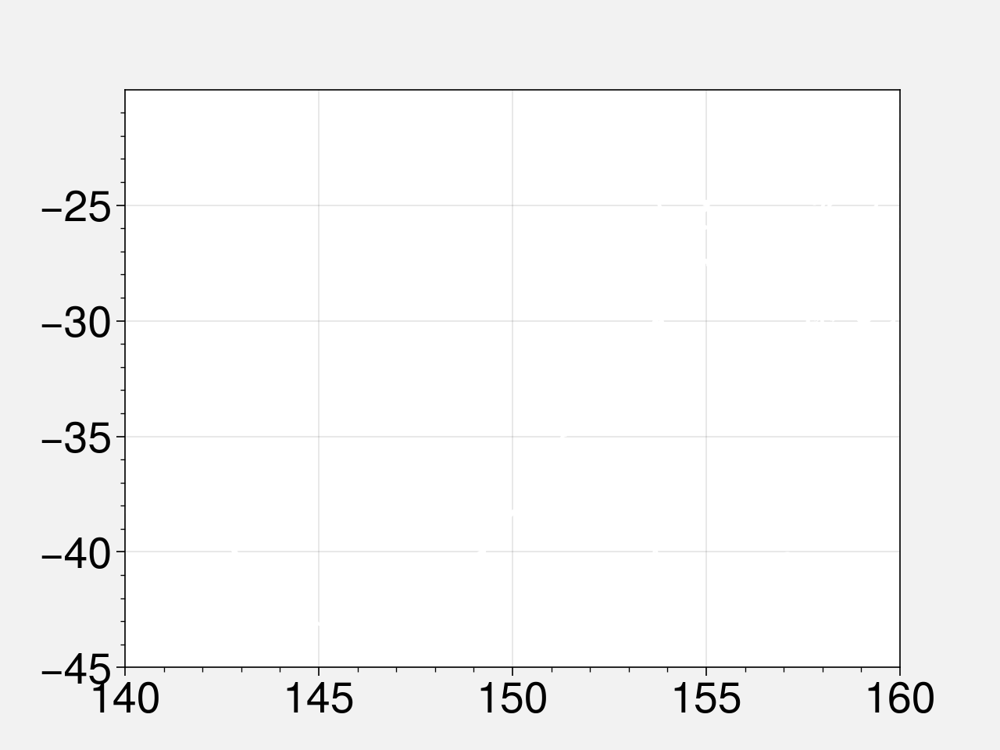

In [121]:
bathymetric_contours_to_get = [-2000]
marine_heat_waves_GSLA_composite_on_bathy_contours  = []
marine_heat_waves_SST_composite_on_bathy_contours  = []
marine_heat_waves_V_anom_composite_on_bathy_contours  = []
marine_heat_waves_JRA_sfc_temp_composite_on_bathy_contours  = []


marine_heat_waves_SST_null_hypothesis_on_bathy_contour  = []
marine_heat_waves_GSLA_null_hypothesis_on_bathy_contour = []
marine_heat_waves_srf_temp_null_hypothesis_on_bathy_contour = []


lat_lim_south = -35.0
lat_lim_north = -25.0
delta_lat = 0.25

for i_bathy_contour in range(0,len(bathymetric_contours_to_get)):

    print('Interpolating along the ', bathymetric_contours_to_get[i_bathy_contour], 'm isobath')
    cs = plt.contour(bathymetry_dataset['x'], bathymetry_dataset['y'], bathymetry_dataset['z'],[bathymetric_contours_to_get[i_bathy_contour]])

    max_length = 0
    for line in cs.collections[0].get_paths():
        n_points,_ = line.vertices.shape
        if n_points>max_length:
            bathymetric_contour_lat_lon = line.vertices
            max_length = n_points
        
    #lines.append(line.vertices)
    #plt.plot(bathymetric_contour_lat_lon[:,0],bathymetric_contour_lat_lon[:,1],'r*')
    

    idx_lat_lim_south = np.nonzero(bathymetric_contour_lat_lon[:,1]>lat_lim_south)[0][0]
    idx_lat_lim_north = np.nonzero(bathymetric_contour_lat_lon[:,1]>lat_lim_north)[0][0]

    regular_lat_points_on_bathy_contour = np.arange(lat_lim_south-delta_lat,lat_lim_north+delta_lat,delta_lat)
    regular_lon_points_on_bathy_contour = np.interp(regular_lat_points_on_bathy_contour, bathymetric_contour_lat_lon[idx_lat_lim_south:idx_lat_lim_north,1], bathymetric_contour_lat_lon[idx_lat_lim_south:idx_lat_lim_north,0])

    bathy_contour_lon = xarray.DataArray(regular_lon_points_on_bathy_contour, dims="z")
    bathy_contour_lat = xarray.DataArray(regular_lat_points_on_bathy_contour, dims="z")


    marine_heat_waves_GSLA_composite_on_bathy_contours.append(   marine_heat_waves_shifted_composite_GSLA.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
    marine_heat_waves_V_anom_composite_on_bathy_contours.append(   marine_heat_waves_shifted_composite_V_anom.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
    marine_heat_waves_SST_composite_on_bathy_contours.append(  marine_heat_waves_shifted_composite_SST.interp(lon=bathy_contour_lon,lat=bathy_contour_lat).persist().squeeze())
    marine_heat_waves_JRA_sfc_temp_composite_on_bathy_contours.append(marine_heat_waves_shifted_composite_JRA_sfc_temp.interp(g0_lon_2=bathy_contour_lon,g0_lat_1=bathy_contour_lat).persist().squeeze())
    
    marine_heat_waves_SST_null_hypothesis_on_bathy_contour.append(marine_heat_waves_composite_SST_null_hypothesis.interp(lon=bathy_contour_lon,lat=bathy_contour_lat).persist().squeeze())
    marine_heat_waves_GSLA_null_hypothesis_on_bathy_contour.append(marine_heat_waves_composite_GSLA_null_hypothesis.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
    marine_heat_waves_srf_temp_null_hypothesis_on_bathy_contour.append(marine_heat_waves_composite_sfc_temp_null_hypothesis.interp(g0_lon_2=bathy_contour_lon,g0_lat_1=bathy_contour_lat).persist().squeeze())
    

In [116]:
marine_heat_waves_composite_GSLA_null_hypothesis

NameError: name 'marine_heat_waves_composite_GSLA_null_hypothesis' is not defined

In [129]:
marine_heat_waves_shifted_composite_JRA_slp

<xarray.Dataset>
Dimensions:                               (time_shift: 41, g0_lat_1: 21, g0_lon_2: 33)
Coordinates:
  * time_shift                            (time_shift) float64 -100.0 ... 100.0
  * g0_lat_1                              (g0_lat_1) float32 -20.0 ... -45.0
  * g0_lon_2                              (g0_lon_2) float32 140.0 ... 180.0
Data variables:
    shifted_composite__PRES_GDS0_SFC      (time_shift, g0_lat_1, g0_lon_2) float64 ...
    shifted_composite_std__PRES_GDS0_SFC  (time_shift, g0_lat_1, g0_lon_2) float64 ...
    n_events_in_composite                 int64 23

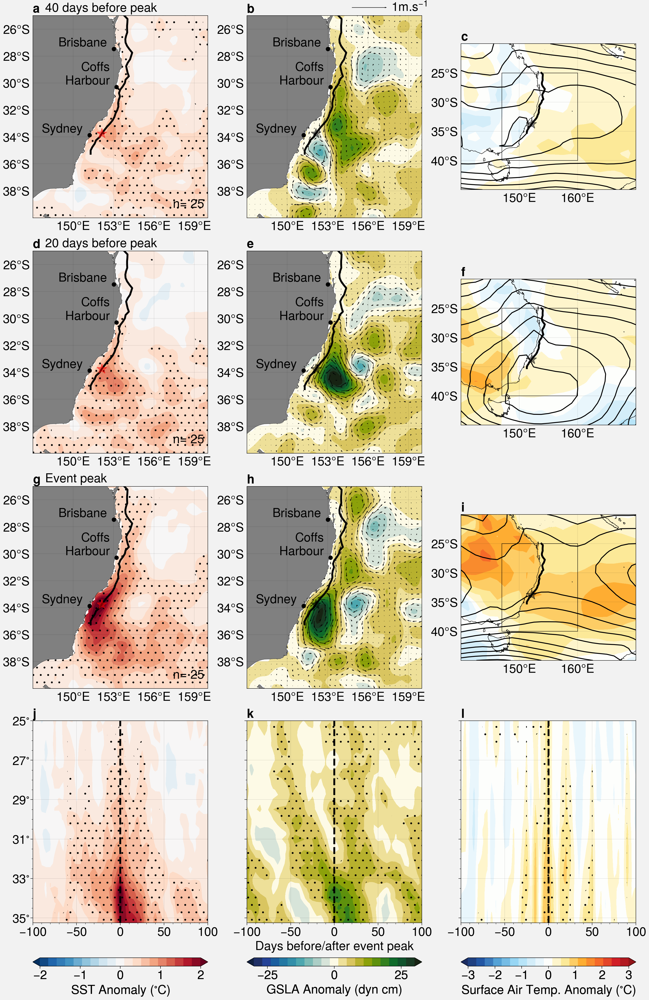

In [122]:


lags_in_days = [-40,-20,0]

projection_dict = {1:proj,2:proj,3:proj,4:proj,5:proj,6:proj,7:proj,8:proj,9:proj,10:None,11:None,12:None}

fig, axs = proplot.subplots(nrows=len(lags_in_days) + 1, ncols=3,proj=projection_dict,axwidth='10cm',share=True)
axs.format(facecolor='white',abc=True,coast=True) #, color='grey')

axis_counter = 0
for i_lag in range(0,len(lags_in_days)):
    
    
    
    
    n_events          = marine_heat_waves_shifted_composite_SST['n_events_in_composite'].values

    
    SST_to_plot       = marine_heat_waves_shifted_composite_SST['shifted_composite__sea_surface_temperature'].sel(time_shift=lags_in_days[i_lag])
    GSLA_to_plot      = marine_heat_waves_shifted_composite_GSLA['shifted_composite__GSLA'].sel(time_shift=lags_in_days[i_lag])
    u_to_plot         = marine_heat_waves_shifted_composite_U_anom['shifted_composite__UCUR'].sel(time_shift=lags_in_days[i_lag])
    v_to_plot         = marine_heat_waves_shifted_composite_V_anom['shifted_composite__VCUR'].sel(time_shift=lags_in_days[i_lag])
    surf_temp_to_plot =  marine_heat_waves_shifted_composite_JRA_sfc_temp['shifted_composite__TMP_GDS0_HTGL'].sel(time_shift=lags_in_days[i_lag])
    slp_to_plot       =  marine_heat_waves_shifted_composite_JRA_slp['shifted_composite__PRMSL_GDS0_MSL'].sel(time_shift=lags_in_days[i_lag])

    sst_null_hypothesis_to_plot = marine_heat_waves_composite_SST_null_hypothesis['random_composite__sea_surface_temperature']
    
    null_hypothesis_sst_5 = sst_null_hypothesis_to_plot.sel(quantile=0.05,method='nearest')
    null_hypothesis_sst_95 = sst_null_hypothesis_to_plot.sel(quantile=0.95,method='nearest')
    
    
    cs_SST = axs[axis_counter,0].contourf(SST_to_plot['lon'],SST_to_plot['lat'],SST_to_plot.values,levels=np.linspace(-2,2,20),cmap='RdBu_r',extend='both')
    axs[axis_counter,0].contourf(null_hypothesis_sst_95['lon'],null_hypothesis_sst_95['lat'],
                            np.abs(SST_to_plot>null_hypothesis_sst_95).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
    
    
    axs[axis_counter,0].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=True,land=True,lonlines=3)
    
    
    
    transform = ccrs.PlateCarree()._as_mpl_transform(axs[axis_counter,0])

    axs[axis_counter,0].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[axis_counter,0].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[axis_counter,0].plot(coffs_lon,coffs_lat,'o',color='k')
    axs[axis_counter,0].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    axs[axis_counter,0].annotate('Brisbane', xy=(brisbane_lon-0.5,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[axis_counter,0].annotate('Sydney', xy=(sydney_lon-0.5,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[axis_counter,0].annotate('Coffs\n Harbour', xy=(coffs_lon-0.5,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[axis_counter,0].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)
    axs[axis_counter,0].annotate('n= ' +  str(int(n_events)), xy=(0.80, 0.05), xycoords="axes fraction",fontsize=20)

    if lags_in_days[i_lag]<0:
        axs[axis_counter,0].annotate(str(int(np.abs(lags_in_days[i_lag]))) + ' days before peak', xy=(0.07, 1.02), xycoords="axes fraction",fontsize=20)
    elif lags_in_days[i_lag]==0:
        axs[axis_counter,0].annotate('Event peak', xy=(0.07, 1.02), xycoords="axes fraction",fontsize=20)

    
    cs_GSLA = axs[axis_counter,1].contourf(GSLA_to_plot['LONGITUDE'],GSLA_to_plot['LATITUDE'],METERS_TO_CENTIMETERS * GSLA_to_plot.values,
                                           levels=np.linspace(-30,30,20),cmap='Delta',extend='both')
    
    skip_step = 2
    skip = dict(LONGITUDE=slice(None,None,skip_step),LATITUDE=slice(None,None,skip_step))

    
    quiver_out = axs[axis_counter,1].quiver(GSLA_to_plot['LONGITUDE'][::skip_step],GSLA_to_plot['LATITUDE'][::skip_step],u_to_plot[skip],v_to_plot[skip],scale=5)
    if axis_counter ==0:
        qk = axs[axis_counter,1].quiverkey(quiver_out, 0.8, 1.04, 1, r'1m.s$^{-1}$', labelpos='E',
                   coordinates='axes',fontproperties={'size':20})

    
    axs[axis_counter,1].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=True,land=True,lonlines=3)
    axs[axis_counter,1].plot(lon_point,lat_point,'k*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)
    axs[axis_counter,1].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    transform = ccrs.PlateCarree()._as_mpl_transform(axs[axis_counter,1])

    
    axs[axis_counter,1].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[axis_counter,1].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[axis_counter,1].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[axis_counter,1].annotate('Brisbane', xy=(brisbane_lon-0.5,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[axis_counter,1].annotate('Sydney', xy=(sydney_lon-0.5,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[axis_counter,1].annotate('Coffs\n Harbour', xy=(coffs_lon-0.5,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    
    atmos_lon_min = 140
    atmos_lon_max = 170
    atmos_lat_max = -20
    atmos_lat_min = -45.0
    
    cs_surf_temp = axs[axis_counter,2].contourf(surf_temp_to_plot['g0_lon_2'],surf_temp_to_plot['g0_lat_1'],surf_temp_to_plot.values,levels=np.linspace(-3,3,20),cmap='HotCold_r',extend='both')

    clines = axs[axis_counter,2].contour(slp_to_plot['g0_lon_2'],slp_to_plot['g0_lat_1'],0.01*slp_to_plot.values,levels=np.arange(900,1200.01,1),colors='black',extend='both')
    axs[axis_counter,2].plot(lon_point,lat_point,'k*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)
    axs[axis_counter,2].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    
    axs[axis_counter,2].format(lonlim=(atmos_lon_min, atmos_lon_max), latlim=(atmos_lat_max, atmos_lat_min), labels=True,land=False,lonlines=np.arange(100,180,10))
    axs[axis_counter,2].yaxis.tick_right()
    axs[axis_counter,2].add_patch(mpatches.Rectangle(xy=[lon_min, lat_min], width=lon_max-lon_min, height=lat_max-lat_min,
                                facecolor='none', edgecolor='k',
                                transform=ccrs.PlateCarree()))

    
    axis_counter = axis_counter + 1

    
#marine_heat_waves_GSLA_composite_on_bathy_contours.append(   marine_heat_waves_shifted_composite_GSLA.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
#    marine_heat_waves_V_anom_composite_on_bathy_contours.append(   marine_heat_waves_shifted_composite_V_anom.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
SST_to_plot       = marine_heat_waves_SST_composite_on_bathy_contours[0]['shifted_composite__sea_surface_temperature']
GSLA_to_plot      = marine_heat_waves_GSLA_composite_on_bathy_contours[0]['shifted_composite__GSLA']
surf_temp_to_plot = marine_heat_waves_JRA_sfc_temp_composite_on_bathy_contours[0]['shifted_composite__TMP_GDS0_HTGL']


upper_quantile_sst = marine_heat_waves_SST_null_hypothesis_on_bathy_contour[0]['random_composite__sea_surface_temperature'].sel(quantile=0.95,method='nearest').squeeze()
lower_quantile_sst = marine_heat_waves_SST_null_hypothesis_on_bathy_contour[0]['random_composite__sea_surface_temperature'].sel(quantile=0.05)

upper_quantile_GSLA = marine_heat_waves_GSLA_null_hypothesis_on_bathy_contour[0]['random_composite__GSLA'].sel(quantile=0.95,method='nearest').squeeze()
lower_quantile_GSLA = marine_heat_waves_GSLA_null_hypothesis_on_bathy_contour[0]['random_composite__GSLA'].sel(quantile=0.05)

upper_quantile_srf_temp = marine_heat_waves_srf_temp_null_hypothesis_on_bathy_contour[0]['random_composite__TMP_GDS0_HTGL'].sel(quantile=0.95,method='nearest').squeeze()


lags_to_plot =SST_to_plot['time_shift'].values
    
cs_SST = axs[axis_counter,0].contourf(lags_to_plot,SST_to_plot['lat'].values,SST_to_plot.T.values,
                                     levels=np.linspace(-2,2,20),cmap='RdBu_r',extend='both')

axs[axis_counter,0].contourf(lags_to_plot,SST_to_plot['lat'].values,
                            np.abs(SST_to_plot>upper_quantile_sst).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')


axs[axis_counter,0].set_yticks(np.arange(-35,-24.9,2))
axs[axis_counter,0].set_yticklabels(y_ticklabels)
axs[axis_counter,0].axvline(x=0,linewidth=3.0,linestyle='--',color='black')
   
    
    
cs_GSLA = axs[axis_counter,1].contourf(lags_to_plot,GSLA_to_plot['LATITUDE'].values,METERS_TO_CENTIMETERS * GSLA_to_plot.T.values,
                                      levels=np.linspace(-30,30,20),cmap='Delta',extend='both')
axs[axis_counter,1].contourf(lags_to_plot,GSLA_to_plot['LATITUDE'].values,
                            np.abs(GSLA_to_plot>upper_quantile_GSLA).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')


axs[axis_counter,1].set_yticks(np.arange(-35,-24.9,2))
axs[axis_counter,1].set_yticklabels([])
    
axs[axis_counter,1].axvline(x=0,linewidth=3.0,linestyle='--',color='black')
axs[axis_counter,1].set_xlabel('Days before/after event peak')

    
cs_surf_temp = axs[axis_counter,2].contourf(lags_to_plot,surf_temp_to_plot['g0_lat_1'].values,
                                           surf_temp_to_plot.T.values,levels=np.linspace(-3,3,20),cmap='HotCold_r',extend='both')

axs[axis_counter,2].contourf(lags_to_plot,surf_temp_to_plot['g0_lat_1'].values,
                            np.abs(surf_temp_to_plot>upper_quantile_srf_temp).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')


axs[axis_counter,2].set_yticks(np.arange(-35,-24.9,2))
axs[axis_counter,2].set_yticklabels([])
axs[axis_counter,2].axvline(x=0,linewidth=3.0,linestyle='--',color='black')



    
fig.colorbar(cs_SST, label=r'SST Anomaly ($^{\circ}$C)',loc='b',ticks=np.arange(-3,3.01,1),col=[1])
fig.colorbar(cs_GSLA, label=r'GSLA Anomaly (dyn cm)',loc='b',ticks=np.arange(-50,50.01,25),col=[2])
fig.colorbar(cs_surf_temp, label=r'Surface Air Temp. Anomaly ($^{\circ}$C)',loc='b',ticks=np.arange(-3,3.01,1),col=[3])



figure_output_path = 'Figures_Update'
figure_file_name = 'MHW_composites_lagged_with_hovmoller_' + LOCATION
#figure_file_name = 'MHW_case_studies_strong_events'

fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=400,bbox='tight', transparent=True)
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight', transparent=True)


In [161]:
marine_heat_waves_GSLA_null_hypothesis_on_bathy_contour[0]

<xarray.Dataset>
Dimensions:                 (quantile: 19, z: 42)
Coordinates:
  * quantile                (quantile) float64 0.05 0.1 0.15 ... 0.85 0.9 0.95
    LONGITUDE               (z) float64 151.3 151.3 151.4 ... 154.0 154.0 153.8
    LATITUDE                (z) float64 -35.25 -35.0 -34.75 ... -25.25 -25.0
Dimensions without coordinates: z
Data variables:
    random_composite__GSLA  (quantile, z) float64 dask.array<chunksize=(19, 42), meta=np.ndarray>

In [155]:
marine_heat_waves_SST_null_hypothesis_on_bathy_contour[0]['random_composite__sea_surface_temperature']

<xarray.DataArray 'random_composite__sea_surface_temperature' (quantile: 19, z: 42)>
dask.array<dask_aware_interpnd, shape=(19, 42), dtype=float64, chunksize=(19, 42), chunktype=numpy.ndarray>
Coordinates:
  * quantile  (quantile) float64 0.05 0.1 0.15 0.2 0.25 ... 0.8 0.85 0.9 0.95
    lon       (z) float64 151.3 151.3 151.4 151.6 ... 154.0 154.0 154.0 153.8
    lat       (z) float64 -35.25 -35.0 -34.75 -34.5 ... -25.5 -25.25 -25.0
Dimensions without coordinates: z

In [152]:
upper_quantile_sst

<xarray.DataArray 'random_composite__sea_surface_temperature' (z: 42)>
dask.array<getitem, shape=(42,), dtype=float64, chunksize=(42,), chunktype=numpy.ndarray>
Coordinates:
    quantile  float64 0.95
    lon       (z) float64 151.3 151.3 151.4 151.6 ... 154.0 154.0 154.0 153.8
    lat       (z) float64 -35.25 -35.0 -34.75 -34.5 ... -25.5 -25.25 -25.0
Dimensions without coordinates: z

In [153]:
SST_to_plot

<xarray.DataArray 'shifted_composite__sea_surface_temperature' (time_shift: 41, z: 42)>
array([[ 0.16619265,  0.08450139,  0.00515088, ...,  0.01252174,
         0.01438848, -0.03960869],
       [ 0.32622059,  0.1990038 ,  0.08718643, ...,  0.14291304,
         0.18513187,  0.17379539],
       [ 0.11985045,  0.0515397 , -0.06523122, ...,  0.15113042,
         0.17760328,  0.14267518],
       ...,
       [ 0.56057633,  0.44819106,  0.33217719, ...,  0.33043476,
         0.33895124,  0.30278512],
       [ 0.42565213,  0.38668428,  0.32605071, ...,  0.25965219,
         0.29657891,  0.31665984],
       [ 0.49399876,  0.43389006,  0.35732673, ...,  0.27960869,
         0.30244846,  0.31553452]])
Coordinates:
  * time_shift  (time_shift) float64 -100.0 -95.0 -90.0 ... 90.0 95.0 100.0
    lon         (z) float64 151.3 151.3 151.4 151.6 ... 154.0 154.0 154.0 153.8
    lat         (z) float64 -35.25 -35.0 -34.75 -34.5 ... -25.5 -25.25 -25.0
Dimensions without coordinates: z

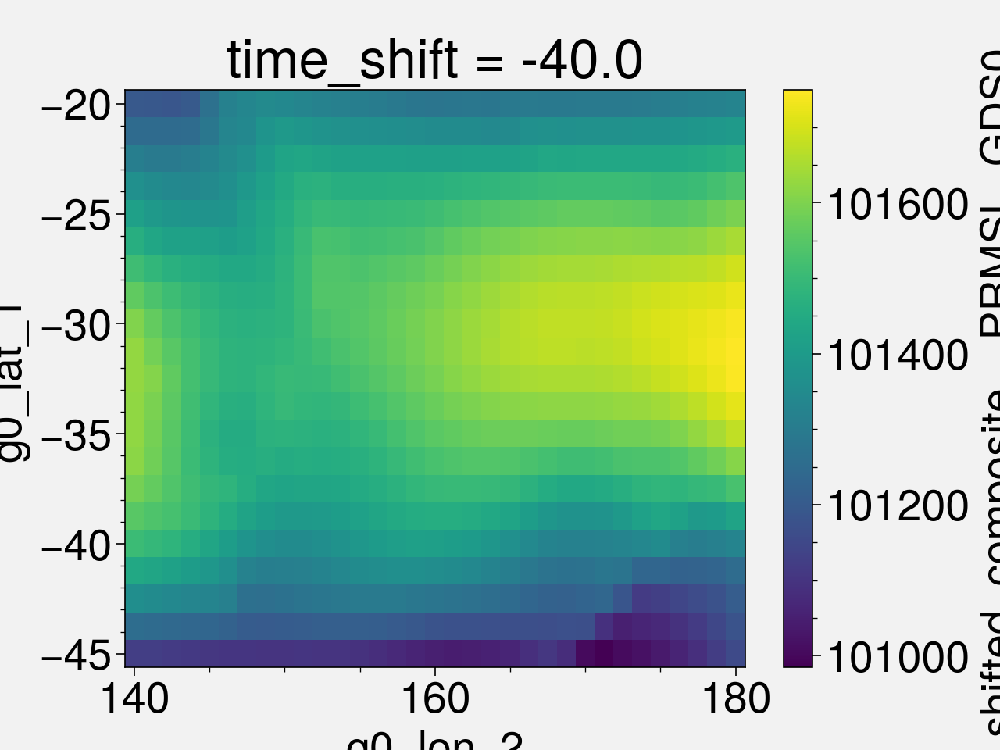

In [137]:
slp_to_plot.plot()

In [115]:
marine_heat_waves_OISST_composite_on_bathy_contours[0]

NameError: name 'marine_heat_waves_OISST_composite_on_bathy_contours' is not defined

In [118]:
shift_increments   = 1
n_shifts = 20*5

marine_heat_wave_peak_time = []
for i_event in range(len(marine_heat_waves['date_peak'])):
    marine_heat_wave_peak_time.append(np.datetime64(marine_heat_waves['date_peak'][i_event]) )
marine_heat_wave_peak_time = np.asarray(marine_heat_wave_peak_time)


marine_heat_wave_shifted_composite_JRA_sfc_temp = event_analysis.simple_shifted_event_composite_average(
                                                   marine_heat_wave_peak_time,JRA_srf_temperature_dataset['TMP_GDS0_HTGL'].squeeze(),n_shifts,shift_increments,
                                                   sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time')
marine_heat_wave_shifted_composite_JRA_sfc_u_wind = event_analysis.simple_shifted_event_composite_average(
                                                   marine_heat_wave_peak_time,JRA_srf_temperature_dataset['UGRD_GDS0_HTGL'].squeeze(),n_shifts,shift_increments,
                                                   sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time')
marine_heat_wave_shifted_composite_JRA_sfc_v_wind = event_analysis.simple_shifted_event_composite_average(
                                                   marine_heat_wave_peak_time,JRA_srf_temperature_dataset['VGRD_GDS0_HTGL'].squeeze(),n_shifts,shift_increments,
                                                   sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time')

marine_heat_wave_shifted_composite_JRA_sfc_pressure = event_analysis.simple_shifted_event_composite_average(
                                                   marine_heat_wave_peak_time,JRA_srf_temperature_dataset['PRES_GDS0_SFC'].squeeze(),n_shifts,shift_increments,
                                                   sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time')


#output_to_write = '/tube1/cha674/EAC/Data_Processing/Updated_Intermediate_files'

##marine_heat_wave_shifted_composite_JRA_sfc_temp.to_netcdf(os.path.join(output_to_write,'marine_heat_wave_composite_JRA_sfc_temp_' +  LOCATION +'_data_source_' + SST_data_source + '.nc') )
#marine_heat_wave_shifted_composite_JRA_sfc_u_wind.to_netcdf(os.path.join(output_to_write,'marine_heat_wave_composite_JRA_u_wind_' +  LOCATION +'_data_source_' + SST_data_source + '.nc') ) 
#marine_heat_wave_shifted_composite_JRA_sfc_v_wind.to_netcdf(os.path.join(output_to_write,'marine_heat_wave_composite_JRA_v_wind_' +  LOCATION +'_data_source_' + SST_data_source + '.nc') ) 
#marine_heat_wave_shifted_composite_JRA_sfc_pressure.to_netcdf(os.path.join(output_to_write,'marine_heat_wave_composite_JRA_sfc_pressure_' +  LOCATION +'_data_source_' + SST_data_source + '.nc') )


KeyboardInterrupt: 

In [21]:
shift_increments   = 1
n_shifts = 20*5

marine_cold_spell_peak_time = []
for i_event in range(len(marine_cold_spells['date_peak'])):
    marine_cold_spell_peak_time.append(np.datetime64(marine_cold_spells['date_peak'][i_event]) )
marine_cold_spell_peak_time = np.asarray(marine_cold_spell_peak_time)

marine_cold_spell_shifted_composite_JRA_sfc_temp = event_analysis.simple_shifted_event_composite_average(
                                                   marine_cold_spell_peak_time,JRA_srf_temperature_dataset['TMP_GDS0_HTGL'].squeeze(),n_shifts,shift_increments,
                                                   sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time')
'''
marine_cold_spell_shifted_composite_JRA_sfc_u_wind = event_analysis.simple_shifted_event_composite_average(
                                                   marine_cold_spell_peak_time,JRA_srf_temperature_dataset['UGRD_GDS0_HTGL'].squeeze(),n_shifts,shift_increments,
                                                   sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time')
marine_cold_spell_shifted_composite_JRA_sfc_v_wind = event_analysis.simple_shifted_event_composite_average(
                                                   marine_cold_spell_peak_time,JRA_srf_temperature_dataset['VGRD_GDS0_HTGL'].squeeze(),n_shifts,shift_increments,
                                                   sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time')
marine_cold_spell_shifted_composite_JRA_sfc_pressure = event_analysis.simple_shifted_event_composite_average(
                                                   marine_cold_spell_peak_time,JRA_srf_temperature_dataset['PRES_GDS0_SFC'].squeeze(),n_shifts,shift_increments,
                                                   sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time')
output_to_write = '/tube1/cha674/EAC/Data_Processing/Updated_Intermediate_files'

marine_cold_spell_shifted_composite_JRA_sfc_temp.to_netcdf(os.path.join(output_to_write,
                                                                        'marine_cold_spell_composite_JRA_sfc_temp_' +  LOCATION +'_data_source_' + SST_data_source + '.nc') )
marine_cold_spell_shifted_composite_JRA_sfc_u_wind.to_netcdf(os.path.join(output_to_write,
                                                                          'marine_cold_spell_composite_JRA_u_wind_' +  LOCATION +'_data_source_' + SST_data_source + '.nc') )
marine_cold_spell_shifted_composite_JRA_sfc_v_wind.to_netcdf(os.path.join(output_to_write,
                                                                          'marine_cold_spell_composite_JRA_v_wind_' +  LOCATION +'_data_source_' + SST_data_source + '.nc') )
marine_cold_spell_shifted_composite_JRA_sfc_pressure.to_netcdf(os.path.join(output_to_write,
                                                                            'marine_cold_spell_composite_JRA_sfc_pressure_' +  LOCATION +'_data_source_' + SST_data_source + '.nc') )
'''

"\nmarine_cold_spell_shifted_composite_JRA_sfc_u_wind = event_analysis.simple_shifted_event_composite_average(\n                                                   marine_cold_spell_peak_time,JRA_srf_temperature_dataset['UGRD_GDS0_HTGL'].squeeze(),n_shifts,shift_increments,\n                                                   sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time')\nmarine_cold_spell_shifted_composite_JRA_sfc_v_wind = event_analysis.simple_shifted_event_composite_average(\n                                                   marine_cold_spell_peak_time,JRA_srf_temperature_dataset['VGRD_GDS0_HTGL'].squeeze(),n_shifts,shift_increments,\n                                                   sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time')\nmarine_cold_spell_shifted_composite_JRA_sfc_pressure = event_analysis.simple_shifted_event_composite_average(\n                                                   marine_cold_spell_peak_time,JRA_srf_temperature_dataset['PRES_GDS0_SFC'].sq

In [117]:
N_monte_carlo=1000
marine_heat_waves_composite_GSLA_null_hypothesis = event_analysis.random_sampling_for_quantiles(
                                       marine_heat_waves_shifted_composite_GSLA['n_events_in_composite'].values,GSLA_anom,sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME',
                                       N_monte_carlo=N_monte_carlo)

marine_heat_waves_composite_v_current_null_hypothesis = event_analysis.random_sampling_for_quantiles(
                                       marine_heat_waves_shifted_composite_V_anom['n_events_in_composite'].values,v_current_anom,sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME',
                                       N_monte_carlo=N_monte_carlo)



marine_heat_waves_composite_SST_null_hypothesis =  event_analysis.random_sampling_for_quantiles(
                                       marine_heat_waves_shifted_composite_SST['n_events_in_composite'].values,SST_anom_dataset['sea_surface_temperature'].squeeze(),sensor_dims=['lat', 'lon'],sample_dim='time',
                                       N_monte_carlo=N_monte_carlo)

marine_heat_waves_composite_sfc_temp_null_hypothesis =  event_analysis.random_sampling_for_quantiles(
                                       marine_heat_wave_shifted_composite_JRA_sfc_temp['n_events_in_composite'].values,JRA_srf_temperature_dataset['TMP_GDS0_HTGL'].squeeze(),
                                       sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time',N_monte_carlo=N_monte_carlo)


#marine_heat_waves_composite_GSLA_null_hypothesis.to_netcdf(os.path.join(output_to_write,'marine_heat_waves_composite_GSLA_null_hypothesis_' + LOCATION + '_data_source_' + SST_data_source + '.detrended.nc'))
#marine_heat_waves_composite_SST_null_hypothesis.to_netcdf(os.path.join(output_to_write,'marine_heat_waves_composite_SST_null_hypothesis_'+ LOCATION +'_data_source_' + SST_data_source +'.detrended.nc'))

NameError: name 'marine_heat_wave_shifted_composite_JRA_sfc_temp' is not defined

In [ ]:
N_monte_carlo=1000
marine_cold_spell_composite_GSLA_null_hypothesis = event_analysis.random_sampling_for_quantiles(
                                       marine_cold_spell_shifted_composite_GSLA['n_events_in_composite'].values,GSLA_anom,sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME',
                                       N_monte_carlo=N_monte_carlo)

marine_cold_spell_composite_v_current_null_hypothesis = event_analysis.random_sampling_for_quantiles(
                                       marine_cold_spell_shifted_composite_V['n_events_in_composite'].values,v_current_anom,sensor_dims=['LATITUDE', 'LONGITUDE'],sample_dim='TIME',
                                       N_monte_carlo=N_monte_carlo)


marine_cold_spell_composite_SST_null_hypothesis =  event_analysis.random_sampling_for_quantiles(
                                       marine_cold_spell_shifted_composite_SST['n_events_in_composite'].values,SST_anom_dataset['sea_surface_temperature'].squeeze(),sensor_dims=['lat', 'lon'],sample_dim='time',
                                       N_monte_carlo=N_monte_carlo)

marine_cold_spell_composite_sfc_temp_null_hypothesis =  event_analysis.random_sampling_for_quantiles(
                                       marine_cold_spell_shifted_composite_JRA_sfc_temp['n_events_in_composite'].values,JRA_srf_temperature_dataset['TMP_GDS0_HTGL'].squeeze(),
                                       sensor_dims=['g0_lat_1', 'g0_lon_2'],sample_dim='time',N_monte_carlo=N_monte_carlo)



marine_cold_spell_composite_GSLA_null_hypothesis.to_netcdf(os.path.join(output_to_write,'marine_cold_spell_composite_GSLA_null_hypothesis_' + LOCATION + '_data_source_' + SST_data_source + '.detrended.nc'))
marine_cold_spell_composite_SST_null_hypothesis.to_netcdf(os.path.join(output_to_write,'marine_cold_spell_composite_SST_null_hypothesis_'+ LOCATION +'_data_source_' + SST_data_source +'.detrended.nc'))

Lag:  -40
Lag:  -20
Lag:  0
Lag:  20
Heat_Waves_Shifted_Composite_location_COFFS_HARBOUR_data_source_OISST_lag_20_with_atmos


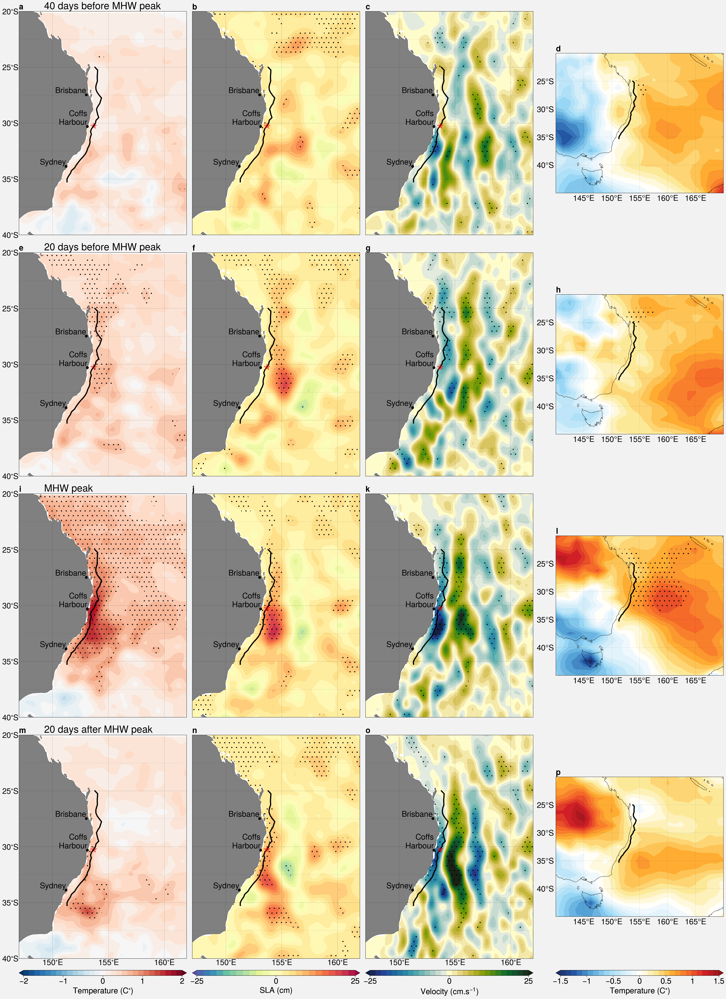

In [27]:
import proplot
import string
alphabet_list = list(string.ascii_lowercase)
from mpl_toolkits.axes_grid1.inset_locator import inset_axes,mark_inset
import matplotlib.patches as patches

TARGET_LATITUDE = -27.4

cold_spells_n_events = marine_cold_spells['n_events']



proplot.rc['land.color'] = 'grey'
proplot.rc['text.labelsize'] = 20
proplot.rc['text.titlesize'] = 25
proplot.rc['abc.size'] = 20
proplot.rc['abc.style'] = 'a'


SST_min = -2.0
SST_max =  2.0
delta_SST = 1.0


GSLA_min = -25
GSLA_max =  25
delta_GSLA = 25

brisbane_lat = -27.470125
brisbane_lon = 153.021072
sydney_lat   = -33.865143
sydney_lon   = 151.209900
coffs_lat   = -30.296276
coffs_lon   = 153.114136

city_font_size =20

lon_min = 147
lon_max = 162
lat_max = -20
lat_min = -40.0
    

lag_in_days   = 15
n_lag_periods = 4

lags_in_days = [-40,-20,0,20]
proplot.rc.reso = 'med'  # use higher res for zoomed in geographic features
proj = proplot.Proj('cyl', basemap=False)

    atmos_lon_min = 140
    atmos_lon_max = 170
    atmos_lat_max = -20
    atmos_lat_min = -45.0
quantiles = marine_heat_waves_composite_GSLA_null_hypothesis['quantile']

row_counter = 0
label_counter= 0
fig, axs = proplot.subplots(nrows=len(lags_in_days), ncols=4, proj=proj,axwidth='15cm',sharex=0,sharey=0)

axs.format(coast=True,facecolor='white',lonlines=np.arange(145,181,5),abc=True) #, color='grey')

for i_lag in range(0,len(lags_in_days)):
    
    print('Lag: ', lags_in_days[i_lag])
    
    SST_marine_heat_waves_composite  = marine_heat_waves_shifted_composite_SST['shifted_composite__sea_surface_temperature'].sel(time_shift=lags_in_days[i_lag],method='nearest')
   
    
    null_hypothesis_SST_5         = marine_heat_waves_composite_SST_null_hypothesis['random_composite__sea_surface_temperature'].isel(quantile=0)
    null_hypothesis_SST_95        = marine_heat_waves_composite_SST_null_hypothesis['random_composite__sea_surface_temperature'].isel(quantile=(quantiles.size-1))
    
                                                                    
    cs_SST = axs[row_counter,0].contourf(SST_marine_heat_waves_composite['lon'],SST_marine_heat_waves_composite['lat'],
                                           SST_marine_heat_waves_composite,levels=np.linspace(SST_min,SST_max,30),transform=ccrs.PlateCarree(),cmap=plt.cm.RdBu_r,extend='both')
    axs[row_counter,0].contourf(SST_marine_heat_waves_composite['lon'],SST_marine_heat_waves_composite['lat'],
                            np.abs(SST_marine_heat_waves_composite>2*null_hypothesis_SST_95).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
    #axs[row_counter,0].contourf(SST_marine_heat_waves_composite['lon'],SST_marine_heat_waves_composite['lat'],
    #                           np.abs(SST_marine_heat_waves_composite<2.0*null_hypothesis_SST_5).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')

    
    longitude_slice = np.arange(153,157+0.05,0.1)
    axs[row_counter,0].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)
    axs[row_counter,0].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    transform = ccrs.PlateCarree()._as_mpl_transform(axs[row_counter,0])

    axs[row_counter,0].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[row_counter,0].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[row_counter,0].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[row_counter,0].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[row_counter,0].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,0].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    
    if row_counter==len(lags_in_days)-1:
        axs[row_counter,0].set_xticks(np.arange(150,171,5))
        x_ticks = []
    atmos_lon_min = 140
    atmos_lon_max = 170
    atmos_lat_max = -20
    atmos_lat_min = -45.0
        for i_tick in np.arange(150,171,5):
            x_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}E$' )
        axs[row_counter,0].set_xticklabels(x_ticks)
    else:
        axs[row_counter,0].set_xticks(np.arange(150,171,5))
        axs[row_counter,0].set_xticklabels([])
        
    axs[row_counter,0].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max),land=True)


    axs[row_counter,0].set_yticks(np.arange(lat_min,lat_max+1,5))
    y_ticks = []
    for i_tick in np.arange(lat_min,lat_max+1,5):
        y_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}S$' )
    
    axs[row_counter,0].set_yticklabels(y_ticks)
    #row_counter = row_counter+1
    
    label_counter=label_counter+1
    
    if lags_in_days[i_lag]<0:
        axs[row_counter,0].annotate(str(int(np.abs(lags_in_days[i_lag]))) + ' days before MHW peak', xy=(.15, 1.01), xycoords="axes fraction",fontsize=25)
    elif lags_in_days[i_lag]==0:
        axs[row_counter,0].annotate('MHW peak', xy=(.15, 1.01), xycoords="axes fraction",fontsize=25)
    else:
        axs[row_counter,0].annotate(str(int(np.abs(lags_in_days[i_lag]))) + ' days after MHW peak', xy=(.15, 1.01), xycoords="axes fraction",fontsize=25)
    
    label_counter=label_counter+1
    
    
    #row_counter = row_counter+1

    
    GSLA_heat_waves_peak_composite = marine_heat_waves_shifted_composite_GSLA['shifted_composite__GSLA'].sel(time_shift=lags_in_days[i_lag],method='nearest')
    u_heat_waves_peak_composite    = marine_heat_waves_shifted_composite_U_anom['shifted_composite__UCUR'].sel(time_shift=lags_in_days[i_lag]-5,method='nearest')
    v_heat_waves_peak_composite    = marine_heat_waves_shifted_composite_V_anom['shifted_composite__VCUR'].sel(time_shift=lags_in_days[i_lag]-5,method='nearest')
    
    
    
    v_composite_slice = v_heat_waves_peak_composite.sel(LATITUDE=TARGET_LATITUDE,method='nearest')
    


    null_hypothesis_GSLA_5         = marine_heat_waves_composite_GSLA_null_hypothesis['random_composite__GSLA'].isel(quantile=0)
    null_hypothesis_GSLA_95        = marine_heat_waves_composite_GSLA_null_hypothesis['random_composite__GSLA'].isel(quantile=(quantiles.size-1))
    N_samples                      = marine_heat_waves_shifted_composite_GSLA['n_events_in_composite'].values
    
    
    #u_heat_waves_peak_composite = u_heat_waves_peak_composite.where( (GSLA_heat_waves_peak_composite>null_hypothesis_GSLA_95.values) + 
    #                                 (GSLA_heat_waves_peak_composite<null_hypothesis_GSLA_5.values)    )
    #v_heat_waves_peak_composite = v_heat_waves_peak_composite.where( (GSLA_heat_waves_peak_composite>null_hypothesis_GSLA_95.values) + 
    #                                (GSLA_heat_waves_peak_composite<null_hypothesis_GSLA_5.values)   )
    

    cs_GSLA = axs[row_counter,1].contourf(GSLA_heat_waves_peak_composite['LONGITUDE'],GSLA_heat_waves_peak_composite['LATITUDE'],
                               METERS_TO_CENTIMETERS*GSLA_heat_waves_peak_composite,levels=np.linspace(GSLA_min,GSLA_max,25),cmap='Spectral_r',extend='both')
                                                                    
    axs[row_counter,1].contourf(GSLA_heat_waves_peak_composite['LONGITUDE'],GSLA_heat_waves_peak_composite['LATITUDE'],
                            np.abs(GSLA_heat_waves_peak_composite>1.5*null_hypothesis_GSLA_95).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
    axs[row_counter,1].contourf(GSLA_heat_waves_peak_composite['LONGITUDE'],GSLA_heat_waves_peak_composite['LATITUDE'],
                            np.abs(GSLA_heat_waves_peak_composite<null_hypothesis_GSLA_5).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
                                                                
    axs[row_counter,1].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    
    
   
    transform = ccrs.PlateCarree()._as_mpl_transform(axs[row_counter,1])

    axs[row_counter,1].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[row_counter,1].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[row_counter,1].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[row_counter,1].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[row_counter,1].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,1].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,1].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)

    if row_counter==len(lags_in_days)-1:
        axs[row_counter,1].set_xticks(np.arange(150,171,5))
        x_ticks = []
        for i_tick in np.arange(150,171,5):
            x_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}E$' )
        axs[row_counter,1].set_xticklabels(x_ticks)
    else:
        axs[row_counter,1].set_xticks(np.arange(150,171,5))
        axs[row_counter,1].set_xticklabels([])
    
    axs[row_counter,1].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=False,land=True)
    axs[row_counter,1].set_yticks(np.arange(lat_min,lat_max,5))
    axs[row_counter,1].set_yticklabels([])

    null_hypothesis_vcurr_5 = marine_heat_waves_composite_v_current_null_hypothesis['random_composite__VCUR'].sel(quantile=0.05,method='nearest')
    null_hypothesis_vcurr_95 = marine_heat_waves_composite_v_current_null_hypothesis['random_composite__VCUR'].sel(quantile=0.95,method='nearest')

    cs_v = axs[row_counter,2].contourf(v_heat_waves_peak_composite['LONGITUDE'],v_heat_waves_peak_composite['LATITUDE'],
                                       100*v_heat_waves_peak_composite,levels=np.linspace(-25,25,30),transform=ccrs.PlateCarree(),cmap='delta',extend='both')
    axs[row_counter,2].contourf(v_heat_waves_peak_composite['LONGITUDE'],v_heat_waves_peak_composite['LATITUDE'],
                            np.abs(v_heat_waves_peak_composite>null_hypothesis_vcurr_95).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
    axs[row_counter,2].contourf(v_heat_waves_peak_composite['LONGITUDE'],v_heat_waves_peak_composite['LATITUDE'],
                            np.abs(v_heat_waves_peak_composite<null_hypothesis_vcurr_5).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
                                                                
    axs[row_counter,2].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    

    axs[row_counter,2].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[row_counter,2].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[row_counter,2].plot(coffs_lon,coffs_lat,'o',color='k')
    transform = ccrs.PlateCarree()._as_mpl_transform(axs[row_counter,2])

    axs[row_counter,2].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[row_counter,2].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,2].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,2].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)

            
    if row_counter==len(lags_in_days)-1:
        axs[row_counter,2].set_xticks(np.arange(150,171,5))
        x_ticks = []
        for i_tick in np.arange(150,171,5):
            x_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}E$' )
        axs[row_counter,2].set_xticklabels(x_ticks)
    else:
        axs[row_counter,2].set_xticks(np.arange(150,171,5))
        axs[row_counter,2].set_xticklabels([])
            
    
    axs[row_counter,2].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=False,land=True)
    axs[row_counter,2].set_yticks(np.arange(lat_min,lat_max,5))
    axs[row_counter,2].set_yticklabels([])

    
    temp_min = -2.0
    temp_max =  2.0
    delta_temp = 0.5
    pressure_min = -300
    pressure_max = 300


    JRA_sfc_temp_heat_waves_peak_composite        = marine_heat_wave_shifted_composite_JRA_sfc_temp['shifted_composite__TMP_GDS0_HTGL'].sel(time_shift=lags_in_days[i_lag],method='nearest')
    #JRA_sfc_pressure_heat_waves_peak_composite    = marine_heat_wave_shifted_composite_JRA_sfc_pressure['shifted_composite__PRES_GDS0_SFC'].sel(time_shift=lags_in_days[i_lag],method='nearest')

    #JRA_sfc_u_wind_heat_waves_peak_composite    = marine_heat_wave_shifted_composite_JRA_sfc_u_wind['shifted_composite__UGRD_GDS0_HTGL'].sel(time_shift=lags_in_days[i_lag],method='nearest')
    #JRA_sfc_v_wind_heat_waves_peak_composite    = marine_heat_wave_shifted_composite_JRA_sfc_v_wind['shifted_composite__VGRD_GDS0_HTGL'].sel(time_shift=lags_in_days[i_lag],method='nearest')
    
    
    
    JRA_sfc_temp_null_hypothesis_5         = marine_heat_waves_composite_sfc_temp_null_hypothesis['random_composite__TMP_GDS0_HTGL'].isel(quantile=0)
    JRA_sfc_temp_null_hypothesis_95        = marine_heat_waves_composite_sfc_temp_null_hypothesis['random_composite__TMP_GDS0_HTGL'].isel(quantile=(quantiles.size-1))


    JRA_sfc_temp_heat_waves_peak_composite = JRA_sfc_temp_heat_waves_peak_composite.sel(g0_lat_1=JRA_sfc_temp_null_hypothesis_5['g0_lat_1'],g0_lon_2=JRA_sfc_temp_null_hypothesis_5['g0_lon_2'])
    

    #JRA_sfc_u_wind_heat_waves_peak_composite = JRA_sfc_u_wind_heat_waves_peak_composite.where( (JRA_sfc_temp_heat_waves_peak_composite>3*JRA_sfc_temp_null_hypothesis_95.values) + 
    #                                                                                         (JRA_sfc_temp_heat_waves_peak_composite<JRA_sfc_temp_null_hypothesis_5.values)    )
    #JRA_sfc_v_wind_heat_waves_peak_composite = JRA_sfc_v_wind_heat_waves_peak_composite.where( (JRA_sfc_temp_heat_waves_peak_composite>JRA_sfc_temp_null_hypothesis_95.values) + 
    #                                                                                           (JRA_sfc_temp_heat_waves_peak_composite<JRA_sfc_temp_null_hypothesis_5.values)   )

    
    cs_surf_temp = axs[row_counter,3].contourf(JRA_sfc_temp_heat_waves_peak_composite['g0_lon_2'],JRA_sfc_temp_heat_waves_peak_composite['g0_lat_1'],
                                          JRA_sfc_temp_heat_waves_peak_composite,levels=np.linspace(-1.5,1.5,30),cmap='HotCold_r',extend='both')
    
    try: 
        axs[row_counter,3].contourf(JRA_sfc_temp_heat_waves_peak_composite['g0_lon_2'],JRA_sfc_temp_heat_waves_peak_composite['g0_lat_1'],
                                np.abs(JRA_sfc_temp_heat_waves_peak_composite>2*JRA_sfc_temp_null_hypothesis_95).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')

    except: 
        print('skip sig test ')
    axs[row_counter,3].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    
    #axs[row_counter,2].contour(JRA_sfc_pressure_heat_waves_peak_composite['g0_lon_2'],JRA_sfc_pressure_heat_waves_peak_composite['g0_lat_1'],
    #                            JRA_sfc_pressure_heat_waves_peak_composite,levels=np.arange(pressure_min,pressure_max+1,25),colors='black')
    
    #cs_quiver = axs[row_counter,3].quiver(JRA_sfc_u_wind_heat_waves_peak_composite['g0_lon_2'],JRA_sfc_u_wind_heat_waves_peak_composite['g0_lat_1'],
    #                                     JRA_sfc_u_wind_heat_waves_peak_composite.values,JRA_sfc_v_wind_heat_waves_peak_composite.values, 
    #                                     transform=ccrs.PlateCarree(), color='k',scale=50,alpha=0.75)
    #qk = axs[row_counter,3].quiverkey(cs_quiver, 0.73, 0.05, 2, r'0.5m.s$^{-1}$', labelpos='E',
    #                   coordinates='axes',fontproperties={'size':15})

    #qk = axs[row_counter,1].quiverkey(vT_quiver, 0.70, 0.05, 1, r'10GW.m$^{-2}$', labelpos='E',
    #                   coordinates='axes',fontproperties={'size':15})

    atmos_lon_min = 140
    atmos_lon_max = 170
    atmos_lat_max = -20
    atmos_lat_min = -45.0
    axs[row_counter,3].format(lonlim=(atmos_lon_min, atmos_lon_max), latlim=(atmos_lat_max, atmos_lat_min), labels=True,land=False)
    axs[row_counter,3].yaxis.tick_right()
  
    row_counter = row_counter+1

cbar = fig.colorbar(cs_SST,  label=r'Temperature (C$^{\circ}$)', ticks=np.arange(SST_min,SST_max+0.1,delta_SST), loc='b', col=[1])
cbar = fig.colorbar(cs_GSLA, label='SLA (cm)', ticks=np.arange(GSLA_min,GSLA_max+0.1,delta_GSLA), loc='b', col=2)
cbar = fig.colorbar(cs_v, label='Velocity (cm.s$^{-1}$)', ticks=np.arange(-25,25+0.1,25), loc='b', col=3)
cbar = fig.colorbar(cs_surf_temp,  label=r'Temperature (C$^{\circ}$)', ticks=np.arange(-1.5,1.5+0.1,0.5), loc='b', col=4)

    

figure_file_name = 'Heat_Waves_Shifted_Composite_location_' + LOCATION + '_data_source_' + SST_data_source + '_lag_' + str(lags_in_days[i_lag]) + '_with_atmos'
print(figure_file_name)
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=400,bbox='tight', transparent=False)
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight', transparent=False)



Lag:  -40
Single_Heat_Waves_Shifted_Composite_location_COFFS_HARBOUR_data_source_OISST_lag_-40_with_atmos
Lag:  -35
Single_Heat_Waves_Shifted_Composite_location_COFFS_HARBOUR_data_source_OISST_lag_-35_with_atmos
Lag:  -30
Single_Heat_Waves_Shifted_Composite_location_COFFS_HARBOUR_data_source_OISST_lag_-30_with_atmos
Lag:  -25
Single_Heat_Waves_Shifted_Composite_location_COFFS_HARBOUR_data_source_OISST_lag_-25_with_atmos
Lag:  -20
Single_Heat_Waves_Shifted_Composite_location_COFFS_HARBOUR_data_source_OISST_lag_-20_with_atmos
Lag:  -15
Single_Heat_Waves_Shifted_Composite_location_COFFS_HARBOUR_data_source_OISST_lag_-15_with_atmos
Lag:  -10
Single_Heat_Waves_Shifted_Composite_location_COFFS_HARBOUR_data_source_OISST_lag_-10_with_atmos
Lag:  -5
Single_Heat_Waves_Shifted_Composite_location_COFFS_HARBOUR_data_source_OISST_lag_-5_with_atmos
Lag:  0
Single_Heat_Waves_Shifted_Composite_location_COFFS_HARBOUR_data_source_OISST_lag_0_with_atmos
Lag:  5
Single_Heat_Waves_Shifted_Composite_location

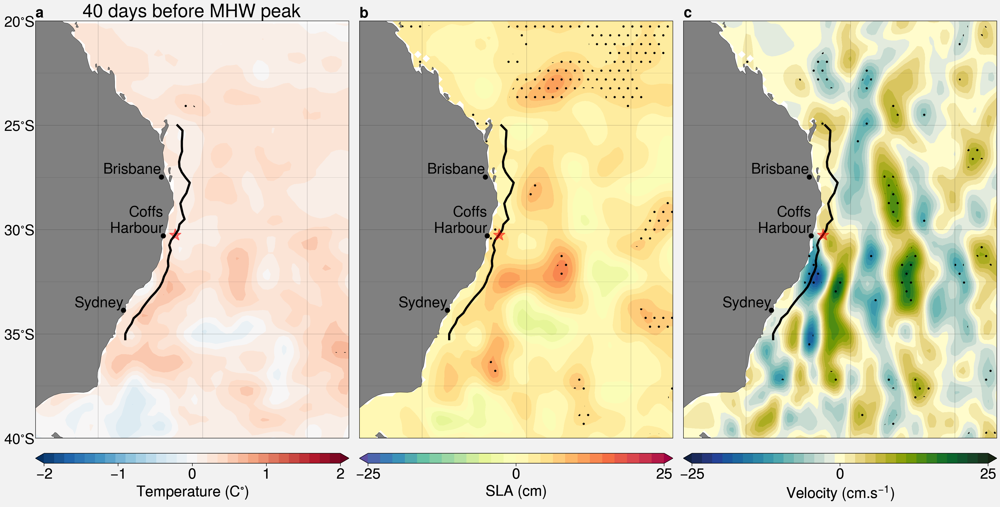

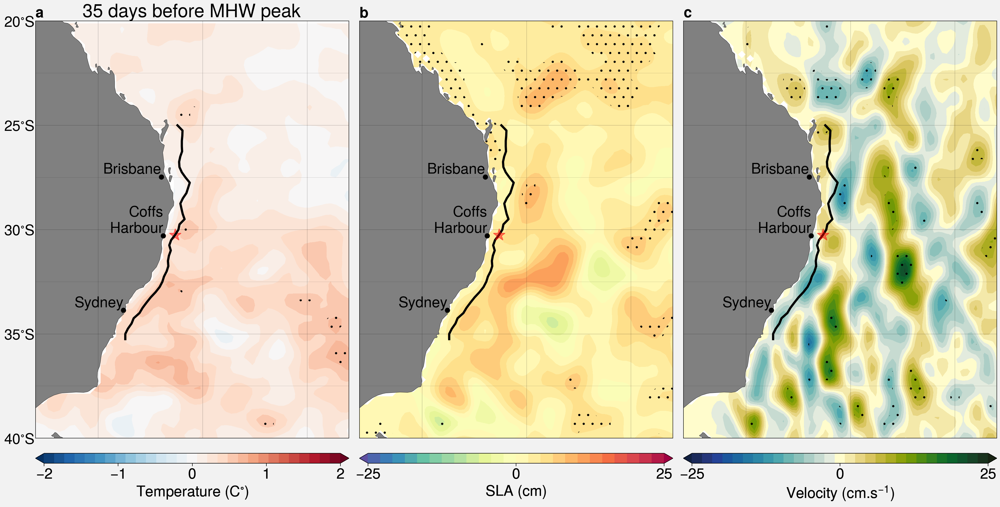

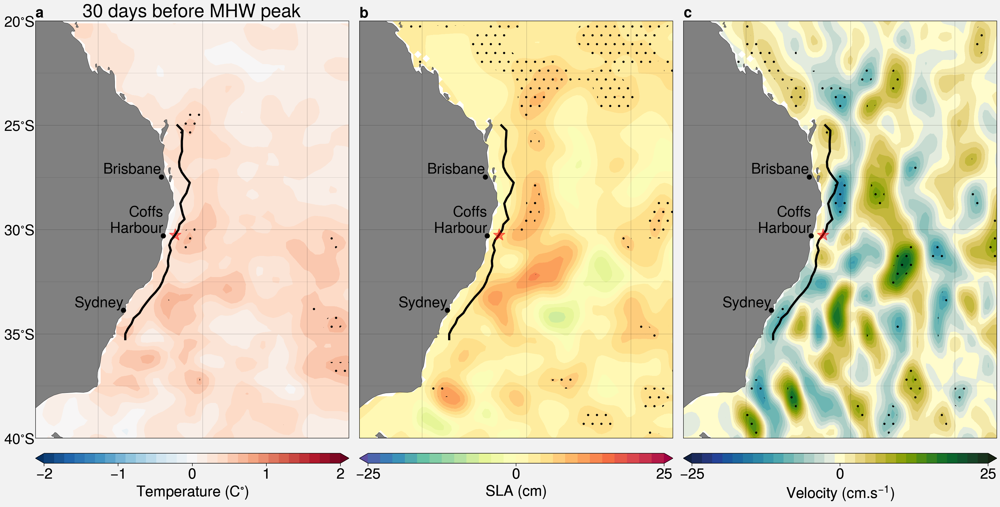

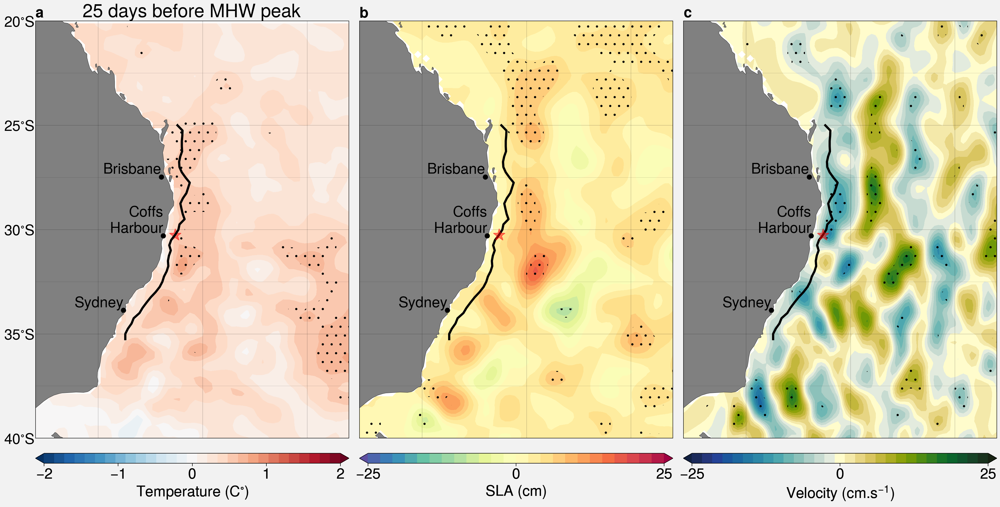

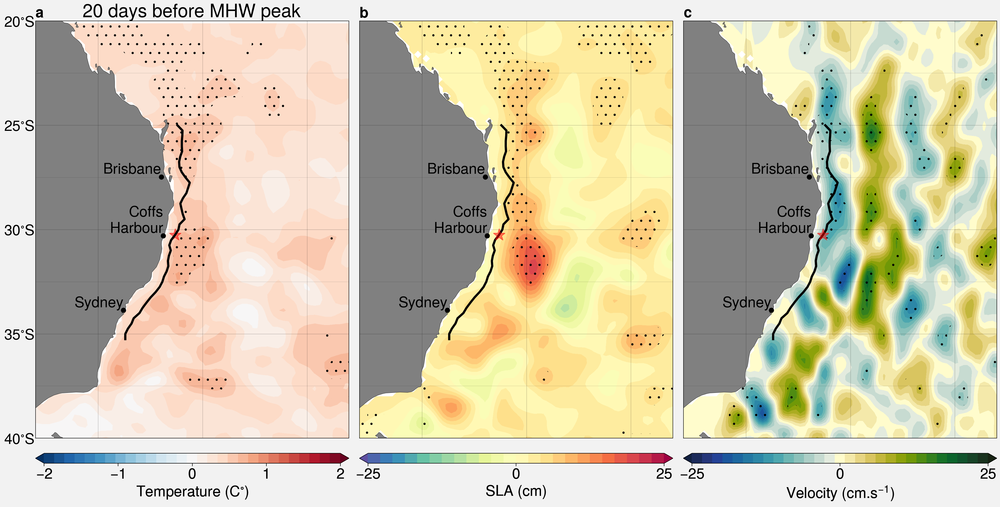

...

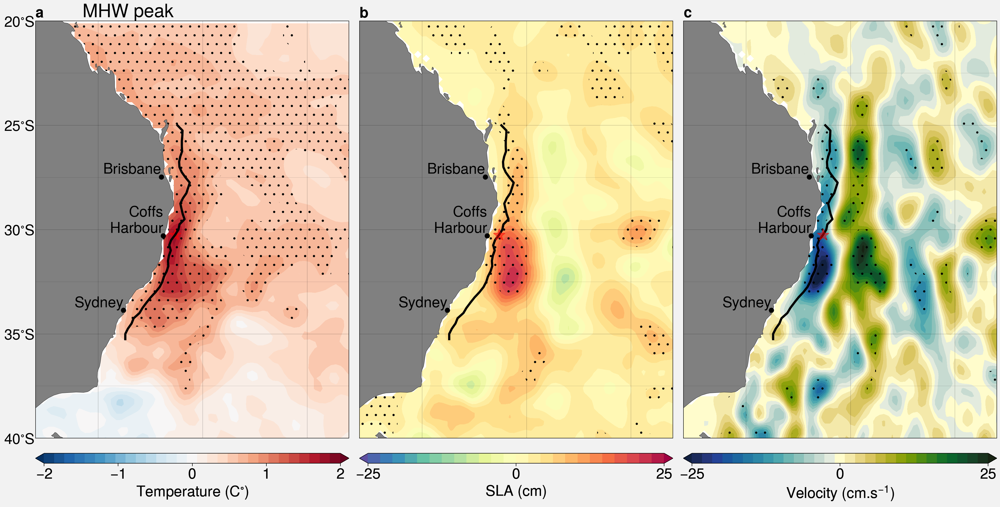

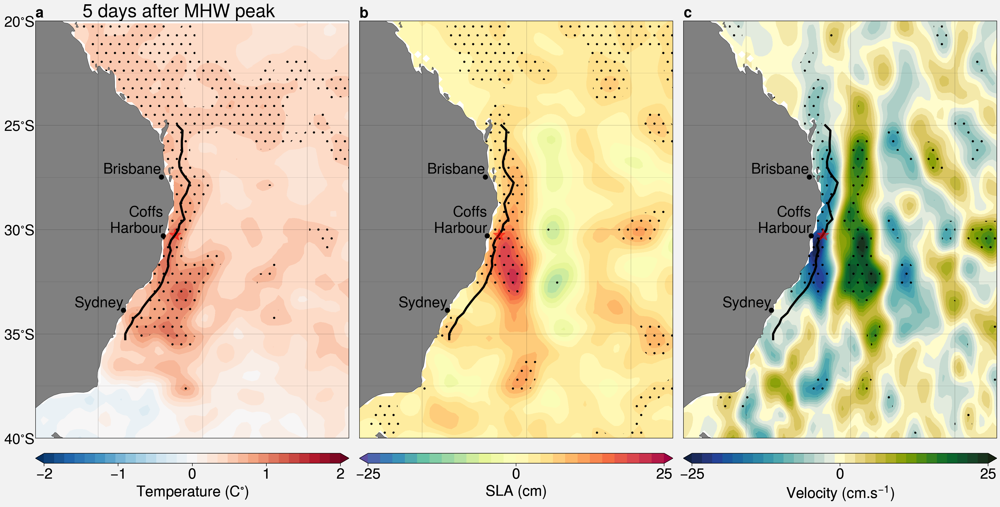

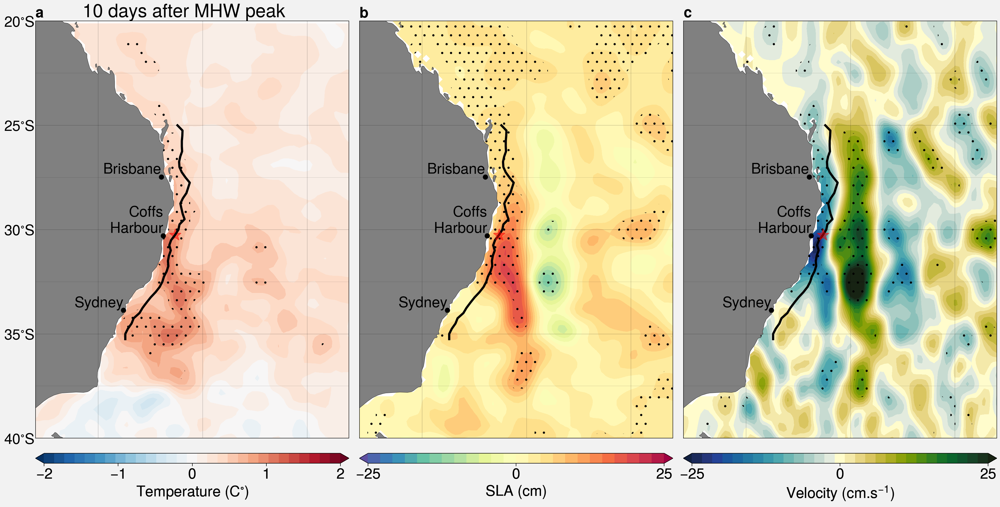

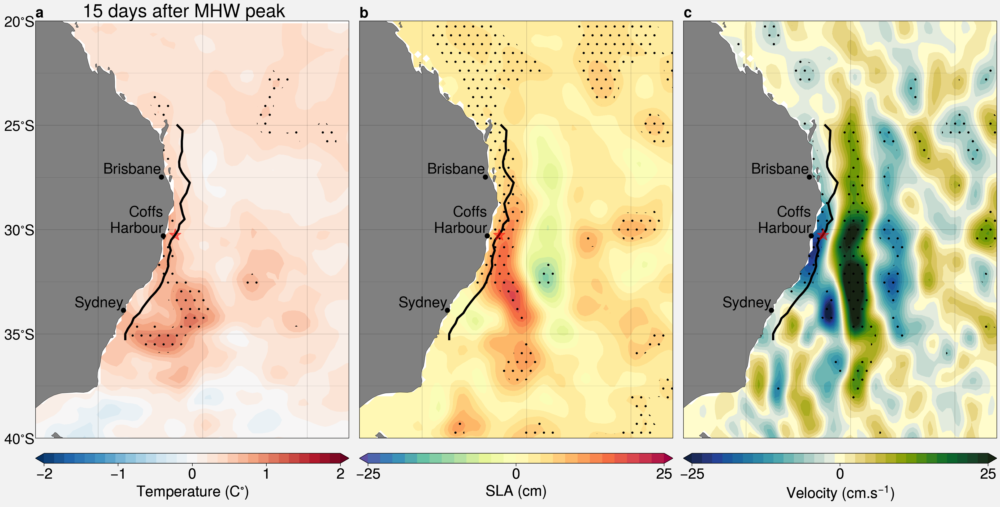

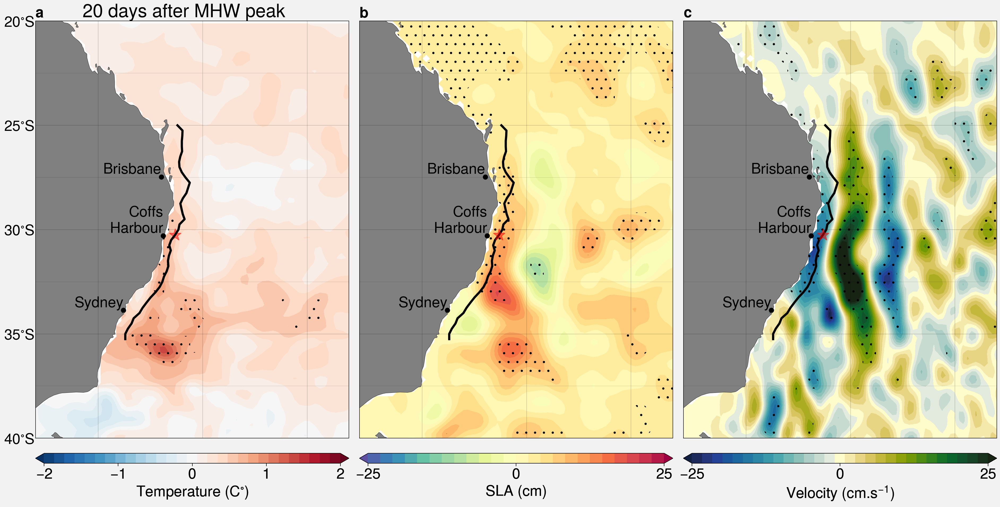

In [31]:
import proplot
import string
alphabet_list = list(string.ascii_lowercase)
from mpl_toolkits.axes_grid1.inset_locator import inset_axes,mark_inset
import matplotlib.patches as patches

TARGET_LATITUDE = -27.4

cold_spells_n_events = marine_cold_spells['n_events']



proplot.rc['land.color'] = 'grey'
proplot.rc['text.labelsize'] = 20
proplot.rc['text.titlesize'] = 25
proplot.rc['abc.size'] = 20
proplot.rc['abc.style'] = 'a'


SST_min = -2.0
SST_max =  2.0
delta_SST = 1.0


GSLA_min = -25
GSLA_max =  25
delta_GSLA = 25

brisbane_lat = -27.470125
brisbane_lon = 153.021072
sydney_lat   = -33.865143
sydney_lon   = 151.209900
coffs_lat   = -30.296276
coffs_lon   = 153.114136

city_font_size =20

lon_min = 147
lon_max = 162
lat_max = -20
lat_min = -40.0
    

lag_in_days   = 15
n_lag_periods = 4

lags_in_days = np.arange(-40,21,5) #[-40,-20,0,20]
proplot.rc.reso = 'med'  # use higher res for zoomed in geographic features
proj = proplot.Proj('cyl', basemap=False)

quantiles = marine_heat_waves_composite_GSLA_null_hypothesis['quantile']

row_counter = 0
label_counter= 0

for i_lag in range(0,len(lags_in_days)):
    
    print('Lag: ', lags_in_days[i_lag])

    fig, axs = proplot.subplots(nrows=1, ncols=3, proj=proj,axwidth='15cm',sharex=0,sharey=0)

    axs.format(coast=True,facecolor='white',lonlines=np.arange(145,181,5),abc=True) #, color='grey')

    
    SST_marine_heat_waves_composite  = marine_heat_waves_shifted_composite_SST['shifted_composite__sea_surface_temperature'].sel(time_shift=lags_in_days[i_lag],method='nearest')
   
    
    null_hypothesis_SST_5         = marine_heat_waves_composite_SST_null_hypothesis['random_composite__sea_surface_temperature'].isel(quantile=0)
    null_hypothesis_SST_95        = marine_heat_waves_composite_SST_null_hypothesis['random_composite__sea_surface_temperature'].isel(quantile=(quantiles.size-1))
    
                                                                    
    cs_SST = axs[row_counter,0].contourf(SST_marine_heat_waves_composite['lon'],SST_marine_heat_waves_composite['lat'],
                                           SST_marine_heat_waves_composite,levels=np.linspace(SST_min,SST_max,30),transform=ccrs.PlateCarree(),cmap=plt.cm.RdBu_r,extend='both')
    axs[row_counter,0].contourf(SST_marine_heat_waves_composite['lon'],SST_marine_heat_waves_composite['lat'],
                            np.abs(SST_marine_heat_waves_composite>2*null_hypothesis_SST_95).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
    #axs[row_counter,0].contourf(SST_marine_heat_waves_composite['lon'],SST_marine_heat_waves_composite['lat'],
    #                           np.abs(SST_marine_heat_waves_composite<2.0*null_hypothesis_SST_5).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')

    
    longitude_slice = np.arange(153,157+0.05,0.1)
    axs[row_counter,0].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)
    axs[row_counter,0].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    transform = ccrs.PlateCarree()._as_mpl_transform(axs[row_counter,0])

    axs[row_counter,0].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[row_counter,0].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[row_counter,0].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[row_counter,0].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[row_counter,0].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,0].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    
    if row_counter==len(lags_in_days)-1:
        axs[row_counter,0].set_xticks(np.arange(150,171,5))
        x_ticks = []
        for i_tick in np.arange(150,171,5):
            x_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}E$' )
        axs[row_counter,0].set_xticklabels(x_ticks)
    else:
        axs[row_counter,0].set_xticks(np.arange(150,171,5))
        axs[row_counter,0].set_xticklabels([])
        
    axs[row_counter,0].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max),land=True)


    axs[row_counter,0].set_yticks(np.arange(lat_min,lat_max+1,5))
    y_ticks = []
    for i_tick in np.arange(lat_min,lat_max+1,5):
        y_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}S$' )
    
    axs[row_counter,0].set_yticklabels(y_ticks)
    #row_counter = row_counter+1
    
    label_counter=label_counter+1
    
    if lags_in_days[i_lag]<0:
        axs[row_counter,0].annotate(str(int(np.abs(lags_in_days[i_lag]))) + ' days before MHW peak', xy=(.15, 1.01), xycoords="axes fraction",fontsize=25)
    elif lags_in_days[i_lag]==0:
        axs[row_counter,0].annotate('MHW peak', xy=(.15, 1.01), xycoords="axes fraction",fontsize=25)
    else:
        axs[row_counter,0].annotate(str(int(np.abs(lags_in_days[i_lag]))) + ' days after MHW peak', xy=(.15, 1.01), xycoords="axes fraction",fontsize=25)
    
    label_counter=label_counter+1
    
    
    #row_counter = row_counter+1

    
    GSLA_heat_waves_peak_composite = marine_heat_waves_shifted_composite_GSLA['shifted_composite__GSLA'].sel(time_shift=lags_in_days[i_lag],method='nearest')
    u_heat_waves_peak_composite    = marine_heat_waves_shifted_composite_U_anom['shifted_composite__UCUR'].sel(time_shift=lags_in_days[i_lag]-5,method='nearest')
    v_heat_waves_peak_composite    = marine_heat_waves_shifted_composite_V_anom['shifted_composite__VCUR'].sel(time_shift=lags_in_days[i_lag]-5,method='nearest')
    
    
    
    v_composite_slice = v_heat_waves_peak_composite.sel(LATITUDE=TARGET_LATITUDE,method='nearest')
    


    null_hypothesis_GSLA_5         = marine_heat_waves_composite_GSLA_null_hypothesis['random_composite__GSLA'].isel(quantile=0)
    null_hypothesis_GSLA_95        = marine_heat_waves_composite_GSLA_null_hypothesis['random_composite__GSLA'].isel(quantile=(quantiles.size-1))
    N_samples                      = marine_heat_waves_shifted_composite_GSLA['n_events_in_composite'].values
    
    
    #u_heat_waves_peak_composite = u_heat_waves_peak_composite.where( (GSLA_heat_waves_peak_composite>null_hypothesis_GSLA_95.values) + 
    #                                 (GSLA_heat_waves_peak_composite<null_hypothesis_GSLA_5.values)    )
    #v_heat_waves_peak_composite = v_heat_waves_peak_composite.where( (GSLA_heat_waves_peak_composite>null_hypothesis_GSLA_95.values) + 
    #                                (GSLA_heat_waves_peak_composite<null_hypothesis_GSLA_5.values)   )
    

    cs_GSLA = axs[row_counter,1].contourf(GSLA_heat_waves_peak_composite['LONGITUDE'],GSLA_heat_waves_peak_composite['LATITUDE'],
                               METERS_TO_CENTIMETERS*GSLA_heat_waves_peak_composite,levels=np.linspace(GSLA_min,GSLA_max,25),cmap='Spectral_r',extend='both')
                                                                    
    axs[row_counter,1].contourf(GSLA_heat_waves_peak_composite['LONGITUDE'],GSLA_heat_waves_peak_composite['LATITUDE'],
                            np.abs(GSLA_heat_waves_peak_composite>1.5*null_hypothesis_GSLA_95).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
    axs[row_counter,1].contourf(GSLA_heat_waves_peak_composite['LONGITUDE'],GSLA_heat_waves_peak_composite['LATITUDE'],
                            np.abs(GSLA_heat_waves_peak_composite<null_hypothesis_GSLA_5).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
                                                                
    axs[row_counter,1].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    
    
   
    transform = ccrs.PlateCarree()._as_mpl_transform(axs[row_counter,1])

    axs[row_counter,1].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[row_counter,1].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[row_counter,1].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[row_counter,1].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[row_counter,1].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,1].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,1].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)

    if row_counter==len(lags_in_days)-1:
        axs[row_counter,1].set_xticks(np.arange(150,171,5))
        x_ticks = []
        for i_tick in np.arange(150,171,5):
            x_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}E$' )
        axs[row_counter,1].set_xticklabels(x_ticks)
    else:
        axs[row_counter,1].set_xticks(np.arange(150,171,5))
        axs[row_counter,1].set_xticklabels([])
    
    axs[row_counter,1].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=False,land=True)
    axs[row_counter,1].set_yticks(np.arange(lat_min,lat_max,5))
    axs[row_counter,1].set_yticklabels([])

    null_hypothesis_vcurr_5 = marine_heat_waves_composite_v_current_null_hypothesis['random_composite__VCUR'].sel(quantile=0.05,method='nearest')
    null_hypothesis_vcurr_95 = marine_heat_waves_composite_v_current_null_hypothesis['random_composite__VCUR'].sel(quantile=0.95,method='nearest')

    cs_v = axs[row_counter,2].contourf(v_heat_waves_peak_composite['LONGITUDE'],v_heat_waves_peak_composite['LATITUDE'],
                                       100*v_heat_waves_peak_composite,levels=np.linspace(-25,25,30),transform=ccrs.PlateCarree(),cmap='delta',extend='both')
    axs[row_counter,2].contourf(v_heat_waves_peak_composite['LONGITUDE'],v_heat_waves_peak_composite['LATITUDE'],
                            np.abs(v_heat_waves_peak_composite>null_hypothesis_vcurr_95).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
    axs[row_counter,2].contourf(v_heat_waves_peak_composite['LONGITUDE'],v_heat_waves_peak_composite['LATITUDE'],
                            np.abs(v_heat_waves_peak_composite<null_hypothesis_vcurr_5).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
                                                                
    axs[row_counter,2].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    

    axs[row_counter,2].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[row_counter,2].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[row_counter,2].plot(coffs_lon,coffs_lat,'o',color='k')
    transform = ccrs.PlateCarree()._as_mpl_transform(axs[row_counter,2])

    axs[row_counter,2].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[row_counter,2].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,2].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,2].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)

            
    if row_counter==len(lags_in_days)-1:
        axs[row_counter,2].set_xticks(np.arange(150,171,5))
        x_ticks = []
        for i_tick in np.arange(150,171,5):
            x_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}E$' )
        axs[row_counter,2].set_xticklabels(x_ticks)
    else:
        axs[row_counter,2].set_xticks(np.arange(150,171,5))
        axs[row_counter,2].set_xticklabels([])
            
    
    axs[row_counter,2].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=False,land=True)
    axs[row_counter,2].set_yticks(np.arange(lat_min,lat_max,5))
    axs[row_counter,2].set_yticklabels([])

    
    temp_min = -2.0
    temp_max =  2.0
    delta_temp = 0.5
    pressure_min = -300
    pressure_max = 300


    #JRA_sfc_temp_heat_waves_peak_composite        = marine_heat_wave_shifted_composite_JRA_sfc_temp['shifted_composite__TMP_GDS0_HTGL'].sel(time_shift=lags_in_days[i_lag],method='nearest')
    #JRA_sfc_pressure_heat_waves_peak_composite    = marine_heat_wave_shifted_composite_JRA_sfc_pressure['shifted_composite__PRES_GDS0_SFC'].sel(time_shift=lags_in_days[i_lag],method='nearest')

    #JRA_sfc_u_wind_heat_waves_peak_composite    = marine_heat_wave_shifted_composite_JRA_sfc_u_wind['shifted_composite__UGRD_GDS0_HTGL'].sel(time_shift=lags_in_days[i_lag],method='nearest')
    #JRA_sfc_v_wind_heat_waves_peak_composite    = marine_heat_wave_shifted_composite_JRA_sfc_v_wind['shifted_composite__VGRD_GDS0_HTGL'].sel(time_shift=lags_in_days[i_lag],method='nearest')
    
    
    
    #JRA_sfc_temp_null_hypothesis_5         = marine_heat_waves_composite_sfc_temp_null_hypothesis['random_composite__TMP_GDS0_HTGL'].isel(quantile=0)
    #JRA_sfc_temp_null_hypothesis_95        = marine_heat_waves_composite_sfc_temp_null_hypothesis['random_composite__TMP_GDS0_HTGL'].isel(quantile=(quantiles.size-1))


    #JRA_sfc_temp_heat_waves_peak_composite = JRA_sfc_temp_heat_waves_peak_composite.sel(g0_lat_1=JRA_sfc_temp_null_hypothesis_5['g0_lat_1'],g0_lon_2=JRA_sfc_temp_null_hypothesis_5['g0_lon_2'])
    

    #JRA_sfc_u_wind_heat_waves_peak_composite = JRA_sfc_u_wind_heat_waves_peak_composite.where( (JRA_sfc_temp_heat_waves_peak_composite>3*JRA_sfc_temp_null_hypothesis_95.values) + 
    #                                                                                         (JRA_sfc_temp_heat_waves_peak_composite<JRA_sfc_temp_null_hypothesis_5.values)    )
    #JRA_sfc_v_wind_heat_waves_peak_composite = JRA_sfc_v_wind_heat_waves_peak_composite.where( (JRA_sfc_temp_heat_waves_peak_composite>JRA_sfc_temp_null_hypothesis_95.values) + 
    #                                                                                           (JRA_sfc_temp_heat_waves_peak_composite<JRA_sfc_temp_null_hypothesis_5.values)   )

    
    #cs_surf_temp = axs[row_counter,3].contourf(JRA_sfc_temp_heat_waves_peak_composite['g0_lon_2'],JRA_sfc_temp_heat_waves_peak_composite['g0_lat_1'],
    #                                      JRA_sfc_temp_heat_waves_peak_composite,levels=np.linspace(-1.5,1.5,30),cmap='HotCold_r',extend='both')
    
    #try: 
    #    axs[row_counter,3].contourf(JRA_sfc_temp_heat_waves_peak_composite['g0_lon_2'],JRA_sfc_temp_heat_waves_peak_composite['g0_lat_1'],
                               # np.abs(JRA_sfc_temp_heat_waves_peak_composite>2*JRA_sfc_temp_null_hypothesis_95).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')

    #except: 
    #    print('skip sig test ')
    #axs[row_counter,3].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    
    #axs[row_counter,2].contour(JRA_sfc_pressure_heat_waves_peak_composite['g0_lon_2'],JRA_sfc_pressure_heat_waves_peak_composite['g0_lat_1'],
    #                            JRA_sfc_pressure_heat_waves_peak_composite,levels=np.arange(pressure_min,pressure_max+1,25),colors='black')
    
    #cs_quiver = axs[row_counter,3].quiver(JRA_sfc_u_wind_heat_waves_peak_composite['g0_lon_2'],JRA_sfc_u_wind_heat_waves_peak_composite['g0_lat_1'],
    #                                     JRA_sfc_u_wind_heat_waves_peak_composite.values,JRA_sfc_v_wind_heat_waves_peak_composite.values, 
    #                                     transform=ccrs.PlateCarree(), color='k',scale=50,alpha=0.75)
    #qk = axs[row_counter,3].quiverkey(cs_quiver, 0.73, 0.05, 2, r'0.5m.s$^{-1}$', labelpos='E',
    #                   coordinates='axes',fontproperties={'size':15})

    #qk = axs[row_counter,1].quiverkey(vT_quiver, 0.70, 0.05, 1, r'10GW.m$^{-2}$', labelpos='E',
    #                   coordinates='axes',fontproperties={'size':15})

    #atmos_lon_min = 140
    #atmos_lon_max = 170
    #atmos_lat_max = -20
    #atmos_lat_min = -45.0
    #axs[row_counter,3].format(lonlim=(atmos_lon_min, atmos_lon_max), latlim=(atmos_lat_max, atmos_lat_min), labels=True,land=False)
    #axs[row_counter,3].yaxis.tick_right()
  #
  #  row_counter = row_counter+1

    cbar = fig.colorbar(cs_SST,  label=r'Temperature (C$^{\circ}$)', ticks=np.arange(SST_min,SST_max+0.1,delta_SST), loc='b', col=[1])
    cbar = fig.colorbar(cs_GSLA, label='SLA (cm)', ticks=np.arange(GSLA_min,GSLA_max+0.1,delta_GSLA), loc='b', col=2)
    cbar = fig.colorbar(cs_v, label='Velocity (cm.s$^{-1}$)', ticks=np.arange(-25,25+0.1,25), loc='b', col=3)
    #cbar = fig.colorbar(cs_surf_temp,  label=r'Temperature (C$^{\circ}$)', ticks=np.arange(-1.5,1.5+0.1,0.5), loc='b', col=4)
    figure_file_name = 'Single_Heat_Waves_Shifted_Composite_location_' + LOCATION + '_data_source_' + SST_data_source + '_lag_' + str(lags_in_days[i_lag]) + '_with_atmos'
    print(figure_file_name)

    fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=400,bbox='tight', transparent=False)
    fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight', transparent=False)



In [37]:
marine_cold_spell_composite_v_current_null_hypothesis

<xarray.Dataset>
Dimensions:                 (LONGITUDE: 201, LATITUDE: 126, quantile: 19)
Coordinates:
  * LONGITUDE               (LONGITUDE) float64 140.0 140.2 ... 179.8 180.0
  * LATITUDE                (LATITUDE) float64 -45.0 -44.8 -44.6 ... -20.2 -20.0
  * quantile                (quantile) float64 0.05 0.1 0.15 ... 0.85 0.9 0.95
Data variables:
    random_composite__VCUR  (quantile, LATITUDE, LONGITUDE) float64 dask.array<chunksize=(19, 126, 201), meta=np.ndarray>

In [24]:
import proplot
import string
alphabet_list = list(string.ascii_lowercase)
from mpl_toolkits.axes_grid1.inset_locator import inset_axes,mark_inset
import matplotlib.patches as patches

TARGET_LATITUDE = -27.4

cold_spells_n_events = marine_cold_spells['n_events']



proplot.rc['land.color'] = 'grey'
proplot.rc['text.labelsize'] = 20
proplot.rc['text.titlesize'] = 25
proplot.rc['abc.size'] = 20
proplot.rc['abc.style'] = 'a'


SST_min = -2.0
SST_max =  2.0
delta_SST = 1.0


GSLA_min = -25
GSLA_max =  25
delta_GSLA = 25

brisbane_lat = -27.470125
brisbane_lon = 153.021072
sydney_lat   = -33.865143
sydney_lon   = 151.209900
coffs_lat   = -30.296276
coffs_lon   = 153.114136

city_font_size =20

lon_min = 147
lon_max = 162
lat_max = -20
lat_min = -40.0
    

lag_in_days   = 15
n_lag_periods = 4

lags_in_days = [-40,-20,0,20]
proplot.rc.reso = 'med'  # use higher res for zoomed in geographic features
proj = proplot.Proj('cyl', basemap=False)

quantiles = marine_cold_spell_composite_GSLA_null_hypothesis['quantile']

row_counter = 0
label_counter= 0
fig, axs = proplot.subplots(nrows=len(lags_in_days), ncols=4, proj=proj,axwidth='15cm',sharex=0,sharey=0)

axs.format(coast=True,facecolor='white',lonlines=np.arange(145,181,5),abc=True,share=False) #, color='grey')

for i_lag in range(0,len(lags_in_days)):
    
    print('Lag: ', lags_in_days[i_lag])
    
    SST_cold_spell_peak_composite  = marine_cold_spell_shifted_composite_SST['shifted_composite__sea_surface_temperature'].sel(time_shift=lags_in_days[i_lag],method='nearest')
   
    
    null_hypothesis_SST_5         = marine_cold_spell_composite_SST_null_hypothesis['random_composite__sea_surface_temperature'].isel(quantile=1)
    null_hypothesis_SST_95        = marine_cold_spell_composite_SST_null_hypothesis['random_composite__sea_surface_temperature'].isel(quantile=(quantiles.size-1))
    
                                                                    
    cs_SST = axs[row_counter,0].contourf(SST_cold_spell_peak_composite['lon'],SST_cold_spell_peak_composite['lat'],
                                           SST_cold_spell_peak_composite,levels=np.linspace(SST_min,SST_max,30),transform=ccrs.PlateCarree(),cmap=plt.cm.RdBu_r,extend='both')
    #axs[row_counter,0].contourf(SST_cold_spell_peak_composite['lon'],SST_cold_spell_peak_composite['lat'],
    #                        np.abs(SST_cold_spell_peak_composite>null_hypothesis_SST_95).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
    axs[row_counter,0].contourf(SST_cold_spell_peak_composite['lon'],SST_cold_spell_peak_composite['lat'],
                            np.abs(SST_cold_spell_peak_composite<1.5*null_hypothesis_SST_5).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')

    
    longitude_slice = np.arange(153,157+0.05,0.1)
    axs[row_counter,0].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)
    axs[row_counter,0].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    transform = ccrs.PlateCarree()._as_mpl_transform(axs[row_counter,0])

    axs[row_counter,0].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[row_counter,0].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[row_counter,0].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[row_counter,0].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[row_counter,0].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,0].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    if row_counter==len(lags_in_days)-1:
        axs[row_counter,0].set_xticks(np.arange(150,171,5))
        x_ticks = []
        for i_tick in np.arange(150,171,5):
            x_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}E$' )
        axs[row_counter,0].set_xticklabels(x_ticks)
    else:
        axs[row_counter,0].set_xticks(np.arange(150,171,5))
        axs[row_counter,0].set_xticklabels([])
        
    axs[row_counter,0].set_yticks(np.arange(lat_min,lat_max+1,5))
    y_ticks = []
    for i_tick in np.arange(lat_min,lat_max+1,5):
        y_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}S$' )
    
    axs[row_counter,0].set_yticklabels(y_ticks)
    axs[row_counter,0].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max),land=True)

    
    
    #row_counter = row_counter+1
    
    label_counter=label_counter+1
    
    if lags_in_days[i_lag]<0:
        axs[row_counter,0].annotate(str(int(np.abs(lags_in_days[i_lag]))) + ' days before MCS peak', xy=(.15, 1.01), xycoords="axes fraction",fontsize=25)
    elif lags_in_days[i_lag]==0:
        axs[row_counter,0].annotate('MCS peak', xy=(.15, 1.01), xycoords="axes fraction",fontsize=25)
    else:
        axs[row_counter,0].annotate(str(int(np.abs(lags_in_days[i_lag]))) + ' days after MCS peak', xy=(.15, 1.01), xycoords="axes fraction",fontsize=25)
    
    label_counter=label_counter+1
    
    
    #row_counter = row_counter+1

    
    GSLA_cold_spell_peak_composite = marine_cold_spell_shifted_composite_GSLA['shifted_composite__GSLA'].sel(time_shift=lags_in_days[i_lag],method='nearest')
    u_cold_spell_peak_composite    = marine_cold_spell_shifted_composite_U_anom['shifted_composite__UCUR'].sel(time_shift=lags_in_days[i_lag],method='nearest')
    v_cold_spell_peak_composite    = marine_cold_spell_shifted_composite_V_anom['shifted_composite__VCUR'].sel(time_shift=lags_in_days[i_lag],method='nearest')
    v_composite_slice = v_cold_spell_peak_composite.sel(LATITUDE=TARGET_LATITUDE,method='nearest')



    null_hypothesis_GSLA_5         = marine_cold_spell_composite_GSLA_null_hypothesis['random_composite__GSLA'].isel(quantile=0)
    null_hypothesis_GSLA_95        = marine_cold_spell_composite_GSLA_null_hypothesis['random_composite__GSLA'].isel(quantile=(quantiles.size-1))
    N_samples                      = marine_cold_spell_shifted_composite_GSLA['n_events_in_composite'].values
    
    
    #u_cold_spell_peak_composite = u_cold_spell_peak_composite.where( (GSLA_cold_spell_peak_composite>null_hypothesis_GSLA_95.values) + 
    #                                 (GSLA_cold_spell_peak_composite<null_hypothesis_GSLA_5.values)    )
    #v_cold_spell_peak_composite = v_cold_spell_peak_composite.where( (GSLA_cold_spell_peak_composite>null_hypothesis_GSLA_95.values) + 
    #                                 (GSLA_cold_spell_peak_composite<null_hypothesis_GSLA_5.values)   )
    
    
    cs_GSLA = axs[row_counter,1].contourf(marine_cold_spell_shifted_composite_GSLA['LONGITUDE'],marine_cold_spell_shifted_composite_GSLA['LATITUDE'],
                               METERS_TO_CENTIMETERS*GSLA_cold_spell_peak_composite,levels=np.linspace(GSLA_min,GSLA_max,25),cmap='Spectral_r',extend='both')
    #axs[row_counter,1].contourf(GSLA_cold_spell_peak_composite['LONGITUDE'],GSLA_cold_spell_peak_composite['LATITUDE'],
    #                        np.abs(GSLA_cold_spell_peak_composite>null_hypothesis_GSLA_95).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
    axs[row_counter,1].contourf(GSLA_cold_spell_peak_composite['LONGITUDE'],GSLA_cold_spell_peak_composite['LATITUDE'],
                            np.abs(GSLA_cold_spell_peak_composite<null_hypothesis_GSLA_5).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
                                                              
    axs[row_counter,1].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)
                                                       
    #cs_quiver = axs[row_counter,1].quiver(u_cold_spell_peak_composite['LONGITUDE'][::2],u_cold_spell_peak_composite['LATITUDE'][::2],
    #                                     u_cold_spell_peak_composite[::2,::2].values,v_cold_spell_peak_composite[::2,::2].values, 
    #                                     transform=ccrs.PlateCarree(), color='k',scale=5)
    #qk = axs[row_counter,1].quiverkey(cs_quiver, 0.70, 0.05, 0.25, r'25 cm.s$^{-1}$', labelpos='E',
    #                   coordinates='axes',fontproperties={'size':15})
    
    
   
    transform = ccrs.PlateCarree()._as_mpl_transform(axs[row_counter,1])

    axs[row_counter,1].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[row_counter,1].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[row_counter,1].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[row_counter,1].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[row_counter,1].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,1].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,1].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)

    
    if row_counter==len(lags_in_days)-1:
        axs[row_counter,1].set_xticks(np.arange(150,171,5))
        x_ticks = []
        for i_tick in np.arange(150,171,5):
            x_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}E$' )
        axs[row_counter,1].set_xticklabels(x_ticks)
    else:
        axs[row_counter,1].set_xticks(np.arange(150,171,5))
        axs[row_counter,1].set_xticklabels([])
    
    axs[row_counter,1].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=False,land=True)
    axs[row_counter,1].set_yticks(np.arange(lat_min,lat_max,5))
    axs[row_counter,1].set_yticklabels([])
    
    
    
    
    null_hypothesis_vcurr_5 = marine_cold_spell_composite_v_current_null_hypothesis['random_composite__VCUR'].sel(quantile=0.05,method='nearest')
    null_hypothesis_vcurr_95 = marine_cold_spell_composite_v_current_null_hypothesis['random_composite__VCUR'].sel(quantile=0.95,method='nearest')

    cs_v = axs[row_counter,2].contourf(v_cold_spell_peak_composite['LONGITUDE'],v_cold_spell_peak_composite['LATITUDE'],
                                       100*v_cold_spell_peak_composite,levels=np.linspace(-25,25,30),transform=ccrs.PlateCarree(),cmap='delta',extend='both')
    
    axs[row_counter,2].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    
    #axs[row_counter,2].contourf(v_cold_spell_peak_composite['LONGITUDE'],v_cold_spell_peak_composite['LATITUDE'],
    #                        np.abs(v_cold_spell_peak_composite>null_hypothesis_vcurr_95).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
    #axs[row_counter,2].contourf(v_cold_spell_peak_composite['LONGITUDE'],v_cold_spell_peak_composite['LATITUDE'],
    #                        np.abs(v_cold_spell_peak_composite<null_hypothesis_vcurr_5).values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
    
    
    transform = ccrs.PlateCarree()._as_mpl_transform(axs[row_counter,2])

    axs[row_counter,2].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[row_counter,2].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[row_counter,2].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[row_counter,2].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[row_counter,2].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,2].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[row_counter,2].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)
    
    
    if row_counter==len(lags_in_days)-1:
        axs[row_counter,2].set_xticks(np.arange(150,171,5))
        x_ticks = []
        for i_tick in np.arange(150,171,5):
            x_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}E$' )
        axs[row_counter,2].set_xticklabels(x_ticks)
    else:
        axs[row_counter,2].set_xticks(np.arange(150,171,5))
        axs[row_counter,2].set_xticklabels([])
    
    axs[row_counter,2].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max), labels=False,land=True)
    axs[row_counter,2].set_yticks(np.arange(lat_min,lat_max,5))
    axs[row_counter,2].set_yticklabels([])
    
 
    

    temp_min = -2.0
    temp_max =  2.0
    delta_temp = 0.5
    pressure_min = -300
    pressure_max = 300


    JRA_sfc_temp_cold_spell_peak_composite        = marine_cold_spell_shifted_composite_JRA_sfc_temp['shifted_composite__TMP_GDS0_HTGL'].sel(time_shift=lags_in_days[i_lag],method='nearest')
    JRA_sfc_pressure_cold_spell_peak_composite    = marine_cold_spell_shifted_composite_JRA_sfc_pressure['shifted_composite__PRES_GDS0_SFC'].sel(time_shift=lags_in_days[i_lag],method='nearest')

    JRA_sfc_u_wind_cold_spell_peak_composite    = marine_cold_spell_shifted_composite_JRA_sfc_u_wind['shifted_composite__UGRD_GDS0_HTGL'].sel(time_shift=lags_in_days[i_lag],method='nearest')
    JRA_sfc_v_wind_cold_spell_peak_composite    = marine_cold_spell_shifted_composite_JRA_sfc_v_wind['shifted_composite__VGRD_GDS0_HTGL'].sel(time_shift=lags_in_days[i_lag],method='nearest')
    
    
    
    JRA_sfc_temp_null_hypothesis_5         = marine_cold_spell_composite_sfc_temp_null_hypothesis['random_composite__TMP_GDS0_HTGL'].isel(quantile=0)
    JRA_sfc_temp_null_hypothesis_95        = marine_cold_spell_composite_sfc_temp_null_hypothesis['random_composite__TMP_GDS0_HTGL'].isel(quantile=(quantiles.size-1))


    JRA_sfc_temp_cold_spell_peak_composite = JRA_sfc_temp_cold_spell_peak_composite.sel(g0_lat_1=JRA_sfc_temp_null_hypothesis_5['g0_lat_1'],g0_lon_2=JRA_sfc_temp_null_hypothesis_5['g0_lon_2'])
    

    JRA_sfc_u_wind_cold_spell_peak_composite = JRA_sfc_u_wind_cold_spell_peak_composite.where( (JRA_sfc_temp_cold_spell_peak_composite>JRA_sfc_temp_null_hypothesis_95.values) + 
                                                                                             (JRA_sfc_temp_cold_spell_peak_composite<JRA_sfc_temp_null_hypothesis_5.values)    )
    JRA_sfc_v_wind_cold_spell_peak_composite = JRA_sfc_v_wind_cold_spell_peak_composite.where( (JRA_sfc_temp_cold_spell_peak_composite>JRA_sfc_temp_null_hypothesis_95.values) + 
                                                                                               (JRA_sfc_temp_cold_spell_peak_composite<JRA_sfc_temp_null_hypothesis_5.values)   )

    
    cs_surf_temp = axs[row_counter,3].contourf(JRA_sfc_temp_cold_spell_peak_composite['g0_lon_2'],JRA_sfc_temp_cold_spell_peak_composite['g0_lat_1'],
                                          JRA_sfc_temp_cold_spell_peak_composite,levels=np.linspace(-2.0,2.0,30),cmap='HotCold_r',extend='both')
    try:
        axs[row_counter,3].contourf(JRA_sfc_temp_heat_waves_peak_composite['g0_lon_2'],JRA_sfc_temp_heat_waves_peak_composite['g0_lat_1'],
                                JRA_sfc_temp_cold_spell_peak_composite<2.0*JRA_sfc_temp_null_hypothesis_5.values,levels=[0.9,1.1],hatches=['.','//'],colors='none')
    except: 
        print('Missing stat-sig regions')
    axs[row_counter,3].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)

    #axs[row_counter,2].contour(JRA_sfc_pressure_cold_spell_peak_composite['g0_lon_2'],JRA_sfc_pressure_cold_spell_peak_composite['g0_lat_1'],
    #                                      JRA_sfc_pressure_cold_spell_peak_composite,levels=np.arange(pressure_min,pressure_max+1,25),colors='black')
    
    #cs_quiver = axs[row_counter,3].quiver(JRA_sfc_u_wind_cold_spell_peak_composite['g0_lon_2'],JRA_sfc_u_wind_cold_spell_peak_composite['g0_lat_1'],
    #                                     JRA_sfc_u_wind_cold_spell_peak_composite.values,JRA_sfc_v_wind_cold_spell_peak_composite.values, 
    #                                     transform=ccrs.PlateCarree(), color='k',scale=50,alpha=0.75)
    #qk = axs[row_counter,3].quiverkey(cs_quiver, 0.73, 0.05, 2, r'0.5m.s$^{-1}$', labelpos='E',
    #                   coordinates='axes',fontproperties={'size':15})

    #qk = axs[row_counter,1].quiverkey(vT_quiver, 0.70, 0.05, 1, r'10GW.m$^{-2}$', labelpos='E',
    #                   coordinates='axes',fontproperties={'size':15})

    atmos_lon_min = 140
    atmos_lon_max = 170
    atmos_lat_max = -20
    atmos_lat_min = -45.0
    axs[row_counter,3].format(lonlim=(atmos_lon_min, atmos_lon_max), latlim=(atmos_lat_max, atmos_lat_min), labels=True,land=False)

    row_counter = row_counter+1
cbar = fig.colorbar(cs_SST,  label=r'Temperature (C$^{\circ}$)', ticks=np.arange(SST_min,SST_max+0.1,delta_SST), loc='b', col=[1])
cbar = fig.colorbar(cs_GSLA, label='SLA (cm)', ticks=np.arange(GSLA_min,GSLA_max+0.1,delta_GSLA), loc='b', col=2)
cbar = fig.colorbar(cs_v, label='Velocity (cm.s$^{-1}$)', ticks=np.arange(-25,25+0.1,25), loc='b', col=3)

cbar = fig.colorbar(cs_surf_temp,  label=r'Temperature (C$^{\circ}$)', ticks=np.arange(-2.0,2.0+0.1,0.5), loc='b', col=4)

    

figure_file_name = 'Cold_Spell_Shifted_Composite_location_' + LOCATION + '_data_source_' + SST_data_source + '_lag_' + str(lags_in_days[i_lag]) + '_with_atmos'
print(figure_file_name)
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=400,bbox='tight', transparent=False)
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight', transparent=False)

#

NameError: name 'marine_cold_spell_composite_GSLA_null_hypothesis' is not defined

Interpolating along the  -2000 m isobath


NameError: name 'marine_heat_waves_shifted_composite_GSLA' is not defined

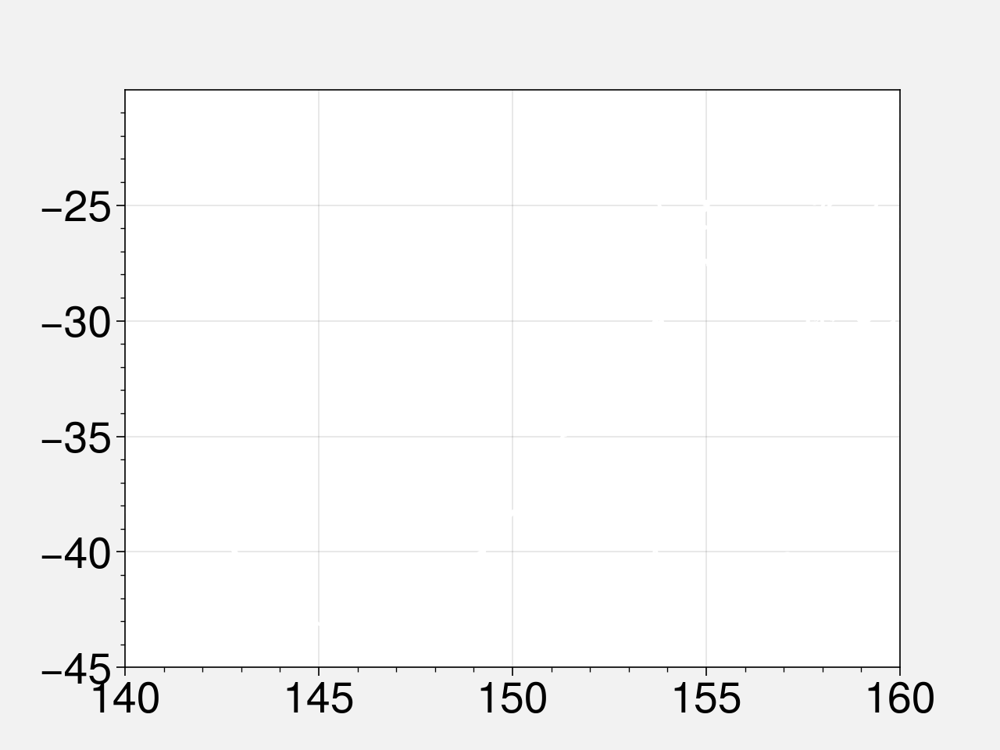

In [36]:
bathymetric_contours_to_get = [-2000]
marine_heat_waves_GSLA_composite_on_bathy_contours  = []
marine_heat_waves_OISST_composite_on_bathy_contours  = []
marine_heat_waves_V_anom_composite_on_bathy_contours  = []
marine_heat_waves_JRA_sfc_temp_composite_on_bathy_contours  = []



marine_cold_spell_GSLA_composite_on_bathy_contours  = []
marine_cold_spell_OISST_composite_on_bathy_contours  = []
marine_cold_spell_V_anom_composite_on_bathy_contours  = []
marine_cold_spell_JRA_sfc_temp_composite_on_bathy_contours  = []




lat_lim_south = -35.0
lat_lim_north = -25.0
delta_lat = 0.25

for i_bathy_contour in range(0,len(bathymetric_contours_to_get)):

    print('Interpolating along the ', bathymetric_contours_to_get[i_bathy_contour], 'm isobath')
    cs = plt.contour(bathymetry_dataset['x'], bathymetry_dataset['y'], bathymetry_dataset['z'],[bathymetric_contours_to_get[i_bathy_contour]])

    max_length = 0
    for line in cs.collections[0].get_paths():
        n_points,_ = line.vertices.shape
        if n_points>max_length:
            bathymetric_contour_lat_lon = line.vertices
            max_length = n_points
        
    #lines.append(line.vertices)
    #plt.plot(bathymetric_contour_lat_lon[:,0],bathymetric_contour_lat_lon[:,1],'r*')
    

    idx_lat_lim_south = np.nonzero(bathymetric_contour_lat_lon[:,1]>lat_lim_south)[0][0]
    idx_lat_lim_north = np.nonzero(bathymetric_contour_lat_lon[:,1]>lat_lim_north)[0][0]

    regular_lat_points_on_bathy_contour = np.arange(lat_lim_south-delta_lat,lat_lim_north+delta_lat,delta_lat)
    regular_lon_points_on_bathy_contour = np.interp(regular_lat_points_on_bathy_contour, bathymetric_contour_lat_lon[idx_lat_lim_south:idx_lat_lim_north,1], bathymetric_contour_lat_lon[idx_lat_lim_south:idx_lat_lim_north,0])

    bathy_contour_lon = xarray.DataArray(regular_lon_points_on_bathy_contour, dims="z")
    bathy_contour_lat = xarray.DataArray(regular_lat_points_on_bathy_contour, dims="z")


    marine_heat_waves_GSLA_composite_on_bathy_contours.append(   marine_heat_waves_shifted_composite_GSLA.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
    marine_heat_waves_V_anom_composite_on_bathy_contours.append(   marine_heat_waves_shifted_composite_V_anom.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
    marine_heat_waves_OISST_composite_on_bathy_contours.append(  marine_heat_waves_shifted_composite_SST.interp(lon=bathy_contour_lon,lat=bathy_contour_lat).persist().squeeze())
    marine_heat_waves_JRA_sfc_temp_composite_on_bathy_contours.append(marine_heat_wave_shifted_composite_JRA_sfc_temp.interp(g0_lon_2=bathy_contour_lon,g0_lat_1=bathy_contour_lat).persist().squeeze())
    
    
    marine_cold_spell_GSLA_composite_on_bathy_contours.append(   marine_cold_spell_shifted_composite_GSLA.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
    marine_cold_spell_V_anom_composite_on_bathy_contours.append(   marine_cold_spell_shifted_composite_V_anom.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
    marine_cold_spell_OISST_composite_on_bathy_contours.append(  marine_cold_spell_shifted_composite_SST.interp(lon=bathy_contour_lon,lat=bathy_contour_lat).persist().squeeze())
    marine_cold_spell_JRA_sfc_temp_composite_on_bathy_contours.append(marine_cold_spell_shifted_composite_JRA_sfc_temp.interp(g0_lon_2=bathy_contour_lon,g0_lat_1=bathy_contour_lat).persist().squeeze())


Interpolating along the  -2000 m isobath


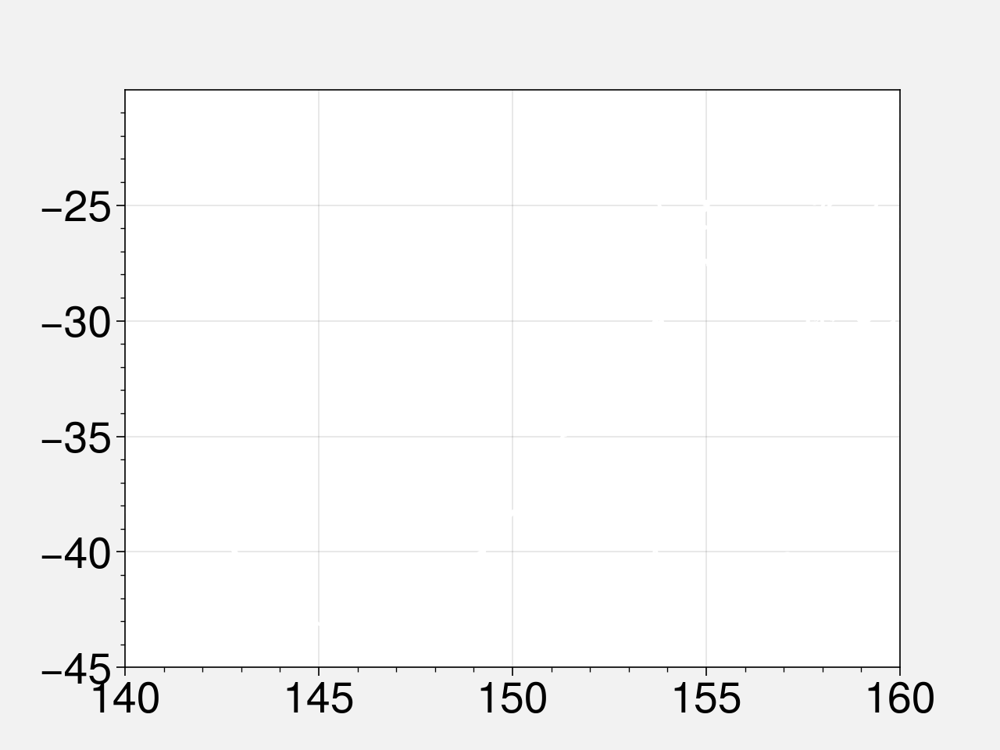

In [45]:
bathymetric_contours_to_get = [-2000]
marine_heat_waves_gsla_null_hypothesis  = []
marine_heat_waves_sst_null_hypothesis  = []
marine_heat_waves_sfc_temp_null_hypothesis  = []



marine_cold_spell_gsla_null_hypothesis  = []
marine_cold_spell_sst_null_hypothesis  = []
marine_cold_spell_sfc_temp_null_hypothesis = []


lat_lim_south = -35.0
lat_lim_north = -25.0
delta_lat = 0.25

for i_bathy_contour in range(0,len(bathymetric_contours_to_get)):

    print('Interpolating along the ', bathymetric_contours_to_get[i_bathy_contour], 'm isobath')
    cs = plt.contour(bathymetry_dataset['x'], bathymetry_dataset['y'], bathymetry_dataset['z'],[bathymetric_contours_to_get[i_bathy_contour]])

    max_length = 0
    for line in cs.collections[0].get_paths():
        n_points,_ = line.vertices.shape
        if n_points>max_length:
            bathymetric_contour_lat_lon = line.vertices
            max_length = n_points
        
    #lines.append(line.vertices)
    #plt.plot(bathymetric_contour_lat_lon[:,0],bathymetric_contour_lat_lon[:,1],'r*')
    

    idx_lat_lim_south = np.nonzero(bathymetric_contour_lat_lon[:,1]>lat_lim_south)[0][0]
    idx_lat_lim_north = np.nonzero(bathymetric_contour_lat_lon[:,1]>lat_lim_north)[0][0]

    regular_lat_points_on_bathy_contour = np.arange(lat_lim_south-delta_lat,lat_lim_north+delta_lat,delta_lat)
    regular_lon_points_on_bathy_contour = np.interp(regular_lat_points_on_bathy_contour, bathymetric_contour_lat_lon[idx_lat_lim_south:idx_lat_lim_north,1], bathymetric_contour_lat_lon[idx_lat_lim_south:idx_lat_lim_north,0])

    bathy_contour_lon = xarray.DataArray(regular_lon_points_on_bathy_contour, dims="z")
    bathy_contour_lat = xarray.DataArray(regular_lat_points_on_bathy_contour, dims="z")


    marine_heat_waves_gsla_null_hypothesis.append(   marine_heat_waves_composite_GSLA_null_hypothesis.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
    marine_heat_waves_sst_null_hypothesis.append(  marine_heat_waves_composite_SST_null_hypothesis.interp(lon=bathy_contour_lon,lat=bathy_contour_lat).persist().squeeze())
    marine_heat_waves_sfc_temp_null_hypothesis.append(  marine_heat_waves_composite_sfc_temp_null_hypothesis.interp(g0_lon_2=bathy_contour_lon,g0_lat_1=bathy_contour_lat).persist().squeeze())

    
    marine_cold_spell_gsla_null_hypothesis.append(   marine_cold_spell_composite_GSLA_null_hypothesis.interp(LONGITUDE=bathy_contour_lon,LATITUDE=bathy_contour_lat).persist().squeeze())
    marine_cold_spell_sst_null_hypothesis.append(  marine_heat_waves_composite_SST_null_hypothesis.interp(lon=bathy_contour_lon,lat=bathy_contour_lat).persist().squeeze())
    marine_cold_spell_sfc_temp_null_hypothesis.append(  marine_cold_spell_composite_sfc_temp_null_hypothesis.interp(g0_lon_2=bathy_contour_lon,g0_lat_1=bathy_contour_lat).persist().squeeze())


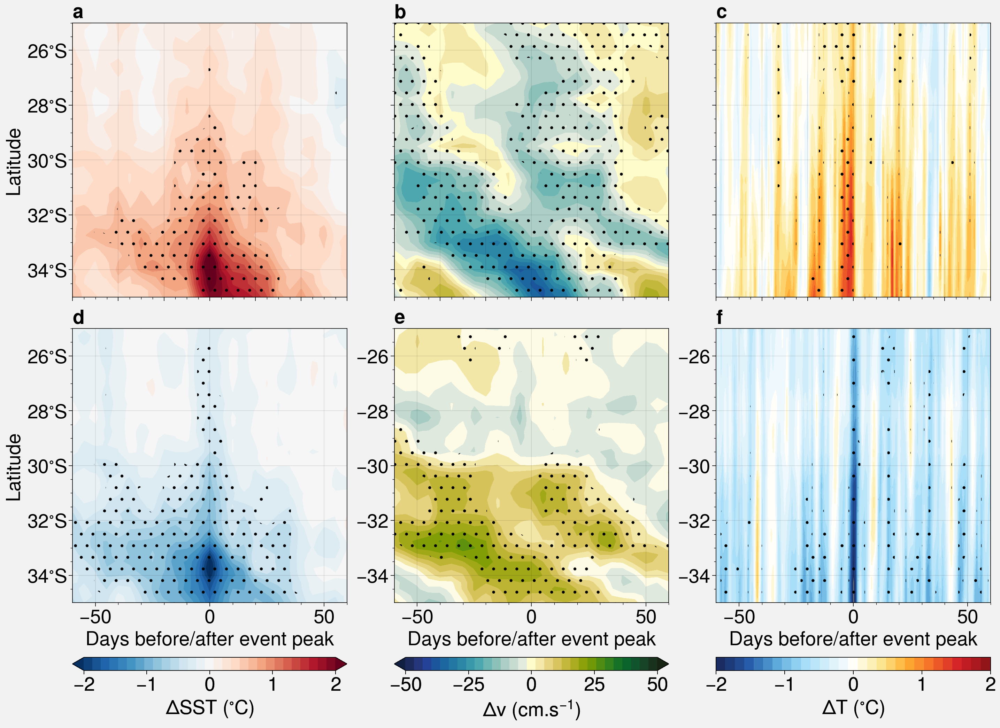

In [46]:

proplot.rc['land.color'] = 'grey'
proplot.rc['text.labelsize'] = 20
proplot.rc['text.titlesize'] = 25
proplot.rc['abc.size'] = 20
proplot.rc['abc.style'] = 'a'

proplot.rc.reso = 'hi'  # use higher res for zoomed in geographic features
proj = proplot.Proj('cyl', basemap=False)

time_scale_max = 60
time_scale_min = -60
lat_max = -25
lat_min = -35




n_quiver_points = 2
fig, axs = proplot.subplots(nrows=2,ncols=3, proj=None,axwidth='10cm',share=False) #,sharey=0)
axs.format(facecolor='grey',abc=True) #, color='grey')

SST_composite_to_plot = marine_heat_waves_OISST_composite_on_bathy_contours[0]['shifted_composite__sea_surface_temperature']

cs_SST = axs[0,0].contourf(marine_heat_waves_OISST_composite_on_bathy_contours[0]['time_shift'].values,marine_heat_waves_OISST_composite_on_bathy_contours[0]['lat'].values,
                  SST_composite_to_plot.values.T,levels=np.linspace(-2,2,30),cmap='RdBu_r',extend='both')


upper_quantile_sst = marine_heat_waves_sst_null_hypothesis[0]['random_composite__sea_surface_temperature'].sel(quantile=0.95,method='nearest')
lower_quantile_sst = marine_heat_waves_sst_null_hypothesis[0]['random_composite__sea_surface_temperature'].sel(quantile=0.05)

axs[0,0].contourf(marine_heat_waves_OISST_composite_on_bathy_contours[0]['time_shift'].values,marine_heat_waves_OISST_composite_on_bathy_contours[0]['lat'].values,
                            np.abs(SST_composite_to_plot>2.0*upper_quantile_sst).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')
axs[0,0].contourf(marine_heat_waves_OISST_composite_on_bathy_contours[0]['time_shift'].values,marine_heat_waves_OISST_composite_on_bathy_contours[0]['lat'].values,
                            np.abs(SST_composite_to_plot<lower_quantile_sst).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')
axs[0,0].format(xlim=(time_scale_min, time_scale_max), ylim=(lat_min,lat_max))
axs[0,0].set_xticks([-60,-40,-20,0,20,40,60])
axs[0,0].set_xticklabels([])

axs[0,0].set_yticks(np.arange(-34,-25,2))
y_ticks = []
for i_tick in range(-34,-25,2):
    y_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}S$' )
axs[0,0].set_yticklabels(y_ticks)
axs[0,0].set_ylabel('Latitude')


#Velocity
V_anom_composite_to_plot = marine_heat_waves_V_anom_composite_on_bathy_contours[0]['shifted_composite__VCUR']
GLSA_anom_composite_to_plot = marine_heat_waves_GSLA_composite_on_bathy_contours[0]['shifted_composite__GSLA']

cs_v_anom = axs[0,1].contourf(marine_heat_waves_V_anom_composite_on_bathy_contours[0]['time_shift'].values,marine_heat_waves_V_anom_composite_on_bathy_contours[0]['LATITUDE'].values,
                  100.0*V_anom_composite_to_plot.values.T,levels=np.linspace(-50,50,30),cmap='Delta',extend='both')


upper_quantile_gsla_anom = marine_heat_waves_gsla_null_hypothesis[0]['random_composite__GSLA'].sel(quantile=0.90,method='nearest')
lower_quantile_gsla_anom = marine_heat_waves_gsla_null_hypothesis[0]['random_composite__GSLA'].sel(quantile=0.10)

axs[0,1].contourf(marine_heat_waves_GSLA_composite_on_bathy_contours[0]['time_shift'].values,marine_heat_waves_GSLA_composite_on_bathy_contours[0]['LATITUDE'].values,
                            np.abs(GLSA_anom_composite_to_plot>upper_quantile_gsla_anom).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')
axs[0,1].contourf(marine_heat_waves_GSLA_composite_on_bathy_contours[0]['time_shift'].values,marine_heat_waves_GSLA_composite_on_bathy_contours[0]['LATITUDE'].values,
                            np.abs(GLSA_anom_composite_to_plot<lower_quantile_gsla_anom).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')
axs[0,1].format(xlim=(time_scale_min, time_scale_max), ylim=(lat_min,lat_max))
axs[0,1].set_xticks([-60,-40,-20,0,20,40,60])
axs[0,1].set_xticklabels([])
axs[0,1].set_yticks(np.arange(-34,-25,2))
axs[0,1].set_yticklabels([])


#Surface atmospheric temperature
surface_temperature_to_plot = marine_heat_waves_JRA_sfc_temp_composite_on_bathy_contours[0]['shifted_composite__TMP_GDS0_HTGL']
cs_temp = axs[0,2].contourf(marine_heat_waves_JRA_sfc_temp_composite_on_bathy_contours[0]['time_shift'].values,marine_heat_waves_JRA_sfc_temp_composite_on_bathy_contours[0]['g0_lat_1'].values,
                  surface_temperature_to_plot.values.T,levels=np.linspace(-2,2,30),cmap='ColdHot')

upper_quantile_sfc_temp_anom = marine_heat_waves_sfc_temp_null_hypothesis[0]['random_composite__TMP_GDS0_HTGL'].sel(quantile=0.95,method='nearest')
lower_quantile_sfc_temp_anom = marine_heat_waves_sfc_temp_null_hypothesis[0]['random_composite__TMP_GDS0_HTGL'].sel(quantile=0.05) 
                                                                     
                                                                     
axs[0,2].contourf(marine_heat_waves_JRA_sfc_temp_composite_on_bathy_contours[0]['time_shift'].values,marine_heat_waves_JRA_sfc_temp_composite_on_bathy_contours[0]['g0_lat_1'].values,
                            np.abs(surface_temperature_to_plot>2.0*upper_quantile_sfc_temp_anom).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')
axs[0,2].contourf(marine_heat_waves_JRA_sfc_temp_composite_on_bathy_contours[0]['time_shift'].values,marine_heat_waves_JRA_sfc_temp_composite_on_bathy_contours[0]['g0_lat_1'].values,
                            np.abs(surface_temperature_to_plot<2.0*lower_quantile_sfc_temp_anom).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')



axs[0,2].format(xlim=(time_scale_min, time_scale_max), ylim=(lat_min,lat_max))
axs[0,2].set_xticks([-60,-40,-20,0,20,40,60])
axs[0,2].set_xticklabels([])
axs[0,2].set_yticks(np.arange(-34,-25,2))
axs[0,2].set_yticklabels([])


#============================COLD SPELLS=================================#

SST_composite_to_plot = marine_cold_spell_OISST_composite_on_bathy_contours[0]['shifted_composite__sea_surface_temperature']

axs[1,0].contourf(marine_cold_spell_OISST_composite_on_bathy_contours[0]['time_shift'].values,marine_cold_spell_OISST_composite_on_bathy_contours[0]['lat'].values,
                  SST_composite_to_plot.values.T,levels=np.linspace(-2,2,30),cmap='RdBu_r',extend='both')


upper_quantile_sst = marine_cold_spell_sst_null_hypothesis[0]['random_composite__sea_surface_temperature'].sel(quantile=0.95,method='nearest')
lower_quantile_sst = marine_cold_spell_sst_null_hypothesis[0]['random_composite__sea_surface_temperature'].sel(quantile=0.05)
axs[1,0].contourf(marine_heat_waves_OISST_composite_on_bathy_contours[0]['time_shift'].values,marine_cold_spell_OISST_composite_on_bathy_contours[0]['lat'].values,
                            np.abs(SST_composite_to_plot>upper_quantile_sst).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')
axs[1,0].contourf(marine_heat_waves_OISST_composite_on_bathy_contours[0]['time_shift'].values,marine_cold_spell_OISST_composite_on_bathy_contours[0]['lat'].values,
                            np.abs(SST_composite_to_plot<lower_quantile_sst).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')

axs[1,0].format(xlim=(time_scale_min, time_scale_max), ylim=(lat_min,lat_max))
axs[1,0].set_xlabel('Days before/after event peak')
axs[1,0].set_yticks(np.arange(-34,-25,2))
y_ticks = []
for i_tick in range(-34,-25,2):
    y_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}S$' )
axs[1,0].set_yticklabels(y_ticks)
axs[1,0].set_ylabel('Latitude')

V_anom_composite_to_plot = marine_cold_spell_V_anom_composite_on_bathy_contours[0]['shifted_composite__VCUR']
GLSA_anom_composite_to_plot = marine_cold_spell_GSLA_composite_on_bathy_contours[0]['shifted_composite__GSLA']


axs[1,1].contourf(marine_cold_spell_V_anom_composite_on_bathy_contours[0]['time_shift'].values,marine_cold_spell_V_anom_composite_on_bathy_contours[0]['LATITUDE'].values,
                  100.0*V_anom_composite_to_plot.values.T,levels=np.linspace(-50,50,30),cmap='Delta')

upper_quantile_gsla_anom = marine_cold_spell_gsla_null_hypothesis[0]['random_composite__GSLA'].sel(quantile=0.95,method='nearest')
lower_quantile_gsla_anom = marine_cold_spell_gsla_null_hypothesis[0]['random_composite__GSLA'].sel(quantile=0.05)
axs[1,1].contourf(GLSA_anom_composite_to_plot['time_shift'].values,GLSA_anom_composite_to_plot['LATITUDE'].values,
                            np.abs(GLSA_anom_composite_to_plot>upper_quantile_gsla_anom).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')


axs[1,1].contourf(GLSA_anom_composite_to_plot['time_shift'].values,GLSA_anom_composite_to_plot['LATITUDE'].values,
                            np.abs(GLSA_anom_composite_to_plot<lower_quantile_gsla_anom).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')
axs[1,1].set_xlabel('Days before/after event peak')

axs[1,1].format(
    xlim=(time_scale_min, time_scale_max), ylim=(lat_min,lat_max))
axs[0,1].set_yticks(np.arange(-34,-25,2))
axs[0,1].set_yticklabels([])

surface_temperature_to_plot = marine_cold_spell_JRA_sfc_temp_composite_on_bathy_contours[0]['shifted_composite__TMP_GDS0_HTGL']
axs[1,2].contourf(marine_cold_spell_JRA_sfc_temp_composite_on_bathy_contours[0]['time_shift'].values,marine_cold_spell_JRA_sfc_temp_composite_on_bathy_contours[0]['g0_lat_1'].values,
                  surface_temperature_to_plot.values.T,levels=np.linspace(-2,2,30),cmap='ColdHot')

upper_quantile_sfc_temp_anom = marine_cold_spell_sfc_temp_null_hypothesis[0]['random_composite__TMP_GDS0_HTGL'].sel(quantile=0.95,method='nearest')
lower_quantile_sfc_temp_anom = marine_cold_spell_sfc_temp_null_hypothesis[0]['random_composite__TMP_GDS0_HTGL'].sel(quantile=0.05) 
axs[1,2].contourf(marine_cold_spell_JRA_sfc_temp_composite_on_bathy_contours[0]['time_shift'].values,marine_cold_spell_JRA_sfc_temp_composite_on_bathy_contours[0]['g0_lat_1'].values,
                            np.abs(surface_temperature_to_plot>upper_quantile_sfc_temp_anom).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')
axs[1,2].contourf(marine_cold_spell_JRA_sfc_temp_composite_on_bathy_contours[0]['time_shift'].values,marine_cold_spell_JRA_sfc_temp_composite_on_bathy_contours[0]['g0_lat_1'].values,
                            np.abs(surface_temperature_to_plot<lower_quantile_sfc_temp_anom).values.T,levels=[0.9,1.1],hatches=['.','//'],colors='none')

axs[1,2].format(xlim=(time_scale_min, time_scale_max), ylim=(lat_min,lat_max))
axs[1,2].set_xlabel('Days before/after event peak')
axs[0,2].set_yticks(np.arange(-34,-25,2))
axs[0,2].set_yticklabels([])


fig.colorbar(cs_SST,loc='b',cols=[1],label='$\Delta$SST ($^{\circ}$C)',ticks=[-2,-1,0,2,1])
fig.colorbar(cs_v_anom,loc='b',cols=[2], label='$\Delta$v (cm.s$^{-1}$)',ticks=[-50,-25,0,25,50])
fig.colorbar(cs_temp,loc='b',cols=[3], label='$\Delta$T ($^{\circ}$C)',ticks=[-2,-1,0,2,1])

figure_output_path = 'Figures_Update'
figure_file_name = 'Lat_time_shift_SST_v_current_sfc_temp_composites_' + LOCATION 
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=400,bbox='tight', transparent=True)
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight', transparent=True)

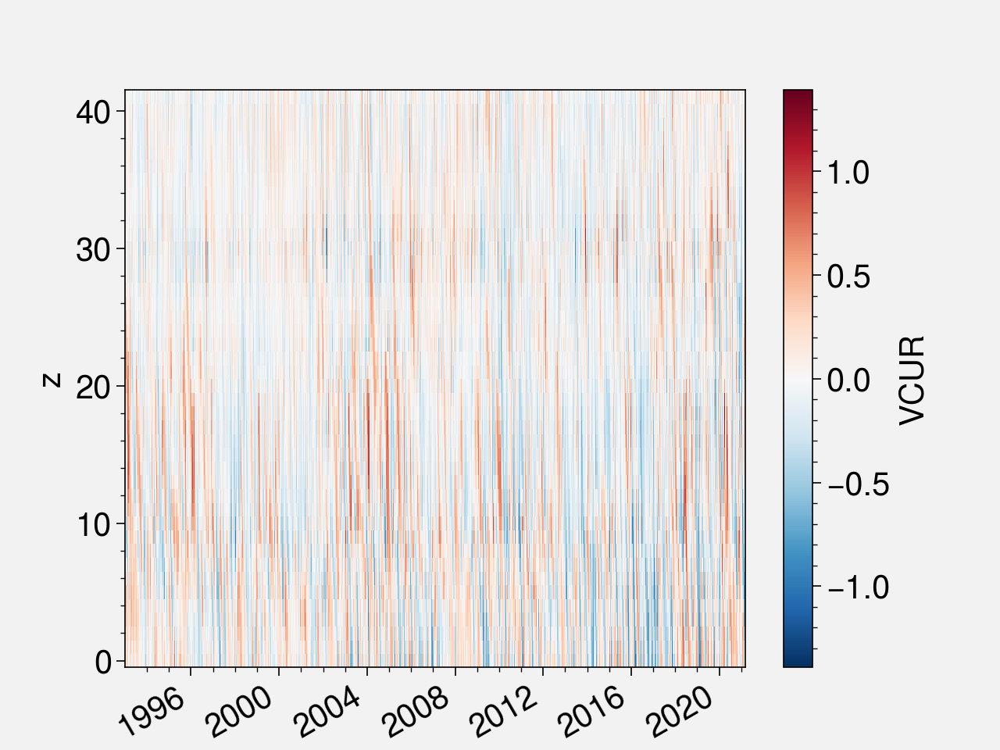

In [110]:
u_current_anom_bathy_contours[0]

,Array,Chunk
Bytes,1.73 MB,168 B
Shape,"(10290, 42)","(1, 42)"
Count,10290 Tasks,10290 Chunks
Type,float32,numpy.ndarray


In [134]:
from scipy import signal as scipy_signal


analytic_signal = scipy_signal.hilbert(v_current_anom_bathy_contours[0].fillna(0),axis=0) 
amplitude_envelope = np.abs(analytic_signal)



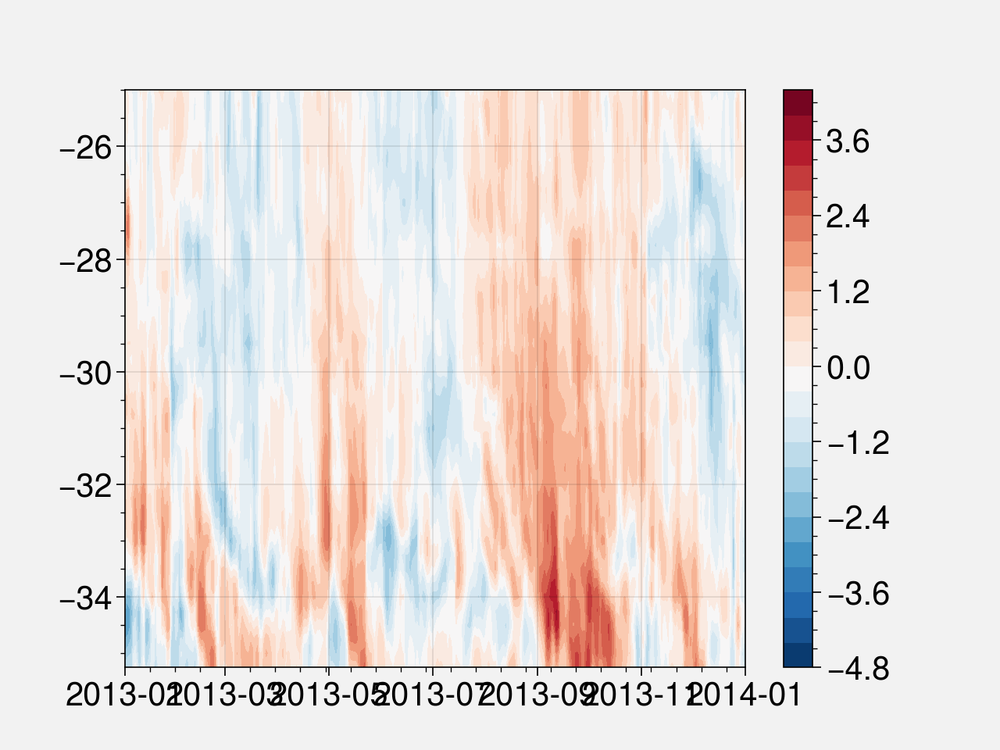

In [130]:
plt.contourf(pandas.to_datetime(SST_on_bathy_contours[0]['time'].values),SST_on_bathy_contours[0]['lat'],SST_anom_on_bathy_contours[0].T,levels=25,cmap=plt.cm.RdBu_r)
plt.xlim([pandas.Timestamp('2013-01-01'),pandas.Timestamp('2014-01-01')])
plt.colorbar()

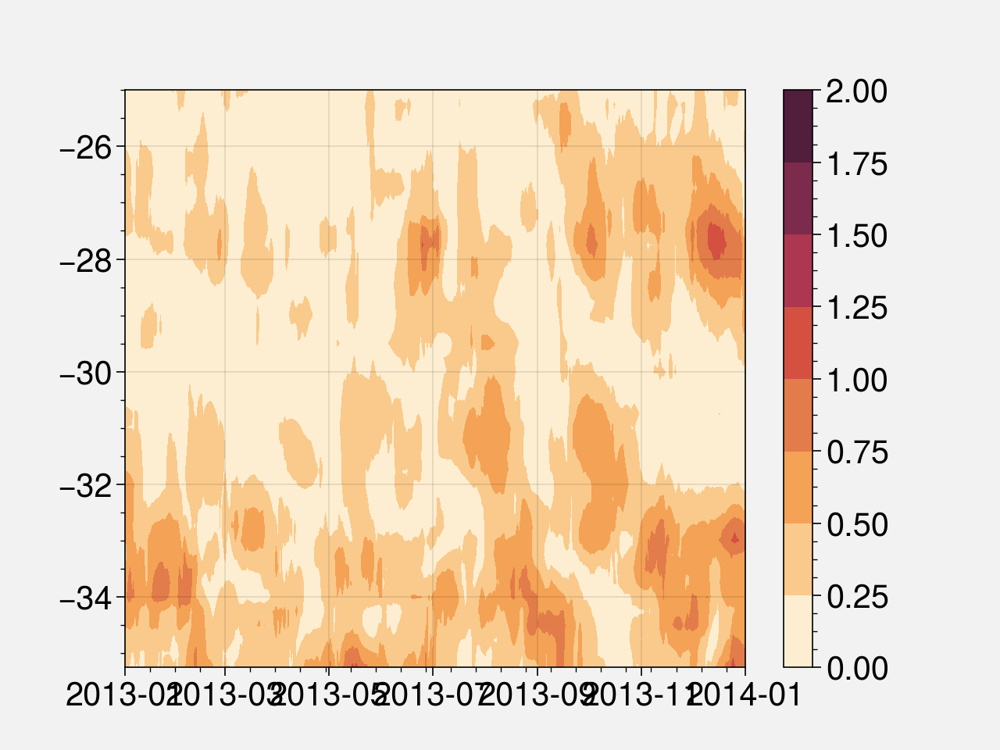

In [135]:
plt.contourf(pandas.to_datetime(u_current_anom_bathy_contours[0]['TIME'].values),u_current_anom_bathy_contours[0]['LATITUDE'],amplitude_envelope.T)
plt.xlim([pandas.Timestamp('2013-01-01'),pandas.Timestamp('2014-01-01')])
plt.colorbar()

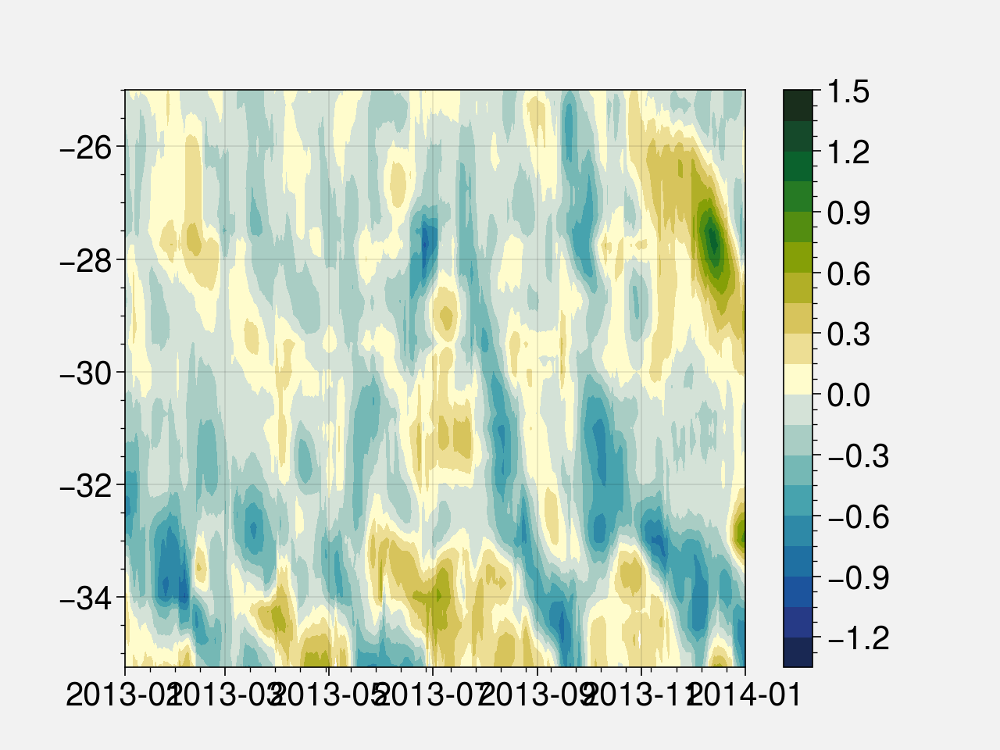

In [133]:
plt.contourf(pandas.to_datetime(u_current_anom_bathy_contours[0]['TIME'].values),u_current_anom_bathy_contours[0]['LATITUDE'],v_current_anom_bathy_contours[0].T,levels=25,cmap=cmocean.cm.delta)
plt.xlim([pandas.Timestamp('2013-01-01'),pandas.Timestamp('2014-01-01')])
plt.colorbar()

In [137]:
marine_heatwave_event_index = 15;

marine_heatwave_event = marine_heat_waves[marine_heatwave_event_index]




30

In [46]:
for i_event in range(0,marine_heat_waves['n_events']):
    print(i_event,marine_heat_waves['date_start'][i_event],marine_heat_waves['date_peak'][i_event],marine_heat_waves['date_end'][i_event])
    

0 1998-01-26 1998-02-02 1998-02-08
1 1998-08-21 1998-09-05 1998-09-13
2 1998-12-10 1998-12-19 1998-12-21
3 2001-07-30 2001-07-30 2001-08-12
4 2006-08-08 2006-08-17 2006-08-19
5 2010-04-18 2010-04-24 2010-05-12
6 2013-05-12 2013-05-15 2013-05-22
7 2013-08-31 2013-09-11 2013-09-13
8 2013-09-18 2013-10-02 2013-10-07
9 2014-04-05 2014-04-08 2014-04-29
10 2015-08-20 2015-08-27 2015-08-29
11 2015-10-19 2015-11-03 2015-11-13
12 2016-03-04 2016-03-11 2016-03-19
13 2016-05-19 2016-05-27 2016-06-21
14 2016-07-18 2016-07-26 2016-07-28
15 2016-09-14 2016-09-27 2016-10-19
16 2017-01-08 2017-01-11 2017-01-19
17 2017-07-21 2017-07-22 2017-07-30
18 2019-02-15 2019-02-21 2019-02-27
19 2019-04-18 2019-04-24 2019-04-28
20 2019-05-13 2019-05-20 2019-06-10
21 2021-12-17 2021-12-21 2021-12-31
22 2022-01-25 2022-02-02 2022-02-11
23 2022-04-15 2022-04-19 2022-05-26
24 2022-06-24 2022-06-28 2022-07-05


In [220]:
pandas.to_datetime(marine_heat_waves['date_end'][event_to_get])

Timestamp('2013-09-18 00:00:00')

/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/proplot/config.py:555: ProPlotWarning: rc setting 'share' was renamed to subplots.share in version 0.6.
/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/proplot/config.py:555: ProPlotWarning: rc setting 'share' was renamed to subplots.share in version 0.6.
/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/proplot/config.py:555: ProPlotWarning: rc setting 'share' was renamed to subplots.share in version 0.6.
/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/proplot/config.py:555: ProPlotWarning: rc setting 'share' was renamed to subplots.share in version 0.6.
/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/proplot/config.py:555: ProPlotWarning: rc setting 'share' was renamed to subplots.share in version 0.6.
/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/proplot/conf

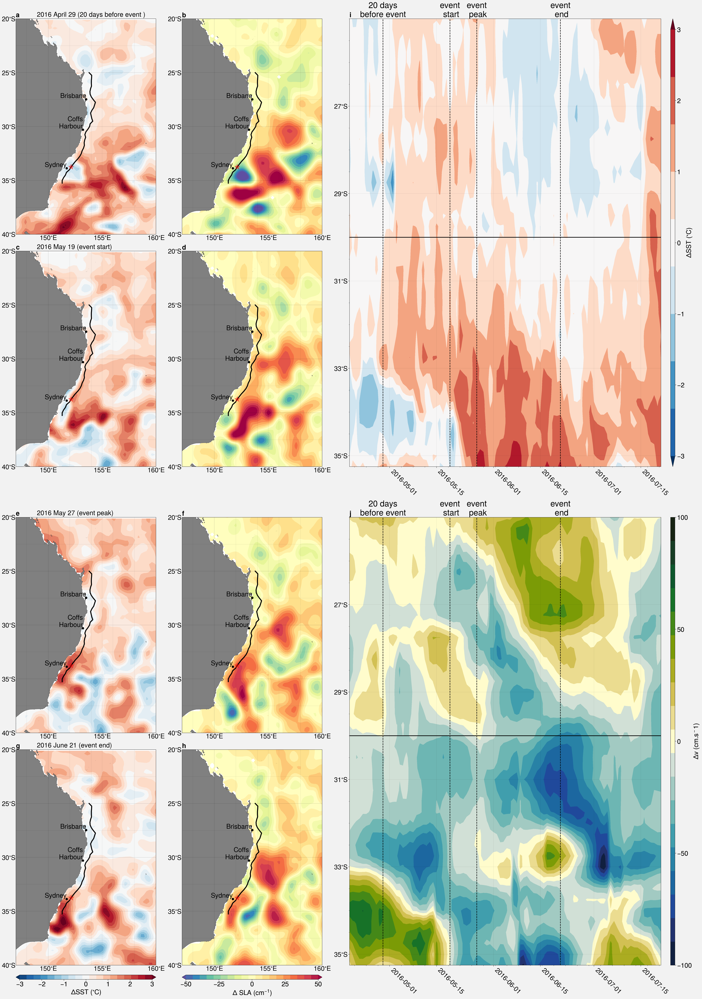

In [51]:
event_to_get = 13

time_slice  = pandas.date_range(pandas.to_datetime(marine_heat_waves['date_start'][event_to_get])-np.timedelta64(30,'D'),
                                pandas.to_datetime(marine_heat_waves['date_end'][event_to_get])+np.timedelta64(30,'D'),freq='1D')



sst_anomaly_for_event = SST_anom_dataset['sea_surface_temperature'].sel(time=time_slice)
sla_anomaly_for_event = GSLA_anom.sel(TIME=time_slice)
u_current_anomaly_for_event = u_current_anom.sel(TIME=time_slice)
v_current_anomaly_for_event = v_current_anom.sel(TIME=time_slice)




#SST_on_bathy_contours[0]

SST_on_bathy_for_event = SST_anom_on_bathy_contours[0].sel(time=time_slice)
v_on_bathy_for_event = v_current_anom_bathy_contours[0].sel(TIME=time_slice)

proplot.rc['land.color'] = 'grey'
proplot.rc['text.labelsize'] = 20
proplot.rc['text.titlesize'] = 25
proplot.rc['abc.size'] = 20
proplot.rc['abc.style'] = 'a'

proplot.rc.reso = 'hi'  # use higher res for zoomed in geographic features
proj = proplot.Proj('cyl', basemap=False)

time_scale_max = 60
time_scale_min = -60
lat_max = -20
lat_min = -40

lon_min = 147
lon_max = 160


lat_ticks = []
for i_tick in np.arange(-35,-24,2):
    lat_ticks.append(str(np.abs(i_tick)) + '$^{\circ}$S')


north_lim = -27.0
south_lim = -34
TARGET_LATITUDE = -27.5



image_layout = [[1,2,9,9],
                [3,4,9,9],
                [5,6,10,10],
                [7,8,10,10]]


times_to_plot = [time_slice[10],
                 pandas.to_datetime(marine_heat_waves['date_start'][event_to_get]),
                 pandas.to_datetime(marine_heat_waves['date_peak'][event_to_get]),
                 pandas.to_datetime(marine_heat_waves['date_end'][event_to_get])]

time_label = ['20 days before event ', 'event start', 'event peak', 'event end']


n_quiver_points = 2
fig, axs = proplot.subplots(image_layout, proj={1:proj,2:proj,3:proj,4:proj,5:proj,6:proj,7:proj,8:proj},axwidth='15cm',share=False) #,sharey=0)
axs.format(facecolor='grey',abc=True) #, color='grey')

axs.format(coast=True,facecolor='white',abc=True,share=False) #, color='grey')

city_font_size = 20

image_counter = 0
label_counter = 0
for i_time_to_plot in times_to_plot:

    cs_SST = axs[image_counter].contourf(SST_anom_dataset['lon'],SST_anom_dataset['lat'],
                            SST_anom_dataset['sea_surface_temperature'].sel(time=i_time_to_plot,method='nearest').squeeze(),
                levels=np.linspace(-3,3,20),extend='both',cmap='RdBu_r')

    axs[image_counter].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)
    axs[image_counter].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)

    transform = ccrs.PlateCarree()._as_mpl_transform(axs[image_counter])

    axs[image_counter].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[image_counter].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[image_counter].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[image_counter].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[image_counter].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[image_counter].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[ image_counter].set_xticks(np.arange(150,171,5))
    x_ticks = []
    for i_tick in np.arange(150,171,5):
        x_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}E$' )
    axs[image_counter].set_xticklabels(x_ticks)

    axs[image_counter].set_yticks(np.arange(lat_min,lat_max+1,5))
    y_ticks = []
    for i_tick in np.arange(lat_min,lat_max+1,5):
        y_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}S$' )
    
    axs[image_counter].set_yticklabels(y_ticks)
    axs[image_counter].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max),land=True)
    
    axs[image_counter].annotate(i_time_to_plot.strftime('%Y %B %d') + ' (' + time_label[label_counter] + ')' ,xy=(.15, 1.01), xycoords="axes fraction",fontsize=20)


    image_counter = image_counter+1

    cs_sla = axs[image_counter].contourf(GSLA_anom['LONGITUDE'],GSLA_anom['LATITUDE'],
                            100*GSLA_anom.sel(TIME=i_time_to_plot,method='nearest').squeeze(),
                levels=np.linspace(-50,50,20),extend='both',cmap='Spectral_r')

    axs[image_counter].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)
    axs[image_counter].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)

    transform = ccrs.PlateCarree()._as_mpl_transform(axs[image_counter])

    axs[image_counter].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[image_counter].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[image_counter].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[image_counter].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[image_counter].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[image_counter].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[image_counter].set_xticks(np.arange(150,171,5))
    x_ticks = []
    for i_tick in np.arange(150,171,5):
        x_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}E$' )
    axs[image_counter].set_xticklabels(x_ticks)

    axs[image_counter].set_yticks(np.arange(lat_min,lat_max+1,5))
    y_ticks = []
    for i_tick in np.arange(lat_min,lat_max+1,5):
        y_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}S$' )
    
    axs[image_counter].set_yticklabels(y_ticks)
    axs[image_counter].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max),land=True)

    image_counter = image_counter+1
    label_counter = label_counter + 1

    
fig.colorbar(cs_SST,loc='b',cols=[1],label='$\Delta$SST ($^{\circ}$C)',ticks=[-3,-2,-1,0,1,2,3])
fig.colorbar(cs_sla,loc='b',cols=[2], label='$\Delta$ SLA (cm$^{-1}$)',ticks=[-50,-25,0,25,50])



time_label = ['20 days\n before event ', 'event\n start', 'event\n peak', 'event\n end']


cs_SST = axs[image_counter].contourf(pandas.to_datetime(SST_on_bathy_for_event['time'].values),
                                     SST_on_bathy_for_event['lat'].values,
                                     SST_on_bathy_for_event.T,
                                     levels=np.linspace(-3,3,10),cmap=plt.cm.RdBu_r,extend='both',)
axs[image_counter].grid(True)
label_counter = 0
for i_time_to_plot in times_to_plot:
    axs[image_counter].plot([pandas.to_datetime(i_time_to_plot),pandas.to_datetime(i_time_to_plot)],[SST_on_bathy_for_event['lat'].min(),SST_on_bathy_for_event['lat'].max()],linestyle='--',color='black')
    axs[image_counter].annotate(time_label[label_counter],xy=(pandas.to_datetime(i_time_to_plot), -25.), xycoords="data",fontsize=25,ha='center',va='bottom')
    label_counter  = label_counter+1
axs[image_counter].plot([pandas.to_datetime(SST_on_bathy_for_event['time']).min(),pandas.to_datetime(SST_on_bathy_for_event['time']).max()],
                         [-30,-30],linestyle='-',color='black',linewidth=2.0)

axs[image_counter].set_yticks(np.arange(south_lim,north_lim,2))
axs[image_counter].set_yticks(np.arange(int(v_current_anom_bathy_contours[0]['LATITUDE'].min()),int(v_current_anom_bathy_contours[0]['LATITUDE'].max()),2))
axs[image_counter].set_yticklabels(lat_ticks)
axs[image_counter].format(xrotation=-45) 
axs[image_counter].colorbar(cs_SST,loc='r',label='$\Delta$SST ($^{\circ}$C)',ticks=[-3,-2,-1,0,1,2,3])

image_counter = image_counter+1

cs_v = axs[image_counter].contourf(pandas.to_datetime(v_on_bathy_for_event['TIME'].values),
                                     v_on_bathy_for_event['LATITUDE'].values,
                                     100*v_on_bathy_for_event.T,
                                     levels=np.linspace(-100,100,20),cmap='delta')
axs[image_counter].grid(True)

axs[image_counter].plot([pandas.to_datetime(SST_on_bathy_for_event['time']).min(),pandas.to_datetime(SST_on_bathy_for_event['time']).max()],
                         [-30,-30],linestyle='-',color='black',linewidth=2.0)


label_counter = 0
for i_time_to_plot in times_to_plot:
    axs[image_counter].plot([pandas.to_datetime(i_time_to_plot),pandas.to_datetime(i_time_to_plot)],[SST_on_bathy_for_event['lat'].min(),SST_on_bathy_for_event['lat'].max()],linestyle='--',color='black')
    axs[image_counter].annotate(time_label[label_counter],xy=(pandas.to_datetime(i_time_to_plot), -25.), xycoords="data",fontsize=25,ha='center',va='bottom')
    label_counter  = label_counter+1

axs[image_counter].set_yticks(np.arange(south_lim,north_lim,2))
axs[image_counter].format(xrotation=-45) 
axs[image_counter].set_yticks(np.arange(int(v_current_anom_bathy_contours[0]['LATITUDE'].min()),int(v_current_anom_bathy_contours[0]['LATITUDE'].max()),2))
axs[image_counter].set_yticklabels(lat_ticks)
axs[image_counter].colorbar(cs_v,loc='r',label='$\Delta$v (cm.s$^-1$)',ticks=[-100,-50,0,50,100])



figure_output_path = 'Figures_Update'
figure_file_name = 'case_study_Sydney_SST_SLA_map_hovmoller_' + LOCATION + '_' + times_to_plot[2].strftime('%Y_%B_%d')
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=100,bbox='tight', transparent=True)
#fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight', transparent=True)



/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/proplot/config.py:555: ProPlotWarning: rc setting 'share' was renamed to subplots.share in version 0.6.
/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/proplot/config.py:555: ProPlotWarning: rc setting 'share' was renamed to subplots.share in version 0.6.
/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/proplot/config.py:555: ProPlotWarning: rc setting 'share' was renamed to subplots.share in version 0.6.
/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/proplot/config.py:555: ProPlotWarning: rc setting 'share' was renamed to subplots.share in version 0.6.
/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/proplot/config.py:555: ProPlotWarning: rc setting 'share' was renamed to subplots.share in version 0.6.
/tube1/cha674/Anaconda_Install/miniconda/envs/py3/lib/python3.7/site-packages/proplot/conf

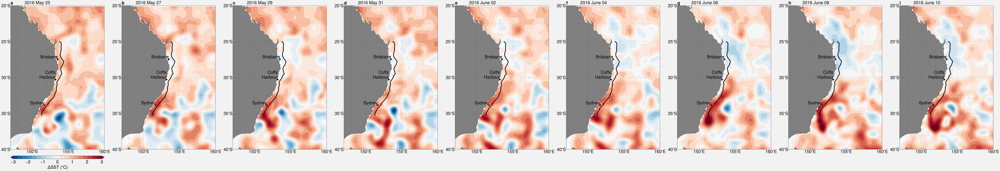

In [50]:
event_to_get = 16

time_slice  = pandas.date_range(pandas.to_datetime('2016-05-25'),
                                pandas.to_datetime('2016-06-10'),freq='2D')



sst_anomaly_for_event = SST_anom_dataset['sea_surface_temperature'].sel(time=time_slice)
sla_anomaly_for_event = GSLA_anom.sel(TIME=time_slice)
u_current_anomaly_for_event = u_current_anom.sel(TIME=time_slice)
v_current_anomaly_for_event = v_current_anom.sel(TIME=time_slice)




#SST_on_bathy_contours[0]

SST_on_bathy_for_event = SST_anom_on_bathy_contours[0].sel(time=time_slice)
v_on_bathy_for_event = v_current_anom_bathy_contours[0].sel(TIME=time_slice)

proplot.rc['land.color'] = 'grey'
proplot.rc['text.labelsize'] = 20
proplot.rc['text.titlesize'] = 25
proplot.rc['abc.size'] = 20
proplot.rc['abc.style'] = 'a'

proplot.rc.reso = 'hi'  # use higher res for zoomed in geographic features
proj = proplot.Proj('cyl', basemap=False)

time_scale_max = 60
time_scale_min = -60
lat_max = -20
lat_min = -40

lon_min = 147
lon_max = 160


lat_ticks = []
for i_tick in np.arange(-35,-24,2):
    lat_ticks.append(str(np.abs(i_tick)) + '$^{\circ}$S')


north_lim = -27.0
south_lim = -34
TARGET_LATITUDE = -27.5



image_layout = [[1],
                [2],
                [3],
                [4], ] 


times_to_plot = [time_slice[0],
                 time_slice[1],
                 time_slice[2],
                 time_slice[3],
                time_slice[4],
                time_slice[5],
                time_slice[6],
                time_slice[7],
                time_slice[8]]
#time_label = ['20 days before event ', 'event start', 'event peak', 'event end']


n_quiver_points = 2
fig, axs = proplot.subplots(nrows=1,ncols=len(times_to_plot), proj=proj,axwidth='15cm',share=False) #,sharey=0)
axs.format(facecolor='grey',abc=True) #, color='grey')

axs.format(coast=True,facecolor='white',abc=True,share=False) #, color='grey')

city_font_size = 20

image_counter = 0
label_counter = 0
for i_time_to_plot in times_to_plot:

    cs_SST = axs[image_counter].contourf(SST_anom_dataset['lon'],SST_anom_dataset['lat'],
                            SST_anom_dataset['sea_surface_temperature'].sel(time=i_time_to_plot,method='nearest').squeeze(),
                levels=np.linspace(-3,3,20),extend='both',cmap='RdBu_r')

    axs[image_counter].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)
    axs[image_counter].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)

    transform = ccrs.PlateCarree()._as_mpl_transform(axs[image_counter])

    axs[image_counter].plot(brisbane_lon,brisbane_lat,'o',color='k')
    axs[image_counter].plot(sydney_lon,sydney_lat,'o',color='k')
    axs[image_counter].plot(coffs_lon,coffs_lat,'o',color='k')
    
    axs[image_counter].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[image_counter].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    axs[image_counter].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
            ha='right', va='bottom',fontsize=city_font_size)
    
    axs[ image_counter].set_xticks(np.arange(150,171,5))
    x_ticks = []
    for i_tick in np.arange(150,171,5):
        x_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}E$' )
    axs[image_counter].set_xticklabels(x_ticks)

    axs[image_counter].set_yticks(np.arange(lat_min,lat_max+1,5))
    y_ticks = []
    for i_tick in np.arange(lat_min,lat_max+1,5):
        y_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}S$' )
    
    axs[image_counter].set_yticklabels(y_ticks)
    axs[image_counter].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max),land=True)
    
    axs[image_counter].annotate(i_time_to_plot.strftime('%Y %B %d') ,xy=(.15, 1.01), xycoords="axes fraction",fontsize=20)


 #   image_counter = image_counter+1
#
#    cs_sla = axs[image_counter].contourf(GSLA_anom['LONGITUDE'],GSLA_anom['LATITUDE'],
#                            100*GSLA_anom.sel(TIME=i_time_to_plot,method='nearest').squeeze(),
#                levels=np.linspace(-50,50,20),extend='both',cmap='Spectral_r')
#
#    axs[image_counter].plot(SST_anom_on_bathy_contours[0]['lon'],SST_anom_on_bathy_contours[0]['lat'],color='black',linewidth=3.0)
#    axs[image_counter].plot(lon_point,lat_point,'r*',markersize=17,transform=ccrs.PlateCarree(),alpha=0.5)
#
#    transform = ccrs.PlateCarree()._as_mpl_transform(axs[image_counter])
#
#    axs[image_counter].plot(brisbane_lon,brisbane_lat,'o',color='k')
#    axs[image_counter].plot(sydney_lon,sydney_lat,'o',color='k')
#    axs[image_counter].plot(coffs_lon,coffs_lat,'o',color='k')
#    
#    axs[image_counter].annotate('Brisbane', xy=(brisbane_lon,brisbane_lat), xycoords=transform,
#            ha='right', va='bottom',fontsize=city_font_size)
#    
#    axs[image_counter].annotate('Sydney', xy=(sydney_lon,sydney_lat), xycoords=transform,
#            ha='right', va='bottom',fontsize=city_font_size)
#    axs[image_counter].annotate('Coffs\n Harbour', xy=(coffs_lon,coffs_lat), xycoords=transform,
#            ha='right', va='bottom',fontsize=city_font_size)
#    
#    axs[image_counter].set_xticks(np.arange(150,171,5))
#    x_ticks = []
#    for i_tick in np.arange(150,171,5):
#        x_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}E$' )
#    axs[image_counter].set_xticklabels(x_ticks)
#
#    axs[image_counter].set_yticks(np.arange(lat_min,lat_max+1,5))
#    y_ticks = []
#    for i_tick in np.arange(lat_min,lat_max+1,5):
#        y_ticks.append(str(np.int(np.abs(i_tick))) + '$^{\circ}S$' )
#    
#    axs[image_counter].set_yticklabels(y_ticks)
#    axs[image_counter].format(lonlim=(lon_min, lon_max), latlim=(lat_min, lat_max),land=True)
#
    image_counter = image_counter+1
    label_counter = label_counter + 1

    
fig.colorbar(cs_SST,loc='b',cols=[1],label='$\Delta$SST ($^{\circ}$C)',ticks=[-3,-2,-1,0,1,2,3])
#fig.colorbar(cs_sla,loc='b',cols=[2], label='$\Delta$ SLA (cm$^{-1}$)',ticks=[-50,-25,0,25,50])



#time_label = ['20 days\n before event ', 'event\n start', 'event\n peak', 'event\n end']


#cs_SST = axs[image_counter].contourf(pandas.to_datetime(SST_on_bathy_for_event['time'].values),
#                                     SST_on_bathy_for_event['lat'].values,
#                                     SST_on_bathy_for_event.T,
#                                     levels=np.linspace(-3,3,10),cmap=plt.cm.RdBu_r,extend='both',)
#axs[image_counter].grid(True)
#label_counter = 0
#for i_time_to_plot in times_to_plot:
#    axs[image_counter].plot([pandas.to_datetime(i_time_to_plot),pandas.to_datetime(i_time_to_plot)],[SST_on_bathy_for_event['lat'].min(),SST_on_bathy_for_event['lat'].max()],linestyle='--',color='black')
#    axs[image_counter].annotate(time_label[label_counter],xy=(pandas.to_datetime(i_time_to_plot), -25.), xycoords="data",fontsize=25,ha='center',va='bottom')
#    label_counter  = label_counter+1
#axs[image_counter].plot([pandas.to_datetime(SST_on_bathy_for_event['time']).min(),pandas.to_datetime(SST_on_bathy_for_event['time']).max()],
#                         [-30,-30],linestyle='-',color='black',linewidth=2.0)

#axs[image_counter].set_yticks(np.arange(south_lim,north_lim,2))
#axs[image_counter].set_yticks(np.arange(int(v_current_anom_bathy_contours[0]['LATITUDE'].min()),int(v_current_anom_bathy_contours[0]['LATITUDE'].max()),2))
#axs[image_counter].set_yticklabels(lat_ticks)
#axs[image_counter].format(xrotation=-45) 
#axs[image_counter].colorbar(cs_SST,loc='r',label='$\Delta$SST ($^{\circ}$C)',ticks=[-3,-2,-1,0,1,2,3])

#image_counter = image_counter+1
#
#cs_v = axs[image_counter].contourf(pandas.to_datetime(v_on_bathy_for_event['TIME'].values),
#                                     v_on_bathy_for_event['LATITUDE'].values,
#                                     100*v_on_bathy_for_event.T,
#                                     levels=np.linspace(-100,100,20),cmap='delta')
#axs[image_counter].grid(True)
#
#axs[image_counter].plot([pandas.to_datetime(SST_on_bathy_for_event['time']).min(),pandas.to_datetime(SST_on_bathy_for_event['time']).max()],
#                         [-30,-30],linestyle='-',color='black',linewidth=2.0)


#label_counter = 0
#for i_time_to_plot in times_to_plot:
#    axs[image_counter].plot([pandas.to_datetime(i_time_to_plot),pandas.to_datetime(i_time_to_plot)],[SST_on_bathy_for_event['lat'].min(),SST_on_bathy_for_event['lat'].max()],linestyle='--',color='black')
#    axs[image_counter].annotate(time_label[label_counter],xy=(pandas.to_datetime(i_time_to_plot), -25.), xycoords="data",fontsize=25,ha='center',va='bottom')
#    label_counter  = label_counter+1

#axs[image_counter].set_yticks(np.arange(south_lim,north_lim,2))
#axs[image_counter].format(xrotation=-45) 
#axs[image_counter].set_yticks(np.arange(int(v_current_anom_bathy_contours[0]['LATITUDE'].min()),int(v_current_anom_bathy_contours[0]['LATITUDE'].max()),2))
#axs[image_counter].set_yticklabels(lat_ticks)
#axs[image_counter].colorbar(cs_v,loc='r',label='$\Delta$v (cm.s$^-1$)',ticks=[-100,-50,0,50,100])



figure_output_path = 'Figures_Update'
figure_file_name = '2016_SSTs_progression'
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.png'),dpi=100,bbox='tight', transparent=True)
fig.savefig(os.path.join(figure_output_path,figure_file_name + '.pdf'),dpi=200,bbox='tight', transparent=True)



In [29]:
time_slice  = pandas.date_range(pandas.to_datetime('2016-06-01'),
                                pandas.to_datetime('2016-06-10'),freq='1D')

In [31]:
time_slice  = pandas.date_range(pandas.to_datetime('2016-06-01'),
                                pandas.to_datetime('2016-06-10'),freq='1D')

In [34]:
time_slice

DatetimeIndex(['2016-06-01', '2016-06-02', '2016-06-03', '2016-06-04',
               '2016-06-05', '2016-06-06', '2016-06-07', '2016-06-08',
               '2016-06-09', '2016-06-10'],
              dtype='datetime64[ns]', freq='D')